In [1]:
%matplotlib inline

import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import scipy.sparse as sparse
from scipy.stats import pearsonr

from scipy.cluster.hierarchy import linkage
import scipy.spatial.distance as ssd

import seaborn as sns
import sys
from scipy.sparse import hstack, csr_matrix
from sklearn.feature_selection import mutual_info_classif
import os
from cnmf import cNMF, save_df_to_npz, load_df_from_npz
import harmonypy


from matplotlib.patches import Patch
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize
from matplotlib.patches import Rectangle
from matplotlib.pyplot import rc_context

def save_df_to_text(obj, filename):
    obj.to_csv(filename, sep='\t')


import matplotlib.backends.backend_pdf

sys.path.append('../../Code/')
from utils import read_dataset_log
from matplotlib import rcParams, font_manager
import matplotlib

from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

# rcParams['pdf.fonttype'] = 42
# rcParams['ps.fonttype'] = 42
# rcParams['font.family'] = 'sans-serif'
# rcParams['font.sans-serif'] = ['Arial']

In [2]:
from scipy.stats import spearmanr

In [3]:
params = read_dataset_log('Dataset Paths')
params.index = params['dataset']
params = params[params['dataset_type']=='discovery']
params

,dataset,usage_fn,gene_scores_fn,gene_tpm_fn,tcat_fn,tcat_fn_withsingletons,scores_fn,manual_gating_fn,manual_activation_gating_fn,activation_score_fn,...,k,dt,processed_forcnmf_fn,tpm_counts_for_cnmf_fn,raw_counts_filt_fn,raw_counts_fn,dataset_type,tissue_type,context_label,tcat_fn_old
dataset,,,,,,,,,,,,,,,,,,,,,
AMP-RA,AMP-RA,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMPRA....,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMPRA....,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMPRA....,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,NaN,/data/srlab1/TCAT/Data/PerDataset/AMPRA/Manual...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/Activa...,...,34.0,0_15,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,discovery,Synovium,RA+OA,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...
Pan-Cancer,Pan-Cancer,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Pa...,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Pa...,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Pa...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,NaN,NaN,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Ac...,...,38.0,0.15,/data/srlab1/TCAT/Data/PerDataset/Pancancer/pa...,NaN,/data/srlab1/TCAT/Data/PerDataset/Pancancer/pa...,/data/srlab1/TCAT/Data/PerDataset/Pancancer/pa...,discovery,Pan-Tissue,Cancer+Healthy,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...
TBRU,TBRU,/data/srlab1/TCAT/Data/PerDataset/TBRU/TBRU.20...,/data/srlab1/TCAT/Data/PerDataset/TBRU/TBRU.20...,/data/srlab1/TCAT/Data/PerDataset/TBRU/TBRU.20...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,NaN,/data/srlab1/TCAT/Data/PerDataset/TBRU/ManualG...,/data/srlab1/TCAT/Data/PerDataset/TBRU/Activat...,...,36.0,0_20,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,discovery,Blood,Healthy,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...
HIV-Vaccine,HIV-Vaccine,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/HIVV...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/HIVV...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/HIVV...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/Manu...,NaN,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/Acti...,...,31.0,0_15,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,discovery,Blood,Post-Vaccine+Healthy,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...
UK-Covid,UK-Covid,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/UKCO...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/UKCO...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/UKCO...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/Manu...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/Manu...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/Acti...,...,44.0,0_20,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/hani...,NaN,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/hani...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/hani...,discovery,Blood,Covid-19+Healthy,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...
COMBAT,COMBAT,/data/srlab1/TCAT/Data/PerDataset/COMBAT/COMBA...,/data/srlab1/TCAT/Data/PerDataset/COMBAT/COMBA...,/data/srlab1/TCAT/Data/PerDataset/COMBAT/COMBA...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,/data/srlab1/TCAT/Data/PerDataset/COMBAT/Manua...,/data/srlab1/TCAT/Data/PerDataset/COMBAT/Manua...,/data/srlab1/TCAT/Data/PerDataset/COMBAT/Activ...,...,

In [4]:
tcat_dir = '../../Data/TCAT/'
toadd = '.20231016'

# Z-spec HVG Union genes

In [6]:
cluster_method = 'Zspec.HVGunion'

clus_fn = tcat_dir + 'cluster_groups.pairwiseCorr.%s%s.txt' % (cluster_method, toadd)
print(clus_fn)

R = pd.read_csv(os.path.join(tcat_dir, 'R.%s%s.tsv' % (cluster_method, toadd)), 
                index_col = 0, sep = '\t')
clus_df = pd.read_csv(clus_fn, index_col = 0, sep = '\t')

../../Data/TCAT/cluster_groups.pairwiseCorr.Zspec.HVGunion.20231016.txt


In [7]:
name = 'Scores'
method = 'Mean'
gene_types = ['Intersection', 'Union']

In [8]:
# Load merged spectra
spectra_merged = {}
for gene_type in gene_types:
    
    if name not in spectra_merged:
        spectra_merged[name] = {}
    if gene_type not in spectra_merged[name]:
        spectra_merged[name][gene_type] = {}
    spectra_fn =  os.path.join(tcat_dir, 'merged_spectra.Gene_%s.Gene_%s.%s.%s%s.tsv' % (name, gene_type, 
                                                                                        cluster_method, method,
                                                                                   toadd))
    spectra = pd.read_csv(spectra_fn, index_col = 0, sep = '\t')
    spectra_merged[name][gene_type][method] = spectra

In [9]:
n_top_genes = 40
gene_scores = {}
for dataset in params.index:
    gene_scores[dataset] = {}
    gene_scores[dataset]['Z_orig'] = pd.read_csv(params.loc[dataset, 'gene_scores_fn'], index_col = 0, sep = '\t')
    gene_scores[dataset]['Z_orig'].columns = dataset + ':' + gene_scores[dataset]['Z_orig'].columns
    
    # Relabel columns with cGEP labels
    gene_scores[dataset]['Z_relabel'] = gene_scores[dataset]['Z_orig'].copy()
    gene_scores[dataset]['Z_relabel'].columns = [(clus_df[dataset][clus_df[dataset]==gep].index)[0] 
                                                 for gep in gene_scores[dataset]['Z_relabel'].columns]
    
    # Get top genes
    spectra_scores = gene_scores[dataset]['Z_relabel']
    top_genes = []
    for gep in spectra_scores.columns:
        top_genes.append(list(spectra_scores.sort_values(by=gep, ascending=False).index[:n_top_genes]))

    top_genes = pd.DataFrame(top_genes, index=spectra_scores.columns).T
    gene_scores[dataset]['top_genes'] = top_genes
    
    print(dataset)

AMP-RA
Pan-Cancer
TBRU
HIV-Vaccine
UK-Covid
COMBAT
Pan-Tissue


## Consolidate results

In [11]:
corr_thresh = 0.5
low_corr_thresh = 0.4

In [12]:
corr_thresholds = [0.3, 0.4, 0.5]

In [13]:
cgep_ouputs = {}

In [14]:
cgep_ouputs['top_genes'] = {}
for cgep in clus_df.index:
    print(cgep) 
    sub_geps = clus_df.loc[cgep, :].dropna()

    top_genes = pd.DataFrame()
    
    # Get top genes for each dataset
    for dataset in sub_geps.index:
        print(dataset)
        top_genes = pd.concat([top_genes, pd.Series(gene_scores[dataset]['top_genes'][cgep], name = dataset)], axis = 1)
        
    # Get top genes from merged spectra
    for gene_type in gene_types:
        top_genes_merged = pd.Series(spectra_merged[name][gene_type][method].loc[cgep, :].sort_values(ascending = False).head(n_top_genes).index,
                 name = '_'.join([method, name, gene_type]))

        top_genes = pd.concat([top_genes, top_genes_merged], axis = 1)
        
    cgep_ouputs['top_genes'][cgep] = top_genes

CellCycle-G2M
Pan-Cancer
TBRU
UK-Covid
Pan-Tissue
COMBAT
AMP-RA
HIV-Vaccine
Doublet-RBC
Pan-Cancer
TBRU
UK-Covid
Pan-Tissue
COMBAT
AMP-RA
HIV-Vaccine
ISG
Pan-Cancer
TBRU
UK-Covid
Pan-Tissue
COMBAT
AMP-RA
HIV-Vaccine
gdT-Blood
TBRU
UK-Covid
COMBAT
HIV-Vaccine
HLA
Pan-Cancer
TBRU
UK-Covid
Pan-Tissue
COMBAT
AMP-RA
CellCycle-S
Pan-Cancer
TBRU
UK-Covid
Pan-Tissue
COMBAT
AMP-RA
HIV-Vaccine
CellCycle-Histone
Pan-Cancer
TBRU
Pan-Tissue
COMBAT
AMP-RA
HIV-Vaccine
Doublet-Platelet
TBRU
UK-Covid
Pan-Tissue
COMBAT
HIV-Vaccine
Mito
UK-Covid
Pan-Tissue
COMBAT
HIV-Vaccine
Cytotoxic
Pan-Cancer
TBRU
UK-Covid
Pan-Tissue
COMBAT
AMP-RA
HIV-Vaccine
Translation
TBRU
UK-Covid
AMP-RA
HIV-Vaccine
Treg
Pan-Cancer
TBRU
UK-Covid
Pan-Tissue
COMBAT
AMP-RA
HIV-Vaccine
S100A10/LMNA
TBRU
UK-Covid
Pan-Tissue
COMBAT
HeatShock1
Pan-Cancer
Pan-Tissue
AMP-RA
High-Cytokine
Pan-Cancer
UK-Covid
Pan-Tissue
AMP-RA
CD8_EM
Pan-Cancer
TBRU
UK-Covid
Pan-Tissue
COMBAT
AMP-RA
HIV-Vaccine
COMBAT_Cytoskeleton
Pan-Cancer
TBRU
UK-Covid
Pa

In [15]:
cgep_ouputs['alt_sub_geps'] = {}

for cgep in clus_df.index:
    print(cgep) 
    sub_geps = clus_df.loc[cgep, :].dropna()

    cgep_ouputs['alt_sub_geps'][cgep] = {}

    # Get which other GEPs are highly correlated with sub_geps in this cGEP
    for corr_thresh in corr_thresholds:
        cgep_ouputs['alt_sub_geps'][cgep]['corr_%s' % (str(corr_thresh))] = list(set(
            R.index[np.sum(R[sub_geps] > corr_thresh, axis = 1) > 0]).difference(sub_geps))

CellCycle-G2M
Doublet-RBC
ISG
gdT-Blood
HLA
CellCycle-S
CellCycle-Histone
Doublet-Platelet
Mito
Cytotoxic
Translation
Treg
S100A10/LMNA
HeatShock1
High-Cytokine
CD8_EM
COMBAT_Cytoskeleton
MAIT
gdT
HeatShock2
IEG-Blood_IEG-Tissue
Metallothionein
Doublet-Myeloid
IEG
BCL2/CDK6
Th17
CD4 TCM_ICOS/ACTG1
MALAT1
CD4-Naive
RGCC/MYADM_S100A10/LMNA
TIMD4/CD38
MALAT1_TBRU
CCR3+-Th2
CD8-Naive
Doublet-Plasma
Doublet-Bcell
IL10/CD38
IL26/CTSH
CD4 TEM
CD4-Naive_TBRU
Th2
SOX4/MME
CD8/KLRC2
CTLA4+CD38+
YPEL5/CREM
AMP-RA_Pan-Cancer
AMP-RA_Tfh
IEG_RGCC/MYADM
EBI3-Activation
Tfh
AMP-RA:Th17_Single
AMP-RA:Tph_Single
AMP-RA:AMP-RA:Doublet_Plasma_Single_Single
AMP-RA:AMP-RA:Hypoxia_Single_Single
AMP-RA:AMP-RA:Doublet_Mast_Single_Single
Pan-Cancer:Pan-Cancer:CD4/CD20_Single_Single
Pan-Cancer:Exhaustion_Single
Pan-Cancer:IEG_Single
Pan-Cancer:Translation_Single
Pan-Cancer:CTSH/Furin_Single
Pan-Cancer:Pan-Cancer:Doublet_epithelial_Single_Single
Pan-Cancer:Pan-Tissue:?PlasmaDoublet/WFDC2/SCGB3A1_Single_Single
Pan

## Output PDF

In [16]:
cgep = 'CellCycle-G2M'
sub_geps = clus_df.loc[cgep, :].dropna()


In [17]:
nrow = 4
ncol = 2
figsize = (15, 25)
ticklabelsize = 7
tablefontsize = 6
n_top_genes_display = 30
corr_thresh = 0.5


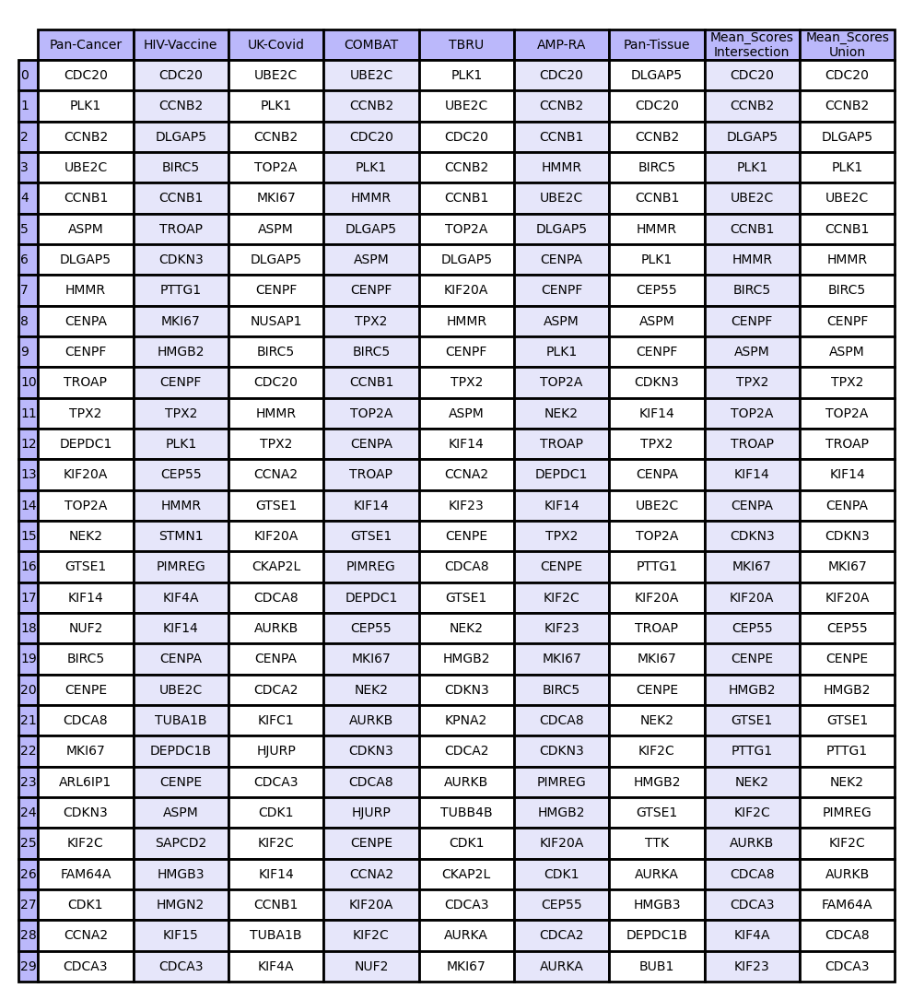

In [18]:
n_top_genes_display = 30

a = []
for i in range(cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).values.shape[1]):
    if i%2==0:
        c = 'white'
    else:
        c = 'lavender'
    a.append([c]* cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).values.shape[0])
a = np.array(a).T

fig, ax = plt.subplots(dpi = 200, #figsize = (10, 10)
                      )
ax.set_axis_off() 
table = ax.table( 
    cellText = cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).values,  
    cellColours = a, 
    rowLabels = cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).index,
    colLabels = ['Pan-Cancer', 'HIV-Vaccine', 'UK-Covid', 'COMBAT', 'TBRU', 'AMP-RA',
       'Pan-Tissue', 'Mean_Scores\nIntersection', 'Mean_Scores\nUnion'],
    #cgep_ouputs['top_genes'][cgep].columns,
    rowColours =["#Bbb8fb"] * len(cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).index),  
    colColours =["#Bbb8fb"] * len(cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).columns), 
    cellLoc ='center',  
    loc ='upper left')    
table.auto_set_font_size(False)
table.set_fontsize(5)

plt.show()

Text(0.5, 1.07, 'Spectra Score Correlations')

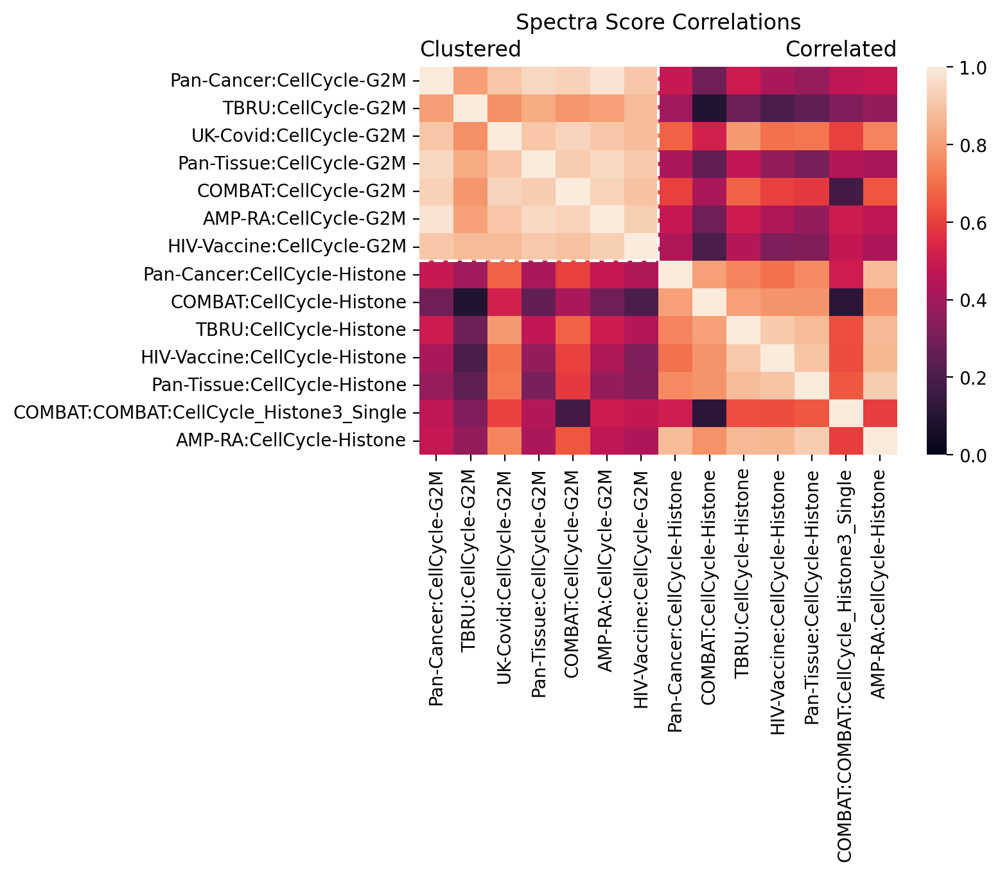

In [19]:
fig, ax = plt.subplots(dpi = 200)
sns.heatmap(R.loc[list(sub_geps) + cgep_ouputs['alt_sub_geps'][cgep]['corr_%s' % (str(corr_thresh))], 
                  list(sub_geps) + cgep_ouputs['alt_sub_geps'][cgep]['corr_%s' % (str(corr_thresh))]],
            vmin = 0, vmax = 1, #cmap = 'vlag',
           ax = ax)
ax.hlines(y = len(sub_geps), xmin = 0, xmax = len(sub_geps), color = 'white', linestyles = '--')
ax.vlines(x = len(sub_geps), ymin = 0, ymax = len(sub_geps), color = 'white', linestyles = '--')
ax.set_title('Clustered', loc = 'left')

if len(cgep_ouputs['alt_sub_geps'][cgep]['corr_%s' % (str(corr_thresh))]) > 0:
    ax.set_title('Correlated', loc = 'right')
ax.set_title('Clustered', loc = 'left')
ax.set_title('Spectra Score Correlations', y = 1.07)

Pan-Cancer:CellCycle-Histone
COMBAT:CellCycle-Histone
TBRU:CellCycle-Histone
HIV-Vaccine:CellCycle-Histone
Pan-Tissue:CellCycle-Histone
COMBAT:COMBAT:CellCycle_Histone3_Single
AMP-RA:CellCycle-Histone


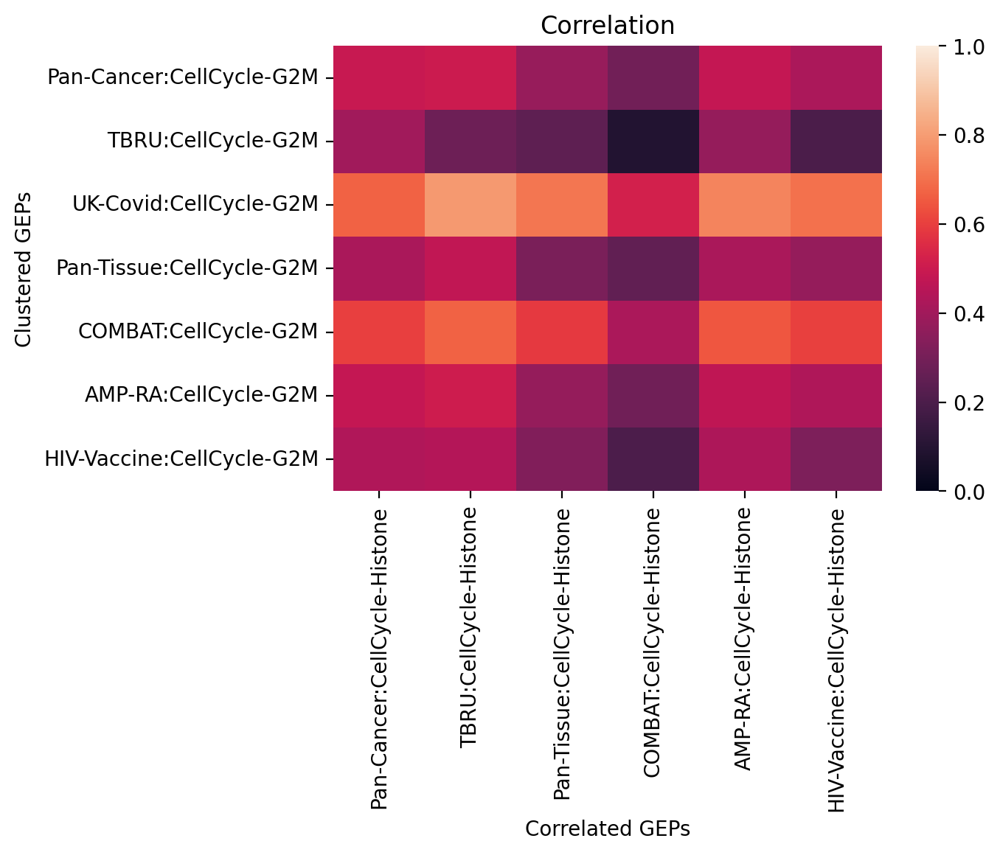

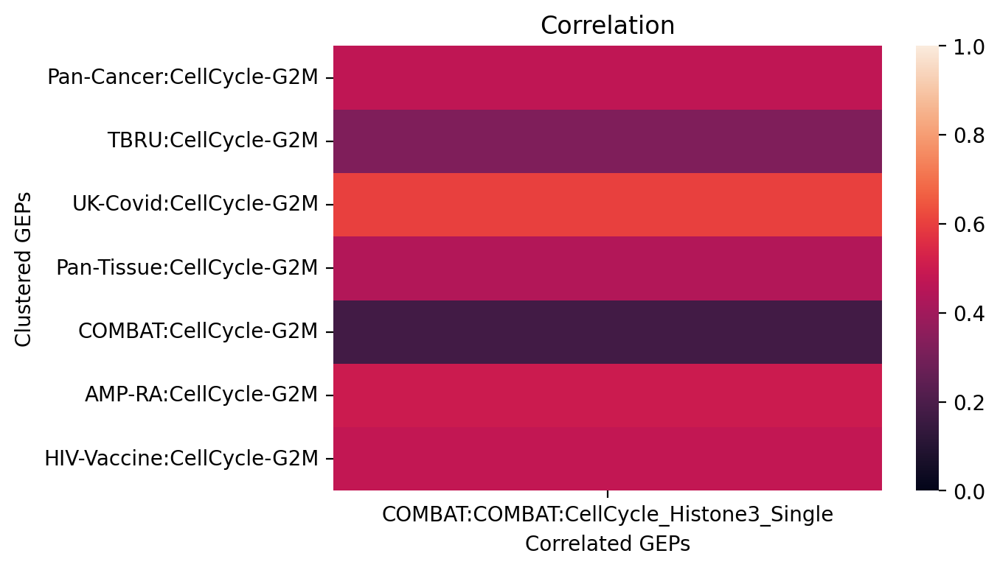

In [20]:
# Output which clusters correlated sub_geps were added to, and the sub_gep correlations to those clusters
gep_list = []
for alt_sub_gep in cgep_ouputs['alt_sub_geps'][cgep]['corr_%s' % (str(corr_thresh))]:
    if alt_sub_gep not in gep_list: 
        alt_cgep = clus_df[np.sum(clus_df==alt_sub_gep, axis = 1) > 0].index[0]

        gep_list += clus_df.loc[alt_cgep, :].dropna().tolist()
        fig, ax = plt.subplots(dpi = 200)
        sns.heatmap(R.loc[sub_geps, clus_df[np.sum(clus_df==alt_sub_gep, axis = 1) > 0].T.dropna().iloc[:, 0]],
                    ax = ax, vmin = 0, vmax = 1)
        ax.set_ylabel('Clustered GEPs')
        ax.set_xlabel('Correlated GEPs')
        ax.set_title('Correlation')
        
    print(alt_sub_gep)

In [ ]:
nrow = 4
ncol = 2
figsize = (15, 25)
ticklabelsize = 7
tablefontsize = 6
n_top_genes_display = 30
corr_thresh = 0.5

pdf = matplotlib.backends.backend_pdf.PdfPages(tcat_dir + 'cgep_correlations.%s%s.pdf' % (cluster_method, toadd))
for cgep in clus_df.index:
    # print(cgep) 
    sub_geps = clus_df.loc[cgep, :].dropna()

    fig, ax = plt.subplots(nrows = nrow, ncols = ncol, figsize = figsize, dpi = 200,
                           gridspec_kw={
                               # 'width_ratios': [3, 3],
                               'height_ratios':  [1.5, 1, 1, 1],
                           'wspace': 0.5,
                           'hspace': 1
                           }
                           )

    # Plot top genes
    n_top_genes_display = 30
    a = []
    for i in range(cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).values.shape[1]):
        if i%2==0:
            c = 'white'
        else:
            c = 'lavender'
        a.append([c]* cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).values.shape[0])
    a = np.array(a).T

    ax[0, 0].set_axis_off() 
    table = ax[0, 0].table( 
        cellText = cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).values,  
        cellColours = a, 
        rowLabels = cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).index,
        colLabels = cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).columns.str.replace(
            '_Union', '\nUnion').str.replace('_Intersection','\nIntersection'),
        #cgep_ouputs['top_genes'][cgep].columns,
        rowColours =["#Bbb8fb"] * len(cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).index),  
        colColours =["#Bbb8fb"] * len(cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).columns), 
        cellLoc ='center',  
        loc ='upper left')    
    table.auto_set_font_size(False)
    table.set_fontsize(tablefontsize)
    ax[0, 0].set_title(cgep)


    # Plot spectra correlations of sub_geps
    sns.heatmap(R.loc[list(sub_geps) + cgep_ouputs['alt_sub_geps'][cgep]['corr_%s' % (str(corr_thresh))], 
                      list(sub_geps) + cgep_ouputs['alt_sub_geps'][cgep]['corr_%s' % (str(corr_thresh))]],
                vmin = 0, vmax = 1, ax = ax[0, 1],
                annot = True, annot_kws= {'fontsize' :'x-small'})

    ax[0, 1].hlines(y = len(sub_geps), xmin = 0, xmax = len(sub_geps), color = 'white', linestyles = '--')
    ax[0, 1].vlines(x = len(sub_geps), ymin = 0, ymax = len(sub_geps), color = 'white', linestyles = '--')
    ax[0, 1].set_title('Clustered', loc = 'left')
    ax[0, 1].tick_params(axis = 'both', labelsize = ticklabelsize)

    if len(cgep_ouputs['alt_sub_geps'][cgep]['corr_%s' % (str(corr_thresh))]) > 0:
        ax[0, 1].set_title('Correlated', loc = 'right')
    ax[0, 1].set_title('Clustered', loc = 'left')
    ax[0, 1].set_title('Spectra Score Correlations', y = 1.07)


    # Output which clusters correlated sub_geps were added to, and the sub_gep correlations to those clusters
    n = 0
    gep_list = []
    for alt_sub_gep in cgep_ouputs['alt_sub_geps'][cgep]['corr_%s' % (str(corr_thresh))]:
        if alt_sub_gep not in gep_list: 
            i = n//ncol
            j = n%ncol

            alt_cgep = clus_df[np.sum(clus_df==alt_sub_gep, axis = 1) > 0].index[0]
            gep_list += clus_df.loc[alt_cgep, :].dropna().tolist()
            sns.heatmap(R.loc[sub_geps, clus_df[np.sum(clus_df==alt_sub_gep, axis = 1) > 0].T.dropna().iloc[:, 0]],
                        ax = ax[i+1, j], vmin = 0, vmax = 1,
                        annot = True, annot_kws= {'fontsize' :'small'})
            ax[i+1, j].tick_params(axis = 'both', labelsize = ticklabelsize + 2)
            ax[i+1, j].set_ylabel('Clustered GEPs')
            ax[i+1, j].set_xlabel('Other cluster GEPs')
            ax[i+1, j].set_title('Correlation with other cluster:\n'+ alt_cgep)
            n+=1

    # Hide extra plots
    while n<(ncol*nrow -2):
        i = n//ncol
        j = n%ncol
        ax[i+1, j].set_axis_off() 
        n+=1
    # plt.show()
    pdf.savefig(fig)
pdf.close()


# TPM renorm, Var Norm, HVG Union genes

In [5]:
cluster_method = 'TPMrenorm.VarNorm.HVGunion'

clus_fn = tcat_dir + 'cluster_groups.pairwiseCorr.%s%s.txt' % (cluster_method, toadd)
print(clus_fn)

R = pd.read_csv(os.path.join(tcat_dir, 'R.%s%s.tsv' % (cluster_method, toadd)), 
                index_col = 0, sep = '\t')
clus_df = pd.read_csv(clus_fn, index_col = 0, sep = '\t')

../../Data/TCAT/cluster_groups.pairwiseCorr.TPMrenorm.VarNorm.HVGunion.20231016.txt


In [139]:
# R_renorm = R.copy()

In [6]:
name = 'Scores'
method = 'Mean'
gene_types = ['Intersection', 'Union']

In [7]:
# Load merged spectra
spectra_merged = {}
for gene_type in gene_types:
    
    if name not in spectra_merged:
        spectra_merged[name] = {}
    if gene_type not in spectra_merged[name]:
        spectra_merged[name][gene_type] = {}
    spectra_fn =  os.path.join(tcat_dir, 'merged_spectra.Gene_%s.Gene_%s.%s.%s%s.tsv' % (name, gene_type, 
                                                                                        cluster_method, method,
                                                                                   toadd))
    spectra = pd.read_csv(spectra_fn, index_col = 0, sep = '\t')
    spectra_merged[name][gene_type][method] = spectra

In [9]:
n_top_genes = 40
gene_scores = {}
for dataset in params.index:
    gene_scores[dataset] = {}
    gene_scores[dataset]['Z_orig'] = pd.read_csv(params.loc[dataset, 'gene_scores_fn'], index_col = 0, sep = '\t')
    gene_scores[dataset]['Z_orig'].columns = dataset + ':' + gene_scores[dataset]['Z_orig'].columns
    
    # Relabel columns with cGEP labels
    gene_scores[dataset]['Z_relabel'] = gene_scores[dataset]['Z_orig'].copy()
    gene_scores[dataset]['Z_relabel'].columns = [(clus_df[dataset][clus_df[dataset]==gep].index)[0] 
                                                 for gep in gene_scores[dataset]['Z_relabel'].columns]
    
    # Get top genes
    spectra_scores = gene_scores[dataset]['Z_relabel']
    top_genes = []
    for gep in spectra_scores.columns:
        top_genes.append(list(spectra_scores.sort_values(by=gep, ascending=False).index[:n_top_genes]))

    top_genes = pd.DataFrame(top_genes, index=spectra_scores.columns).T
    gene_scores[dataset]['top_genes'] = top_genes
    
    print(dataset)

AMP-RA
Pan-Cancer
TBRU
HIV-Vaccine
UK-Covid
COMBAT
Pan-Tissue


## Consolidate results

In [11]:
corr_thresh = 0.5
low_corr_thresh = 0.4

In [12]:
corr_thresholds = [0.3, 0.4, 0.5]

In [13]:
cgep_ouputs = {}

In [14]:
cgep_ouputs['top_genes'] = {}
for cgep in clus_df.index:
    print(cgep) 
    sub_geps = clus_df.loc[cgep, :].dropna()

    top_genes = pd.DataFrame()
    
    # Get top genes for each dataset
    for dataset in sub_geps.index:
        print(dataset)
        top_genes = pd.concat([top_genes, pd.Series(gene_scores[dataset]['top_genes'][cgep], name = dataset)], axis = 1)
        
    # Get top genes from merged spectra
    for gene_type in gene_types:
        top_genes_merged = pd.Series(spectra_merged[name][gene_type][method].loc[cgep, :].sort_values(ascending = False).head(n_top_genes).index,
                 name = '_'.join([method, name, gene_type]))

        top_genes = pd.concat([top_genes, top_genes_merged], axis = 1)
        
    cgep_ouputs['top_genes'][cgep] = top_genes

CellCycle-G2M
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Cancer
Pan-Tissue
HIV-Vaccine
CD4-Naive_Translation
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Tissue
HIV-Vaccine
HLA
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Cancer
Pan-Tissue
ISG
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Cancer
Pan-Tissue
HIV-Vaccine
MALAT1_Mito
TBRU
UK-Covid
COMBAT
Pan-Tissue
HIV-Vaccine
Doublet-RBC
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Cancer
Pan-Tissue
HIV-Vaccine
gdT-Blood
TBRU
UK-Covid
COMBAT
HIV-Vaccine
CellCycle-S
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Cancer
Pan-Tissue
HIV-Vaccine
Cytotoxic
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Cancer
Pan-Tissue
HIV-Vaccine
Doublet-Platelet
TBRU
UK-Covid
COMBAT
Pan-Tissue
HIV-Vaccine
HeatShock2
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Cancer
Pan-Tissue
S100A10/LMNA
TBRU
UK-Covid
COMBAT
Pan-Tissue
MAIT
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Cancer
Pan-Tissue
HIV-Vaccine
CellCycle-Histone
AMP-RA
TBRU
COMBAT
Pan-Cancer
Pan-Tissue
HIV-Vaccine
COMBAT_Cytoskeleton
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Cancer
Pan-Tissue
HIV-Vaccine
HeatShock1
AMP-RA
Pan-Can

In [15]:
cgep_ouputs['alt_sub_geps'] = {}

for cgep in clus_df.index:
    print(cgep) 
    sub_geps = clus_df.loc[cgep, :].dropna()

    cgep_ouputs['alt_sub_geps'][cgep] = {}

    # Get which other GEPs are highly correlated with sub_geps in this cGEP
    for corr_thresh in corr_thresholds:
        cgep_ouputs['alt_sub_geps'][cgep]['corr_%s' % (str(corr_thresh))] = list(set(
            R.index[np.sum(R[sub_geps] > corr_thresh, axis = 1) > 0]).difference(sub_geps))

CellCycle-G2M
CD4-Naive_Translation
HLA
ISG
MALAT1_Mito
Doublet-RBC
gdT-Blood
CellCycle-S
Cytotoxic
Doublet-Platelet
HeatShock2
S100A10/LMNA
MAIT
CellCycle-Histone
COMBAT_Cytoskeleton
HeatShock1
High-Cytokine
KLRC2/GNLY_gdT
Doublet-Myeloid
Metallothionein
CD4 TCM_Tfh
IEG_IEG-Blood_IEG-Tissue
CD8_EM
IEG_YPEL5/CREM_1
CD4-Naive_TBRU
Treg
Th17
MALAT1_TBRU
CD8-Naive
RGCC/MYADM_S100A10/LMNA
TIMD4/CD38
AMP-RA_Doublet-Plasma
BCL2/CDK6
IL10/CD38
CCR3+-Th2
Th2
ICOS/ACTG1
Doublet-Bcell
CD4 TEM
CTLA4+CD38+_IL26/CTSH
CD8/KLRC2
IL26/CTSH
AMP-RA_Tfh
EBI3-Activation
HIV-Vaccine
IEG_YPEL5/CREM_2
AMP-RA_Pan-Cancer
SOX4/MME
CH25H/DDIT4_Pan-Cancer
AMP-RA:Th17_Single
AMP-RA:Tph_Single
AMP-RA:AMP-RA:Hypoxia_Single_Single
AMP-RA:AMP-RA:Doublet_Mast_Single_Single
Pan-Cancer:Exhaustion_Single
Pan-Cancer:IEG_Single
Pan-Cancer:Translation_Single
Pan-Cancer:CTSH/Furin_Single
Pan-Cancer:Pan-Cancer:Doublet_epithelial_Single_Single
Pan-Cancer:Pan-Tissue:?PlasmaDoublet/WFDC2/SCGB3A1_Single_Single
Pan-Cancer:Tph_Singl

## Output PDF

In [ ]:
nrow = 5
ncol = 2
figsize = (15, 33) #1.5 + (nrow-1)*7.83
ticklabelsize = 7
tablefontsize = 6
n_top_genes_display = 30
corr_thresh = 0.5

pdf = matplotlib.backends.backend_pdf.PdfPages(tcat_dir + 'cgep_correlations.%s%s.pdf' % (cluster_method, toadd))
for cgep in clus_df.index:
    # print(cgep) 
    sub_geps = clus_df.loc[cgep, :].dropna()

    fig, ax = plt.subplots(nrows = nrow, ncols = ncol, figsize = figsize, dpi = 200,
                           gridspec_kw={
                               # 'width_ratios': [3, 3],
                               'height_ratios':  [1.5, 1, 1, 1, 1],
                           'wspace': 0.5,
                           'hspace': 1
                           }
                           )

    # Plot top genes
    n_top_genes_display = 30
    a = []
    for i in range(cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).values.shape[1]):
        if i%2==0:
            c = 'white'
        else:
            c = 'lavender'
        a.append([c]* cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).values.shape[0])
    a = np.array(a).T

    ax[0, 0].set_axis_off() 
    table = ax[0, 0].table( 
        cellText = cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).values,  
        cellColours = a, 
        rowLabels = cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).index,
        colLabels = cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).columns.str.replace(
            '_Union', '\nUnion').str.replace('_Intersection','\nIntersection'),
        #cgep_ouputs['top_genes'][cgep].columns,
        rowColours =["#Bbb8fb"] * len(cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).index),  
        colColours =["#Bbb8fb"] * len(cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).columns), 
        cellLoc ='center',  
        loc ='upper left')    
    table.auto_set_font_size(False)
    table.set_fontsize(tablefontsize)
    ax[0, 0].set_title(cgep)


    # Plot spectra correlations of sub_geps
    sns.heatmap(R.loc[list(sub_geps) + cgep_ouputs['alt_sub_geps'][cgep]['corr_%s' % (str(corr_thresh))], 
                      list(sub_geps) + cgep_ouputs['alt_sub_geps'][cgep]['corr_%s' % (str(corr_thresh))]],
                vmin = 0, vmax = 1, ax = ax[0, 1],
                annot = True, annot_kws= {'fontsize' :'x-small'})

    ax[0, 1].hlines(y = len(sub_geps), xmin = 0, xmax = len(sub_geps), color = 'white', linestyles = '--')
    ax[0, 1].vlines(x = len(sub_geps), ymin = 0, ymax = len(sub_geps), color = 'white', linestyles = '--')
    ax[0, 1].set_title('Clustered', loc = 'left')
    ax[0, 1].tick_params(axis = 'both', labelsize = ticklabelsize)

    if len(cgep_ouputs['alt_sub_geps'][cgep]['corr_%s' % (str(corr_thresh))]) > 0:
        ax[0, 1].set_title('Correlated', loc = 'right')
    ax[0, 1].set_title('Clustered', loc = 'left')
    ax[0, 1].set_title('Spectra Score Correlations', y = 1.07)


    # Output which clusters correlated sub_geps were added to, and the sub_gep correlations to those clusters
    n = 0
    gep_list = []
    for alt_sub_gep in cgep_ouputs['alt_sub_geps'][cgep]['corr_%s' % (str(corr_thresh))]:
        if alt_sub_gep not in gep_list: 
            i = n//ncol
            j = n%ncol

            alt_cgep = clus_df[np.sum(clus_df==alt_sub_gep, axis = 1) > 0].index[0]
            gep_list += clus_df.loc[alt_cgep, :].dropna().tolist()
            sns.heatmap(R.loc[sub_geps, clus_df[np.sum(clus_df==alt_sub_gep, axis = 1) > 0].T.dropna().iloc[:, 0]],
                        ax = ax[i+1, j], vmin = 0, vmax = 1,
                        annot = True, annot_kws= {'fontsize' :'small'})
            ax[i+1, j].tick_params(axis = 'both', labelsize = ticklabelsize + 2)
            ax[i+1, j].set_ylabel('Clustered GEPs')
            ax[i+1, j].set_xlabel('Other cluster GEPs')
            ax[i+1, j].set_title('Correlation with other cluster:\n'+ alt_cgep)
            n+=1

    # Hide extra plots
    while n<(ncol*nrow -2):
        i = n//ncol
        j = n%ncol
        ax[i+1, j].set_axis_off() 
        n+=1
    plt.show()
    pdf.savefig(fig)
pdf.close()


## Auto-rename finalized cGEPs using old GEP names

In [149]:
metagep_params = read_dataset_log('cGEP Paths - In Progress').iloc[0,:]
metagep_params

clustering_fn                                                                              NaN
clustering_with_singletons_fn                /data/srlab1/TCAT/Data/TCAT/cluster_groups.pai...
merged_hvgs                                  /data/srlab1/TCAT/Data/TCAT/MergedHVG_UnionAll...
tpm_varnorm_spectra                                                                        NaN
tpm_varnorm_spectra_withsingletons           /data/srlab1/TCAT/Data/TCAT/merged_spectra.Gen...
tpm_renorm_varnorm_spectra                                                                 NaN
tpm_renorm_varnorm_spectra_withsingletons    /data/srlab1/TCAT/Data/TCAT/merged_spectra.Gen...
scores_spectra                               /data/srlab1/TCAT/Data/TCAT/merged_spectra.Gen...
Name: 0, dtype: object

In [133]:
old_metagep_params = read_dataset_log('Current Meta-program Paths').iloc[0,:]
old_metagep_params

clustering_fn                      /data/srlab1/TCAT/Data/TCAT/cluster_groups.pai...
clustering_with_singletons_fn      /data/srlab1/TCAT/Data/TCAT/cluster_groups.pai...
merged_hvgs                        /data/srlab1/TCAT/Data/TCAT/MergedHVG.UnionAll...
tpm_norm_spectra                   /data/srlab1/TCAT/Data/TCAT/merged_spectra.Gen...
tpm_norm_spectra_withsingletons    /data/srlab1/TCAT/Data/TCAT/merged_spectra.Gen...
scores_spectra                     /data/srlab1/TCAT/Data/TCAT/merged_spectra.Gen...
Name: 0, dtype: object

In [426]:
clus_fn = metagep_params['clustering_with_singletons_fn']
clus_df = pd.read_csv(clus_fn, index_col = 0, sep = '\t')
clus_fn

'/data/srlab1/TCAT/Data/TCAT/cluster_groups.pairwiseCorr.TPMrenorm.VarNorm.HVGunion.20231016.txt'

In [136]:
old_clus_fn = old_metagep_params['clustering_fn']
old_clus_df = pd.read_csv(old_clus_fn, index_col = 0, sep = '\t')
old_clus_fn

'/data/srlab1/TCAT/Data/TCAT/cluster_groups.pairwiseCorr.Z_HVGunion.FiltSingletons.20230627.txt'

In [124]:
old_gep_info = read_dataset_log('GEP_Name')
old_gep_info.index = old_gep_info['MetaGep_Name']
old_gep_info.head()

,MetaGep_Name,Long_Name,Short_Name,Needs Review,Class,Num_Datasets,Flag
MetaGep_Name,,,,,,,
CellCycle-G2M_CellCycle_G2M,CellCycle-G2M_CellCycle_G2M,Cell Cycle G2M Phase,CellCycle-G2M,NaN,Known Activity,7.0,NaN
ISG,ISG,Interferon Stimulated Genes,ISG,NaN,Known Activity,7.0,NaN
gdT,gdT,Gamma Delta T Blood,gdT-Blood,NaN,Known Lineage,4.0,NaN
Metallothionein,Metallothionein,Metallothionein,Metallothionein,NaN,Known Activity,5.0,NaN
CellCycle-Sphase_CellCycle_S_DTL/FAM111B,CellCycle-Sphase_CellCycle_S_DTL/FAM111B,Cell Cycle S Phase,CellCycle-S,NaN,Known Activity,7.0,NaN


In [148]:
old_Zspec_fn = old_metagep_params['scores_spectra']
old_Zspec = pd.read_csv(old_Zspec_fn, index_col = 0, sep = '\t')
old_Zspec_fn

'/data/srlab1/TCAT/Data/TCAT/merged_spectra.Gene_Scores.Gene_Union.Mean.20230627.tsv'

In [150]:
Zspec_fn = metagep_params['scores_spectra']
Zspec = pd.read_csv(Zspec_fn, index_col = 0, sep = '\t')
Zspec_fn

'/data/srlab1/TCAT/Data/TCAT/merged_spectra.Gene_Scores.Gene_Union.TPMrenorm.VarNorm.HVGunion.Mean.20231016.tsv'

In [9]:
# Zspec_fn = '/data/srlab1/TCAT/Data/TCAT/merged_spectra.Gene_Scores.Gene_Union.TPMrenorm.VarNorm.HVGunion.Mean.20231016.tsv'
# Zspec = pd.read_csv(Zspec_fn, index_col = 0, sep = '\t')

In [151]:
len(set(old_gep_info.index).intersection(old_clus_df.index))

60

In [203]:
cgep_corr = pd.DataFrame(0, index = Zspec.index, columns = old_Zspec.index)
overlap = set(Zspec.dropna(axis = 1).columns).intersection(old_Zspec.dropna(axis = 1).columns)

for k in Zspec.index:
    for j in old_Zspec.index:
        r, _ = spearmanr(Zspec.loc[k, overlap], old_Zspec.loc[j, overlap])
        cgep_corr.loc[k, j] = r



In [377]:
# Define pairs old-new cGEPs that are most correlated, if correlation > 0.7
pairwise_corrs = cgep_corr.loc[:, old_clus_df.index].unstack().sort_values(ascending = False)
pairwise_corrs = pairwise_corrs[pairwise_corrs > 0.7]

oldgep_order = [x for x, y in pairwise_corrs.index]
oldgep_order = pd.Series(oldgep_order).drop_duplicates().index

gep_order = [y for x, y in pairwise_corrs.index]
gep_order = pd.Series(gep_order).drop_duplicates().index

all_order = list(set(oldgep_order).intersection(gep_order))
oldgep_order = [x for x, y in pairwise_corrs[all_order].index]
gep_order = [y for x, y in pairwise_corrs[all_order].index]

In [389]:
gep_info_new = old_gep_info.loc[oldgep_order, :].copy()
gep_info_new['MetaGep_Name'] = gep_order
gep_info_new.index = gep_order

In [390]:
gep_order

['Treg',
 'Cytotoxic',
 'Pan-Tissue:METRNL/CREM_Single',
 'AMP-RA:Tph_Single',
 'gdT-Blood',
 'HIV-Vaccine:NK-Like-2_Single',
 'ISG',
 'CD8_EM',
 'COMBAT_Cytoskeleton',
 'Pan-Tissue:CD244/CD8_Single',
 'CellCycle-S',
 'CD4-Naive_Translation',
 'MAIT',
 'MALAT1_TBRU',
 'HeatShock1',
 'CellCycle-G2M',
 'HeatShock2',
 'CellCycle-Histone',
 'Pan-Tissue:NK-Like-3_Single',
 'Pan-Cancer:Exhaustion_Single',
 'ICOS/ACTG1',
 'CD4-Naive_TBRU',
 'Th2',
 'IL10/CD38',
 'CD4 TCM_Tfh',
 'KLRC2/GNLY_gdT',
 'MALAT1_Mito',
 'CCR3+-Th2',
 'CD8-Naive',
 'Th17',
 'BCL2/CDK6',
 'CD4 TEM',
 'EBI3-Activation',
 'TBRU:ICOS/CCR4_Single',
 'S100A10/LMNA',
 'Pan-Cancer:CTSH/Furin_Single',
 'CD8/KLRC2',
 'CTLA4+CD38+_IL26/CTSH',
 'SOX4/MME',
 'HLA',
 'Doublet-Platelet',
 'Doublet-Bcell',
 'IEG_YPEL5/CREM_1',
 'High-Cytokine',
 'TIMD4/CD38',
 'Doublet-Myeloid',
 'IEG_IEG-Blood_IEG-Tissue',
 'AMP-RA_Doublet-Plasma',
 'Pan-Cancer:Tfh_Single',
 'Doublet-RBC',
 'Metallothionein',
 'RGCC/MYADM_S100A10/LMNA']

Text(440.44444444444446, 0.5, 'New GEP names')

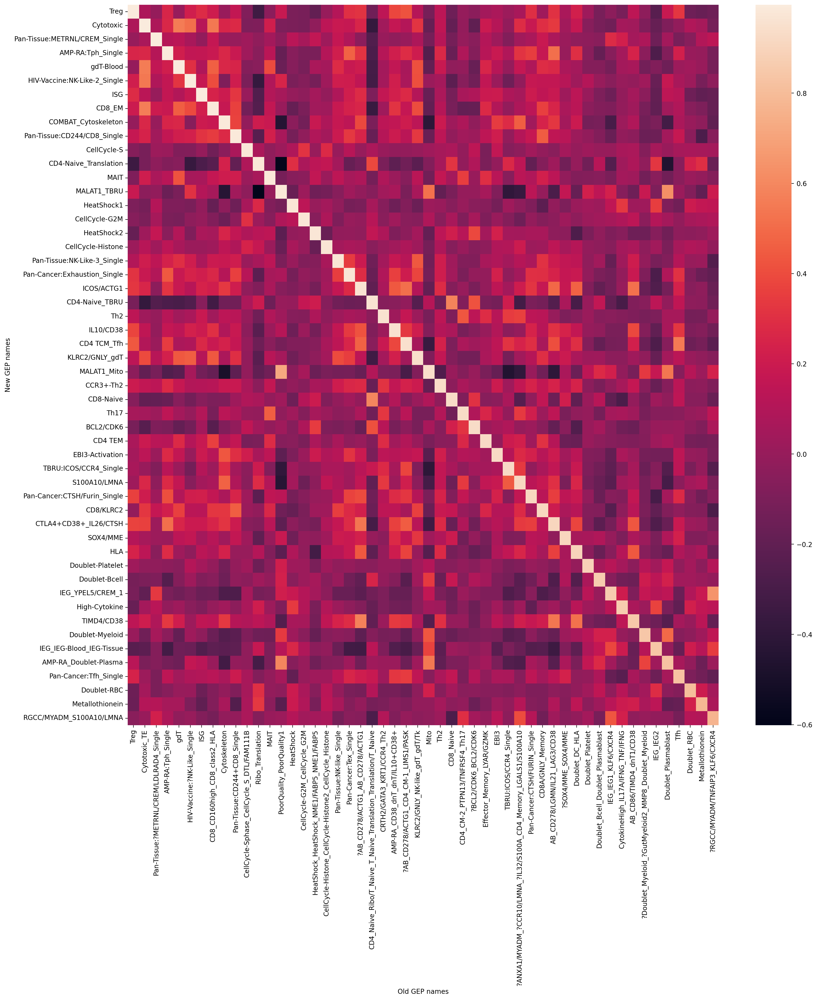

In [391]:
fig, ax = plt.subplots(dpi = 200, figsize = (20, 20))
sns.heatmap(cgep_corr.loc[gep_order, oldgep_order])
ax.set_xlabel('Old GEP names')
ax.set_ylabel('New GEP names')

Text(440.44444444444446, 0.5, 'New GEP names')

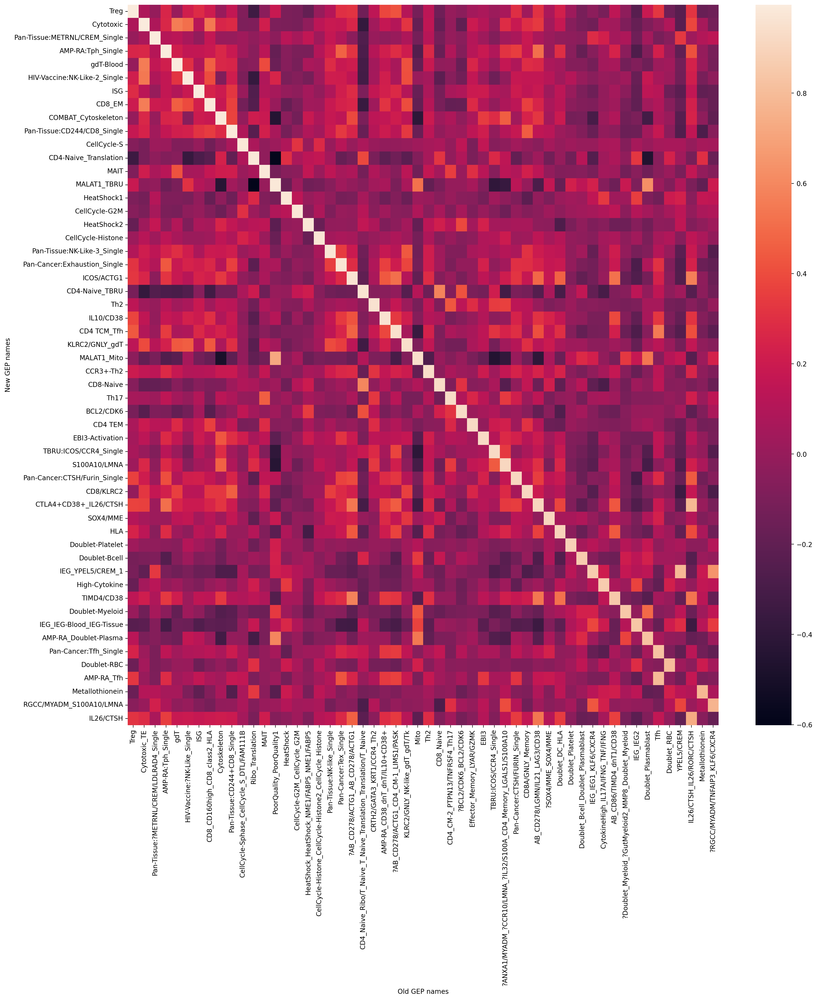

In [ ]:
fig, ax = plt.subplots(dpi = 200, figsize = (20, 20))
sns.heatmap(cgep_corr.loc[gep_order, oldgep_order])
ax.set_xlabel('Old GEP names')
ax.set_ylabel('New GEP names')

In [392]:
gep_info_new.head()

,MetaGep_Name,Long_Name,Short_Name,Needs Review,Class,Num_Datasets,Flag
Treg,Treg,Treg,Treg,NaN,Known Lineage,7.0,NaN
Cytotoxic,Cytotoxic,Cytotoxic,Cytotoxic,NaN,Known Activity,7.0,NaN
Pan-Tissue:METRNL/CREM_Single,Pan-Tissue:METRNL/CREM_Single,METRNL/CREM-Associated,METRNL/CREM,Yes,Unclear,1.0,NaN
AMP-RA:Tph_Single,AMP-RA:Tph_Single,T peripheral helper,Tph,NaN,Known Lineage,1.0,NaN
gdT-Blood,gdT-Blood,Gamma Delta T Blood,gdT-Blood,NaN,Known Lineage,4.0,NaN


In [393]:
gep_info_new = gep_info_new.drop(['Num_Datasets'], axis = 1)

In [394]:
# Add GEPs not present in other cluster labeling
new_geps = sorted(list(set(clus_df.index).difference(gep_info_new.index)))
gep_info_new = gep_info_new.append(pd.DataFrame([new_geps, [np.nan]*len(new_geps), [np.nan]*len(new_geps), 
              ['Yes']*len(new_geps), [np.nan]*len(new_geps), [np.nan]*len(new_geps)], 
             index = gep_info_new.columns, 
             columns = new_geps).T)

In [395]:
gep_info_new['Num_Datasets'] = np.sum(-clus_df.loc[gep_info_new.index, :].isna(), axis = 1)
gep_info_new = gep_info_new.sort_values(['Num_Datasets', 'Long_Name'], ascending = [False, True])

In [396]:
gep_info_new

,MetaGep_Name,Long_Name,Short_Name,Needs Review,Class,Flag,Num_Datasets
COMBAT_Cytoskeleton,COMBAT_Cytoskeleton,Actin Cytoskeleton,Cytoskeleton,NaN,Known Activity,NaN,7
CD8_EM,CD8_EM,CD8 Effector Memory,CD8_EM,NaN,Known Lineage,NaN,7
CellCycle-G2M,CellCycle-G2M,Cell Cycle G2M Phase,CellCycle-G2M,NaN,Known Activity,NaN,7
CellCycle-S,CellCycle-S,Cell Cycle S Phase,CellCycle-S,NaN,Known Activity,NaN,7
Cytotoxic,Cytotoxic,Cytotoxic,Cytotoxic,NaN,Known Activity,NaN,7
...,...,...,...,...,...,...,...
UK-Covid:UK-Covid:CRHBP/EGFL7_Single_Single,UK-Covid:UK-Covid:CRHBP/EGFL7_Single_Single,NaN,NaN,Yes,NaN,NaN,1
UK-Covid:UK-Covid:IEG3_Single_Single,UK-Covid:UK-Covid:IEG3_Single_Single,NaN,NaN,Yes,NaN,NaN,1
UK-Covid:UK-Covid:ITGA2/GATA2_Single_Single,UK-Covid:UK-Covid:ITGA2/GATA2_Single_Single,NaN,NaN,Yes,NaN,NaN,1
UK-Covid:UK-Covid:KRT17/DDAH1_Single_Single,UK-Covid:UK-Covid:KRT17/DDAH1_Single_Single,NaN,NaN,Yes,NaN,NaN,1


In [397]:
cluster_method = 'TPMrenorm.VarNorm.HVGunion'
outfn = '../../Data/TCAT/cGEPs_AutoRenamed.%s%s.txt' % (cluster_method, toadd)
print(outfn)
gep_info_new.to_csv(outfn, sep = '\t')

../../Data/TCAT/cGEPs_AutoRenamed.TPMrenorm.VarNorm.HVGunion.20231016.txt


In [398]:
gep_info_new_old = pd.read_csv('../../Data/TCAT/cGEPs_AutoRenamed.TPMrenorm.VarNorm.HVGunion.20231016_old.txt',
                               index_col = 0, sep = '\t')

In [400]:
gep_info_new

,MetaGep_Name,Long_Name,Short_Name,Needs Review,Class,Flag,Num_Datasets
COMBAT_Cytoskeleton,COMBAT_Cytoskeleton,Actin Cytoskeleton,Cytoskeleton,NaN,Known Activity,NaN,7
CD8_EM,CD8_EM,CD8 Effector Memory,CD8_EM,NaN,Known Lineage,NaN,7
CellCycle-G2M,CellCycle-G2M,Cell Cycle G2M Phase,CellCycle-G2M,NaN,Known Activity,NaN,7
CellCycle-S,CellCycle-S,Cell Cycle S Phase,CellCycle-S,NaN,Known Activity,NaN,7
Cytotoxic,Cytotoxic,Cytotoxic,Cytotoxic,NaN,Known Activity,NaN,7
...,...,...,...,...,...,...,...
UK-Covid:UK-Covid:CRHBP/EGFL7_Single_Single,UK-Covid:UK-Covid:CRHBP/EGFL7_Single_Single,NaN,NaN,Yes,NaN,NaN,1
UK-Covid:UK-Covid:IEG3_Single_Single,UK-Covid:UK-Covid:IEG3_Single_Single,NaN,NaN,Yes,NaN,NaN,1
UK-Covid:UK-Covid:ITGA2/GATA2_Single_Single,UK-Covid:UK-Covid:ITGA2/GATA2_Single_Single,NaN,NaN,Yes,NaN,NaN,1
UK-Covid:UK-Covid:KRT17/DDAH1_Single_Single,UK-Covid:UK-Covid:KRT17/DDAH1_Single_Single,NaN,NaN,Yes,NaN,NaN,1


In [404]:
np.sum(np.sum(gep_info_new==gep_info_new_old.loc[gep_info_new.index, :]))

411

In [405]:
np.sum(np.sum(gep_info_new!=gep_info_new_old.loc[gep_info_new.index, :]))

296

In [415]:
np.sum(gep_info_new!=gep_info_new_old.loc[gep_info_new.index, :], axis = 1)

COMBAT_Cytoskeleton                            2
CD8_EM                                         2
CellCycle-G2M                                  2
CellCycle-S                                    2
Cytotoxic                                      2
                                              ..
UK-Covid:UK-Covid:CRHBP/EGFL7_Single_Single    4
UK-Covid:UK-Covid:IEG3_Single_Single           4
UK-Covid:UK-Covid:ITGA2/GATA2_Single_Single    4
UK-Covid:UK-Covid:KRT17/DDAH1_Single_Single    4
UK-Covid:UK-Covid:Ribosomal_Single_Single      4
Length: 101, dtype: int64

In [420]:
gep_info_new[np.sum(gep_info_new.loc[:, ['MetaGep_Name', 'Long_Name', 'Short_Name']]
       !=gep_info_new_old.loc[gep_info_new.index, ['MetaGep_Name', 'Long_Name', 'Short_Name']], axis = 1) > 0]

,MetaGep_Name,Long_Name,Short_Name,Needs Review,Class,Flag,Num_Datasets
RGCC/MYADM_S100A10/LMNA,RGCC/MYADM_S100A10/LMNA,RGCC/MYADM-Associated,RGCC/MYADM,Yes,Unclear,NaN,5
Metallothionein,Metallothionein,Metallothionein,Metallothionein,NaN,Known Activity,NaN,4
AMP-RA_Tfh,AMP-RA_Tfh,NaN,NaN,Yes,NaN,NaN,3
AMP-RA_Pan-Cancer,AMP-RA_Pan-Cancer,NaN,NaN,Yes,NaN,NaN,2
CH25H/DDIT4_Pan-Cancer,CH25H/DDIT4_Pan-Cancer,NaN,NaN,Yes,NaN,NaN,2
HIV-Vaccine,HIV-Vaccine,NaN,NaN,Yes,NaN,NaN,2
IEG_YPEL5/CREM_2,IEG_YPEL5/CREM_2,NaN,NaN,Yes,NaN,NaN,2
IL26/CTSH,IL26/CTSH,NaN,NaN,Yes,NaN,NaN,2
AMP-RA:AMP-RA:Doublet_Mast_Single_Single,AMP-RA:AMP-RA:Doublet_Mast_Single_Single,NaN,NaN,Yes,NaN,NaN,1
AMP-RA:AMP-RA:Hypoxia_Single_Single,AMP-RA:AMP-RA:Hypoxia_Single_Single,NaN,NaN,Yes,NaN,NaN,1


In [421]:
gep_info_new_old[np.sum(gep_info_new_old.loc[:, ['MetaGep_Name', 'Long_Name', 'Short_Name']]
       !=gep_info_new.loc[gep_info_new_old.index, ['MetaGep_Name', 'Long_Name', 'Short_Name']], axis = 1) > 0]

,MetaGep_Name,Long_Name,Short_Name,Needs Review,Class,Flag,Num_Datasets
RGCC/MYADM_S100A10/LMNA,RGCC/MYADM_S100A10/LMNA,Metallothionein,Metallothionein,NaN,Known Activity,NaN,5
Metallothionein,Metallothionein,IL26/CTSH-Associated,IL26/CTSH,Yes,Suspected Activity,NaN,4
AMP-RA_Tfh,AMP-RA_Tfh,YPEL5/CREM-Associated,YPEL5/CREM,Yes,Unclear,NaN,3
IL26/CTSH,IL26/CTSH,RGCC/MYADM-Associated,RGCC/MYADM,Yes,Unclear,NaN,2
AMP-RA_Pan-Cancer,AMP-RA_Pan-Cancer,NaN,NaN,Yes,NaN,NaN,2
CH25H/DDIT4_Pan-Cancer,CH25H/DDIT4_Pan-Cancer,NaN,NaN,Yes,NaN,NaN,2
HIV-Vaccine,HIV-Vaccine,NaN,NaN,Yes,NaN,NaN,2
IEG_YPEL5/CREM_2,IEG_YPEL5/CREM_2,NaN,NaN,Yes,NaN,NaN,2
AMP-RA:AMP-RA:Doublet_Mast_Single_Single,AMP-RA:AMP-RA:Doublet_Mast_Single_Single,NaN,NaN,Yes,NaN,NaN,1
AMP-RA:AMP-RA:Hypoxia_Single_Single,AMP-RA:AMP-RA:Hypoxia_Single_Single,NaN,NaN,Yes,NaN,NaN,1


In [417]:
gep_info_new[['MetaGep_Name', 'Long_Name', 'Short_Name']]

,MetaGep_Name,Long_Name,Short_Name
COMBAT_Cytoskeleton,COMBAT_Cytoskeleton,Actin Cytoskeleton,Cytoskeleton
CD8_EM,CD8_EM,CD8 Effector Memory,CD8_EM
CellCycle-G2M,CellCycle-G2M,Cell Cycle G2M Phase,CellCycle-G2M
CellCycle-S,CellCycle-S,Cell Cycle S Phase,CellCycle-S
Cytotoxic,Cytotoxic,Cytotoxic,Cytotoxic
...,...,...,...
UK-Covid:UK-Covid:CRHBP/EGFL7_Single_Single,UK-Covid:UK-Covid:CRHBP/EGFL7_Single_Single,NaN,NaN
UK-Covid:UK-Covid:IEG3_Single_Single,UK-Covid:UK-Covid:IEG3_Single_Single,NaN,NaN
UK-Covid:UK-Covid:ITGA2/GATA2_Single_Single,UK-Covid:UK-Covid:ITGA2/GATA2_Single_Single,NaN,NaN
UK-Covid:UK-Covid:KRT17/DDAH1_Single_Single,UK-Covid:UK-Covid:KRT17/DDAH1_Single_Single,NaN,NaN


### Explore TRM cGEPs

In [466]:
from adjustText import adjust_text

In [430]:
geps = ['CD8/KLRC2', 'Pan-Tissue:METRNL/CREM_Single', 'Pan-Tissue:CD244/CD8_Single']

In [490]:
Zspec.loc[geps, :].T.corr('spearman')

,CD8/KLRC2,Pan-Tissue:METRNL/CREM_Single,Pan-Tissue:CD244/CD8_Single
CD8/KLRC2,1.000000,0.127098,0.401882
Pan-Tissue:METRNL/CREM_Single,0.127098,1.000000,-0.015313
Pan-Tissue:CD244/CD8_Single,0.401882,-0.015313,1.000000


In [551]:
toadd_labels = ['CXCR6', 'RGS1']

In [522]:
n_top_markers = 40

top_markers = pd.DataFrame()

for gep in geps:
    top_markers = top_markers.append(pd.Series(Zspec.loc[gep, :].dropna().sort_values(
        ascending = False).head(n_top_markers).index), ignore_index = True)

top_markers.index = geps
top_markers = top_markers.T

In [579]:
for gep in geps:
    print(gep)
    for gene in toadd_labels:
        print(gene, list(Zspec.loc[gep, :].dropna().sort_values(ascending = False).index).index(gene))
    
    print()

CD8/KLRC2
CXCR6 81
RGS1 18513

Pan-Tissue:METRNL/CREM_Single
CXCR6 1221
RGS1 437

Pan-Tissue:CD244/CD8_Single
CXCR6 1483
RGS1 985



In [581]:
Zspec.loc[geps, :].dropna(axis = 1).shape

(3, 17394)

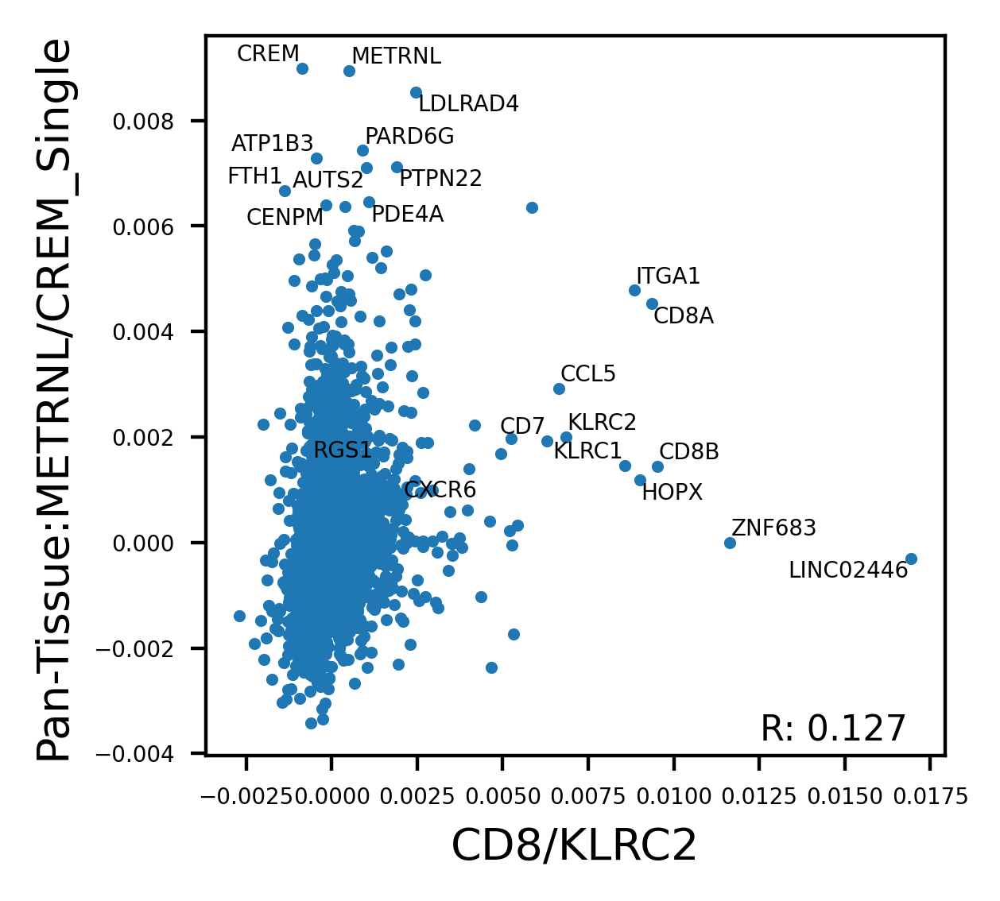

In [552]:
gep1 = geps[0]
gep2 = geps[1]
n_markers = 10
(gep1, gep2
)
with rc_context({'figure.figsize': (3, 3), 'figure.dpi':400,
                'xtick.labelsize': 5,
                 'ytick.labelsize': 5}):
    
    Zspec_comp = Zspec.loc[[gep1, gep2], :].dropna(axis = 1)
    labels = list(set(Zspec_comp.loc[gep1, :].sort_values(ascending = False).head(n_markers).index
                ).union(Zspec_comp.loc[gep2, :].sort_values(ascending = False).head(n_markers).index))
    labels = labels + toadd_labels
    
    r, _ = spearmanr(Zspec_comp.loc[gep1, :], Zspec_comp.loc[gep2, :])
    
    fig, ax = plt.subplots()
    ax.scatter(x = Zspec_comp.loc[gep1, :], y =  Zspec_comp.loc[gep2, :], s = 3)
    ax.set_xlabel(gep1)
    ax.set_ylabel(gep2)
    
    texts = []
    for x, y, s in zip(Zspec_comp.loc[gep1, labels], 
                      Zspec_comp.loc[gep2, labels], 
                       labels):
        texts.append(ax.text(x, y, s, size = 5))
    adjust_text(texts, ax = ax)
    
    ax.text(x = .75, y = 0.02, s = 'R: %.3f' % r, transform=ax.transAxes, size = 8)

    plt.show()

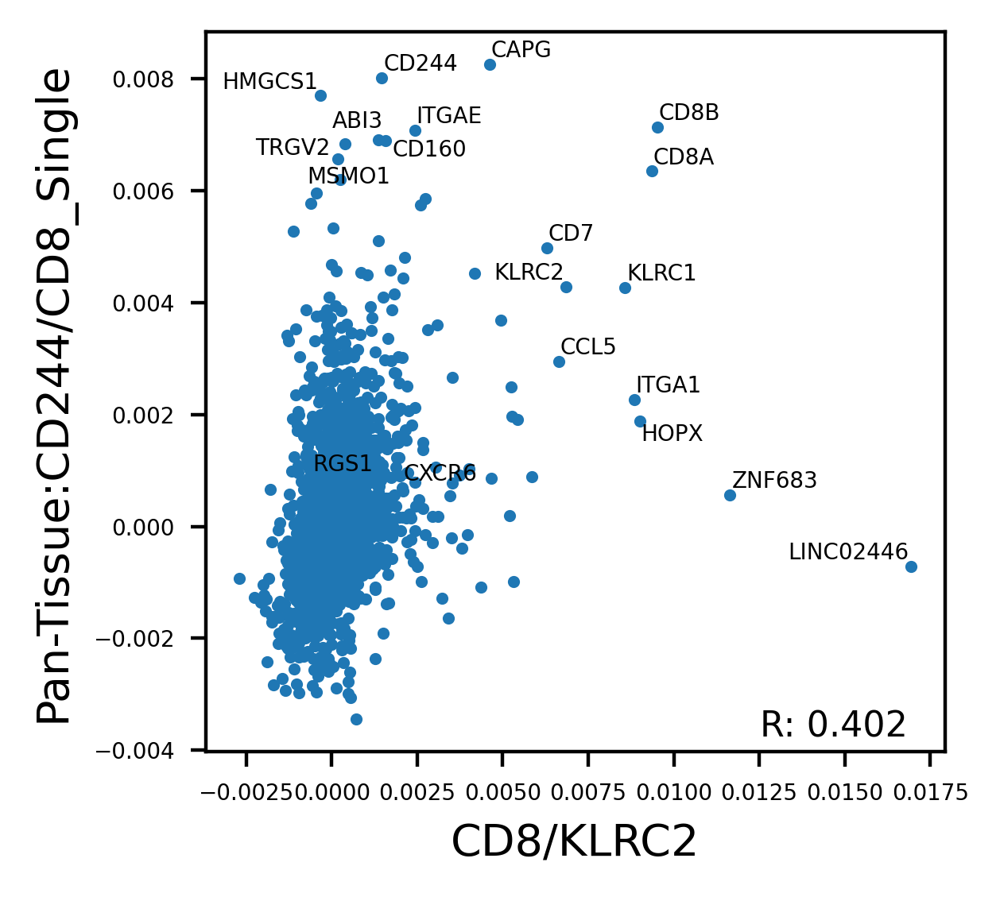

In [553]:
gep1 = geps[0]
gep2 = geps[2]
n_markers = 10
gep1, gep2

with rc_context({'figure.figsize': (3, 3), 'figure.dpi':400,
                'xtick.labelsize': 5,
                 'ytick.labelsize': 5}):
    
    Zspec_comp = Zspec.loc[[gep1, gep2], :].dropna(axis = 1)
    labels = list(set(Zspec_comp.loc[gep1, :].sort_values(ascending = False).head(n_markers).index
                ).union(Zspec_comp.loc[gep2, :].sort_values(ascending = False).head(n_markers).index))
    labels = labels + toadd_labels
    
    r, _ = spearmanr(Zspec_comp.loc[gep1, :], Zspec_comp.loc[gep2, :])
    
    fig, ax = plt.subplots()
    ax.scatter(x = Zspec_comp.loc[gep1, :], y =  Zspec_comp.loc[gep2, :], s = 3)
    ax.set_xlabel(gep1)
    ax.set_ylabel(gep2)
    
    texts = []
    for x, y, s in zip(Zspec_comp.loc[gep1, labels], 
                      Zspec_comp.loc[gep2, labels], 
                       labels):
        texts.append(ax.text(x, y, s, size = 5))
    adjust_text(texts, ax = ax)
    
    ax.text(x = .75, y = 0.02, s = 'R: %.3f' % r, transform=ax.transAxes, size = 8)

    plt.show()

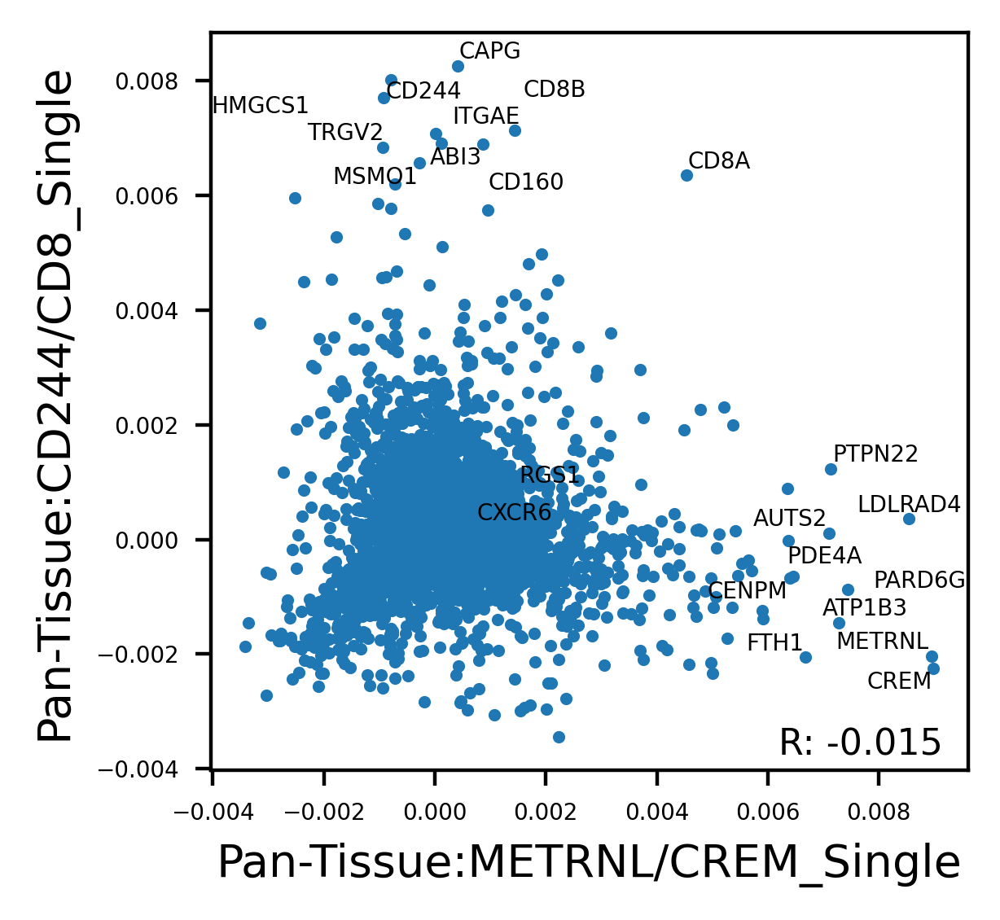

In [554]:
gep1 = geps[1]
gep2 = geps[2]
n_markers = 10
gep1, gep2

with rc_context({'figure.figsize': (3, 3), 'figure.dpi':400,
                'xtick.labelsize': 5,
                 'ytick.labelsize': 5}):
    
    Zspec_comp = Zspec.loc[[gep1, gep2], :].dropna(axis = 1)
    labels = list(set(Zspec_comp.loc[gep1, :].sort_values(ascending = False).head(n_markers).index
                ).union(Zspec_comp.loc[gep2, :].sort_values(ascending = False).head(n_markers).index))
    labels = labels + toadd_labels
    
    r, _ = spearmanr(Zspec_comp.loc[gep1, :], Zspec_comp.loc[gep2, :])
    
    fig, ax = plt.subplots()
    ax.scatter(x = Zspec_comp.loc[gep1, :], y =  Zspec_comp.loc[gep2, :], s = 3)
    ax.set_xlabel(gep1)
    ax.set_ylabel(gep2)
    
    texts = []
    for x, y, s in zip(Zspec_comp.loc[gep1, labels], 
                      Zspec_comp.loc[gep2, labels], 
                       labels):
        texts.append(ax.text(x, y, s, size = 5))
    adjust_text(texts, ax = ax)
    
    ax.text(x = .75, y = 0.02, s = 'R: %.3f' % r, transform=ax.transAxes, size = 8)

    plt.show()

In [641]:
dataset = 'AMP-RA'
adata = sc.read(params.loc[dataset, 'tpm_counts_for_cnmf'])
markers = ['AB_CD69']
marker_counts = pd.DataFrame(adata[:, markers].X.todense(), index = adata.obs.index, 
                             columns = markers)

usage = pd.read_csv(params.loc[dataset, 'tcat_fn'], index_col = 0, sep = '\t')
print(dataset)
for gep in geps:
    print(gep, 
          round(marker_counts.loc[usage.index, :].corrwith(usage[gep], method = 'spearman').values[0], 6))

AMP-RA
CD8/KLRC2 0.078427
Pan-Tissue:METRNL/CREM_Single 0.125343
Pan-Tissue:CD244/CD8_Single 0.066366


In [651]:
dataset = 'TBRU'
adata = sc.read(params.loc[dataset, 'tpm_counts_for_cnmf'])

markers = ['AB_CD69']
marker_counts = pd.DataFrame(adata[:, markers].X.todense(), index = adata.obs.index, 
                             columns = markers)

usage = pd.read_csv(params.loc[dataset, 'tcat_fn'], index_col = 0, sep = '\t')
print(dataset)
for gep in geps:
    print(gep, 
          round(marker_counts.loc[usage.index, :].corrwith(usage[gep], method = 'spearman').values[0], 6))

TBRU
CD8/KLRC2 0.074724
Pan-Tissue:METRNL/CREM_Single 0.057214
Pan-Tissue:CD244/CD8_Single 0.039872


In [653]:
dataset

'TBRU'

In [ ]:
# Calculate % of cells expressing each TRM GEP

In [655]:
threshold = .1

In [674]:
for dataset in params.index:
    print(dataset)
    usage = pd.read_csv(params.loc[dataset, 'tcat_fn'], index_col = 0, sep = '\t')
    usage_norm = usage.div(usage.sum(axis=1), axis=0)
    
    for gep in geps:
        print(gep, 
              round((usage_norm[gep] > threshold).value_counts()[True]/len(usage_norm[gep])*100, 6))
    print()

AMP-RA
CD8/KLRC2 2.239282
Pan-Tissue:METRNL/CREM_Single 1.034578
Pan-Tissue:CD244/CD8_Single 0.351948

Pan-Cancer
CD8/KLRC2 9.048212
Pan-Tissue:METRNL/CREM_Single 8.825937
Pan-Tissue:CD244/CD8_Single 0.953741

TBRU
CD8/KLRC2 0.90084
Pan-Tissue:METRNL/CREM_Single 0.380132
Pan-Tissue:CD244/CD8_Single 0.086385

HIV-Vaccine
CD8/KLRC2 0.319415
Pan-Tissue:METRNL/CREM_Single 0.025935
Pan-Tissue:CD244/CD8_Single 0.004095

UK-Covid
CD8/KLRC2 1.070178
Pan-Tissue:METRNL/CREM_Single 0.281737
Pan-Tissue:CD244/CD8_Single 0.223171

COMBAT
CD8/KLRC2 0.894182
Pan-Tissue:METRNL/CREM_Single 0.200536
Pan-Tissue:CD244/CD8_Single 0.147908

Pan-Tissue
CD8/KLRC2 0.804113
Pan-Tissue:METRNL/CREM_Single 14.405051
Pan-Tissue:CD244/CD8_Single 8.657769



### Explore CXCL13/TCF7 cGEPs

In [11]:
from adjustText import adjust_text

In [13]:
Zspec.index

Index(['CellCycle-G2M', 'CD4-Naive_Translation', 'HLA', 'ISG', 'MALAT1_Mito',
       'Doublet-RBC', 'gdT-Blood', 'Cytotoxic', 'CellCycle-S', 'HeatShock1',
       ...
       'COMBAT:CCR3+-Th2_Single', 'Pan-Tissue:METRNL/CREM_Single',
       'Pan-Tissue:CD244/CD8_Single', 'Pan-Tissue:NK-Like-3_Single',
       'Pan-Tissue:Pan-Tissue:Digestive/Liver_Single',
       'Pan-Tissue:Pan-Tissue:Macrophage_Single',
       'Pan-Tissue:Pan-Tissue:Liver-Metabolism_Single',
       'Pan-Tissue:Pan-Tissue:Plasma_Single',
       'Pan-Tissue:Pan-Tissue:Paneth_Single', 'Pan-Tissue:FCN3/FCN2_Single'],
      dtype='object', length=101)

In [52]:
n_top_markers = 200

top_markers = pd.DataFrame()
geps_all = Zspec.index

for gep in geps_all:
    top_markers = pd.concat([top_markers, pd.Series(Zspec.loc[gep, :].dropna().sort_values(
        ascending = False).head(n_top_markers).index)], ignore_index = True, axis = 1)

# top_markers = top_markers.T
top_markers.columns = geps_all

In [59]:
[(gep, top_markers[gep].tolist().index('CXCL13')) for gep in top_markers.columns if 'CXCL13' in top_markers[gep].tolist()]

[('Metallothionein', 25),
 ('Th2', 113),
 ('AMP-RA_Tfh', 7),
 ('EBI3-Activation', 82),
 ('AMP-RA:Tph_Single', 34),
 ('Pan-Cancer:Exhaustion_Single', 50),
 ('Pan-Cancer:CTSH/Furin_Single', 125),
 ('Pan-Cancer:Tfh_Single', 61),
 ('TBRU:Tfh_Single', 1)]

In [61]:
[(gep, top_markers[gep].tolist().index('TCF7')) for gep in top_markers.columns if 'TCF7' in top_markers[gep].tolist()]

[('CD4 TCM_Tfh', 36),
 ('CD4-Naive_TBRU', 4),
 ('CD8-Naive', 56),
 ('SOX4/MME', 71),
 ('Pan-Cancer:Tfh_Single', 37)]

In [64]:
gep = 'Pan-Cancer:CTSH/Furin_Single'
top_markers[gep].head(40)

0          CTSH
1          IL26
2         FURIN
3          PKIG
4     KIAA0319L
5        COL5A3
6        SLC1A4
7       TMPRSS3
8          GPX1
9         IL17F
10       LGALS3
11          MSC
12     TNFRSF25
13       PTPN13
14        DCP1B
15         NCDN
16          BLM
17         GDE1
18        NTRK2
19       SPOCK2
20         ARL3
21        PPARG
22        GNA15
23       MFHAS1
24        BATF3
25        BCAT1
26        RPLP0
27        TNIP1
28         RBPJ
29      RNF144B
30         SMOX
31       ADAM12
32         SOX4
33        MAST4
34        SMCO4
35          FES
36       ADAM19
37        IL17A
38         CSF2
39         LGMN
Name: Pan-Cancer:CTSH/Furin_Single, dtype: object

# TPM, Var Norm, HVG Union genes

In [79]:
cluster_method = 'TPM.VarNorm.HVGunion'

clus_fn = tcat_dir + 'cluster_groups.pairwiseCorr.%s%s.txt' % (cluster_method, toadd)
print(clus_fn)

R = pd.read_csv(os.path.join(tcat_dir, 'R.%s%s.tsv' % (cluster_method, toadd)), 
                index_col = 0, sep = '\t')
clus_df = pd.read_csv(clus_fn, index_col = 0, sep = '\t')

../../Data/TCAT/cluster_groups.pairwiseCorr.TPM.VarNorm.HVGunion.20231016.txt


In [48]:
name = 'Scores'
method = 'Mean'
gene_types = ['Intersection', 'Union']

In [49]:
# Load merged spectra
spectra_merged = {}
for gene_type in gene_types:
    
    if name not in spectra_merged:
        spectra_merged[name] = {}
    if gene_type not in spectra_merged[name]:
        spectra_merged[name][gene_type] = {}
    spectra_fn =  os.path.join(tcat_dir, 'merged_spectra.Gene_%s.Gene_%s.%s.%s%s.tsv' % (name, gene_type, 
                                                                                        cluster_method, method,
                                                                                   toadd))
    spectra = pd.read_csv(spectra_fn, index_col = 0, sep = '\t')
    spectra_merged[name][gene_type][method] = spectra

In [50]:
n_top_genes = 40
gene_scores = {}
for dataset in params.index:
    gene_scores[dataset] = {}
    gene_scores[dataset]['Z_orig'] = pd.read_csv(params.loc[dataset, 'gene_scores_fn'], index_col = 0, sep = '\t')
    gene_scores[dataset]['Z_orig'].columns = dataset + ':' + gene_scores[dataset]['Z_orig'].columns
    
    # Relabel columns with cGEP labels
    gene_scores[dataset]['Z_relabel'] = gene_scores[dataset]['Z_orig'].copy()
    gene_scores[dataset]['Z_relabel'].columns = [(clus_df[dataset][clus_df[dataset]==gep].index)[0] 
                                                 for gep in gene_scores[dataset]['Z_relabel'].columns]
    
    # Get top genes
    spectra_scores = gene_scores[dataset]['Z_relabel']
    top_genes = []
    for gep in spectra_scores.columns:
        top_genes.append(list(spectra_scores.sort_values(by=gep, ascending=False).index[:n_top_genes]))

    top_genes = pd.DataFrame(top_genes, index=spectra_scores.columns).T
    gene_scores[dataset]['top_genes'] = top_genes
    
    print(dataset)

AMP-RA
Pan-Cancer
TBRU
HIV-Vaccine
UK-Covid
COMBAT
Pan-Tissue


## Consolidate results

In [51]:
corr_thresh = 0.5
low_corr_thresh = 0.4

In [52]:
corr_thresholds = [0.3, 0.4, 0.5]

In [53]:
cgep_ouputs = {}

In [54]:
cgep_ouputs['top_genes'] = {}
for cgep in clus_df.index:
    print(cgep) 
    sub_geps = clus_df.loc[cgep, :].dropna()

    top_genes = pd.DataFrame()
    
    # Get top genes for each dataset
    for dataset in sub_geps.index:
        print(dataset)
        top_genes = pd.concat([top_genes, pd.Series(gene_scores[dataset]['top_genes'][cgep], name = dataset)], axis = 1)
        
    # Get top genes from merged spectra
    for gene_type in gene_types:
        top_genes_merged = pd.Series(spectra_merged[name][gene_type][method].loc[cgep, :].sort_values(ascending = False).head(n_top_genes).index,
                 name = '_'.join([method, name, gene_type]))

        top_genes = pd.concat([top_genes, top_genes_merged], axis = 1)
        
    cgep_ouputs['top_genes'][cgep] = top_genes

CellCycle-G2M
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Cancer
Pan-Tissue
HIV-Vaccine
CD4-Naive_Translation
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Tissue
HIV-Vaccine
HLA
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Cancer
Pan-Tissue
ISG
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Cancer
Pan-Tissue
HIV-Vaccine
MALAT1_Mito
TBRU
UK-Covid
COMBAT
Pan-Tissue
HIV-Vaccine
Doublet-RBC
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Cancer
Pan-Tissue
HIV-Vaccine
gdT-Blood
TBRU
UK-Covid
COMBAT
HIV-Vaccine
CellCycle-S
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Cancer
Pan-Tissue
HIV-Vaccine
Cytotoxic
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Cancer
Pan-Tissue
HIV-Vaccine
Doublet-Platelet
TBRU
UK-Covid
COMBAT
Pan-Tissue
HIV-Vaccine
HeatShock2
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Cancer
Pan-Tissue
S100A10/LMNA
TBRU
UK-Covid
COMBAT
Pan-Tissue
MAIT
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Cancer
Pan-Tissue
HIV-Vaccine
CellCycle-Histone
AMP-RA
TBRU
COMBAT
Pan-Cancer
Pan-Tissue
HIV-Vaccine
COMBAT_Cytoskeleton
AMP-RA
TBRU
UK-Covid
COMBAT
Pan-Cancer
Pan-Tissue
HIV-Vaccine
HeatShock1
AMP-RA
Pan-Can

In [55]:
cgep_ouputs['alt_sub_geps'] = {}

for cgep in clus_df.index:
    print(cgep) 
    sub_geps = clus_df.loc[cgep, :].dropna()

    cgep_ouputs['alt_sub_geps'][cgep] = {}

    # Get which other GEPs are highly correlated with sub_geps in this cGEP
    for corr_thresh in corr_thresholds:
        cgep_ouputs['alt_sub_geps'][cgep]['corr_%s' % (str(corr_thresh))] = list(set(
            R.index[np.sum(R[sub_geps] > corr_thresh, axis = 1) > 0]).difference(sub_geps))

CellCycle-G2M
CD4-Naive_Translation
HLA
ISG
MALAT1_Mito
Doublet-RBC
gdT-Blood
CellCycle-S
Cytotoxic
Doublet-Platelet
HeatShock2
S100A10/LMNA
MAIT
CellCycle-Histone
COMBAT_Cytoskeleton
HeatShock1
High-Cytokine
KLRC2/GNLY_gdT
Doublet-Myeloid
Metallothionein
CD4 TCM_Tfh
IEG_IEG-Blood_IEG-Tissue
CD8_EM
IEG_YPEL5/CREM_1
CD4-Naive_TBRU
Treg
Th17
MALAT1_TBRU
CD8-Naive
RGCC/MYADM_S100A10/LMNA
TIMD4/CD38
AMP-RA_Doublet-Plasma
BCL2/CDK6
IL10/CD38
CCR3+-Th2
Th2
ICOS/ACTG1
Doublet-Bcell
CD4 TEM
CTLA4+CD38+_IL26/CTSH
CD8/KLRC2
IL26/CTSH
AMP-RA_Tfh
EBI3-Activation
HIV-Vaccine
IEG_YPEL5/CREM_2
AMP-RA_Pan-Cancer
SOX4/MME
CH25H/DDIT4_Pan-Cancer
AMP-RA:Th17_Single
AMP-RA:Tph_Single
AMP-RA:AMP-RA:Hypoxia_Single_Single
AMP-RA:AMP-RA:Doublet_Mast_Single_Single
Pan-Cancer:Exhaustion_Single
Pan-Cancer:IEG_Single
Pan-Cancer:Translation_Single
Pan-Cancer:CTSH/Furin_Single
Pan-Cancer:Pan-Cancer:Doublet_epithelial_Single_Single
Pan-Cancer:Pan-Tissue:?PlasmaDoublet/WFDC2/SCGB3A1_Single_Single
Pan-Cancer:Tph_Singl

## Output PDF

In [57]:
cluster_method

'TPM.VarNorm.HVGunion'

In [ ]:
nrow = 5
ncol = 2
figsize = (15, 33) #1.5 + (nrow-1)*7.83
ticklabelsize = 7
tablefontsize = 6
n_top_genes_display = 30
corr_thresh = 0.5

pdf = matplotlib.backends.backend_pdf.PdfPages(tcat_dir + 'cgep_correlations.%s%s.pdf' % (cluster_method, toadd))
for cgep in clus_df.index:
    # print(cgep) 
    sub_geps = clus_df.loc[cgep, :].dropna()

    fig, ax = plt.subplots(nrows = nrow, ncols = ncol, figsize = figsize, dpi = 200,
                           gridspec_kw={
                               # 'width_ratios': [3, 3],
                               'height_ratios':  [1.5, 1, 1, 1, 1],
                           'wspace': 0.5,
                           'hspace': 1
                           }
                           )

    # Plot top genes
    n_top_genes_display = 30
    a = []
    for i in range(cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).values.shape[1]):
        if i%2==0:
            c = 'white'
        else:
            c = 'lavender'
        a.append([c]* cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).values.shape[0])
    a = np.array(a).T

    ax[0, 0].set_axis_off() 
    table = ax[0, 0].table( 
        cellText = cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).values,  
        cellColours = a, 
        rowLabels = cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).index,
        colLabels = cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).columns.str.replace(
            '_Union', '\nUnion').str.replace('_Intersection','\nIntersection'),
        #cgep_ouputs['top_genes'][cgep].columns,
        rowColours =["#Bbb8fb"] * len(cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).index),  
        colColours =["#Bbb8fb"] * len(cgep_ouputs['top_genes'][cgep].head(n_top_genes_display).columns), 
        cellLoc ='center',  
        loc ='upper left')    
    table.auto_set_font_size(False)
    table.set_fontsize(tablefontsize)
    ax[0, 0].set_title(cgep)


    # Plot spectra correlations of sub_geps
    sns.heatmap(R.loc[list(sub_geps) + cgep_ouputs['alt_sub_geps'][cgep]['corr_%s' % (str(corr_thresh))], 
                      list(sub_geps) + cgep_ouputs['alt_sub_geps'][cgep]['corr_%s' % (str(corr_thresh))]],
                vmin = 0, vmax = 1, ax = ax[0, 1],
                annot = True, annot_kws= {'fontsize' :'x-small'})

    ax[0, 1].hlines(y = len(sub_geps), xmin = 0, xmax = len(sub_geps), color = 'white', linestyles = '--')
    ax[0, 1].vlines(x = len(sub_geps), ymin = 0, ymax = len(sub_geps), color = 'white', linestyles = '--')
    ax[0, 1].set_title('Clustered', loc = 'left')
    ax[0, 1].tick_params(axis = 'both', labelsize = ticklabelsize)

    if len(cgep_ouputs['alt_sub_geps'][cgep]['corr_%s' % (str(corr_thresh))]) > 0:
        ax[0, 1].set_title('Correlated', loc = 'right')
    ax[0, 1].set_title('Clustered', loc = 'left')
    ax[0, 1].set_title('Spectra Score Correlations', y = 1.07)


    # Output which clusters correlated sub_geps were added to, and the sub_gep correlations to those clusters
    n = 0
    gep_list = []
    for alt_sub_gep in cgep_ouputs['alt_sub_geps'][cgep]['corr_%s' % (str(corr_thresh))]:
        if alt_sub_gep not in gep_list: 
            i = n//ncol
            j = n%ncol

            alt_cgep = clus_df[np.sum(clus_df==alt_sub_gep, axis = 1) > 0].index[0]
            gep_list += clus_df.loc[alt_cgep, :].dropna().tolist()
            sns.heatmap(R.loc[sub_geps, clus_df[np.sum(clus_df==alt_sub_gep, axis = 1) > 0].T.dropna().iloc[:, 0]],
                        ax = ax[i+1, j], vmin = 0, vmax = 1,
                        annot = True, annot_kws= {'fontsize' :'small'})
            ax[i+1, j].tick_params(axis = 'both', labelsize = ticklabelsize + 2)
            ax[i+1, j].set_ylabel('Clustered GEPs')
            ax[i+1, j].set_xlabel('Other cluster GEPs')
            ax[i+1, j].set_title('Correlation with other cluster:\n'+ alt_cgep)
            n+=1

    # Hide extra plots
    while n<(ncol*nrow -2):
        i = n//ncol
        j = n%ncol
        ax[i+1, j].set_axis_off() 
        n+=1
    plt.show()
    pdf.savefig(fig)
pdf.close()


# View GEPs found and top genes for each dataset

In [64]:
for dataset in params.index:
    print(dataset)
    print(gene_scores[dataset]['Z_orig'].columns)

AMP-RA
Index(['AMP-RA:Translation', 'AMP-RA:MALAT1', 'AMP-RA:CD8_EM', 'AMP-RA:IEG',
       'AMP-RA:YPEL5/CREM', 'AMP-RA:CD4-Naive', 'AMP-RA:IEG-Tissue',
       'AMP-RA:Tfh', 'AMP-RA:Cytoskeleton', 'AMP-RA:Cytotoxic',
       'AMP-RA:AMP-RA:Doublet_Fibroblast_Single', 'AMP-RA:Th17',
       'AMP-RA:S100A10/LMNA', 'AMP-RA:Treg', 'AMP-RA:HeatShock2', 'AMP-RA:Tph',
       'AMP-RA:CD8/KLRC2', 'AMP-RA:gdT', 'AMP-RA:MAIT', 'AMP-RA:HeatShock1',
       'AMP-RA:EBI3-Activation', 'AMP-RA:AMP-RA:SERPINE2_Single', 'AMP-RA:ISG',
       'AMP-RA:AMP-RA:Doublet_Plasma_Single', 'AMP-RA:HLA',
       'AMP-RA:High-Cytokine', 'AMP-RA:CellCycle-S',
       'AMP-RA:CellCycle-Histone', 'AMP-RA:IL10/CD38',
       'AMP-RA:AMP-RA:Hypoxia_Single', 'AMP-RA:CellCycle-G2M',
       'AMP-RA:Doublet-Bcell', 'AMP-RA:AMP-RA:Doublet_Mast_Single',
       'AMP-RA:Doublet-RBC'],
      dtype='object')
Pan-Cancer
Index(['Pan-Cancer:CD8/KLRC2', 'Pan-Cancer:CD8_EM', 'Pan-Cancer:YPEL5/CREM',
       'Pan-Cancer:CD4-Naive', 'Pan-Cancer

In [65]:
for dataset in params.index:
    print(dataset)
    print(gene_scores[dataset]['top_genes'].columns)

AMP-RA
Index(['Translation', 'MALAT1', 'CD8_EM', 'IEG_RGCC/MYADM', 'YPEL5/CREM',
       'CD4-Naive', 'IEG-Blood_IEG-Tissue', 'Tfh', 'COMBAT_Cytoskeleton',
       'Cytotoxic', 'AMP-RA_Pan-Cancer', 'AMP-RA:Th17_Single',
       'RGCC/MYADM_S100A10/LMNA', 'Treg', 'HeatShock2', 'AMP-RA:Tph_Single',
       'CD8/KLRC2', 'gdT', 'MAIT', 'HeatShock1', 'EBI3-Activation',
       'AMP-RA_Tfh', 'ISG', 'AMP-RA:AMP-RA:Doublet_Plasma_Single_Single',
       'HLA', 'High-Cytokine', 'CellCycle-S', 'CellCycle-Histone', 'IL10/CD38',
       'AMP-RA:AMP-RA:Hypoxia_Single_Single', 'CellCycle-G2M', 'Doublet-Bcell',
       'AMP-RA:AMP-RA:Doublet_Mast_Single_Single', 'Doublet-RBC'],
      dtype='object')
Pan-Cancer
Index(['CD8/KLRC2', 'CD8_EM', 'YPEL5/CREM', 'CD4-Naive',
       'Pan-Cancer:Pan-Cancer:CD4/CD20_Single_Single', 'Treg',
       'COMBAT_Cytoskeleton', 'Cytotoxic', 'IEG-Blood_IEG-Tissue',
       'RGCC/MYADM_S100A10/LMNA', 'HeatShock2', 'Pan-Cancer:Exhaustion_Single',
       'AMP-RA_Pan-Cancer', 'HeatSho

In [71]:
for dataset in params.index:
    print(dataset)
    display(gene_scores[dataset]['top_genes'].head(20).T)

AMP-RA


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
Translation,RPS12,RPS18,RPS2,RPLP1,RPS27A,RPL41,RPL11,RPL10,RPL13,RPS3,RPL26,RPS14,RPL19,RPL23A,RPL30,RPL18A,RPS4X,RPL3,RPL32,RPL7A
MALAT1,MALAT1,SYNE2,NKTR,DDX17,MACF1,AHNAK,MIAT,KIAA1551,N4BP2L2,RNF213,IKZF1,XIST,MT-ND2,PCSK7,ARGLU1,MT-ND5,MT-ND3,ASH1L,MT-CO3,MTRNR2L12
CD8_EM,GZMK,GZMA,CCL5,CST7,CD8A,CD8B,HLA-DPB1,HLA-DPA1,NKG7,HLA-DRB1,APOBEC3G,CD74,GZMH,HLA-DRA,HCST,GZMM,HLA-DQA1,HLA-A,HLA-C,CD81
IEG_RGCC/MYADM,TNFAIP3,CXCR4,KLF6,ZFP36,NFKBIA,SAMSN1,RGCC,TENT5C,ZFP36L2,RGS1,BTG1,CD69,PTGER4,PDE4B,REL,FTH1,PHLDA1,TSC22D3,LMNA,FOSL2
YPEL5/CREM,YPEL5,ZNF331,BCAS2,PRMT9,CYCS,RNF139,SELENOK,CHMP1B,RANBP2,NR4A2,CREM,ARL4A,VPS37B,ALG13,AREG,JUND,EIF4A3,DNAJA1,USP36,EIF1
CD4-Naive,FHIT,LEF1,CCR7,SELL,RPS3A,RPS13,ACTN1,RPS8,RPS6,TXK,AB_CD27-2,RPL32,ADTRP,RPS12,TRABD2A,RPS5,RPS23,RPL9,NOG,RPL22
IEG-Blood_IEG-Tissue,IER2,JUN,FOSB,EGR1,GADD45B,UBE2S,TUBB4B,SERTAD1,BTG2,FOS,IER5,H2AFX,SNHG12,JUNB,MARCKSL1,INTS6,DUSP2,DUSP1,NFKBIA,H3F3B
Tfh,PVALB,NR3C1,AB_CD279,FKBP5,THADA,TOX2,TSHZ2,PTPN13,DRAIC,IL6ST,SMCO4,LIMS1,ZNRF1,PASK,MAF,PGM2L1,CORO1B,ITM2A,RNF19A,FZD3
COMBAT_Cytoskeleton,ACTG1,ACTB,PFN1,TMSB10,TMSB4X,CORO1A,MYL6,CFL1,COTL1,ARPC1B,SH3BGRL3,S100A4,MYL12A,ARPC2,ARHGDIB,TPM4,CD52,CLIC1,ARPC3,IL32
Cytotoxic,FGFBP2,CX3CR1,GZMH,NKG7,PRF1,GNLY,FCGR3A,KLRD1,EFHD2,PLEK,SPON2,S1PR5,ASCL2,ADGRG1,PRSS23,KLRF1,C1orf21,LINC02384,MYOM2,FCRL6


Pan-Cancer


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
CD8/KLRC2,ZNF683,HOPX,CD8A,KLRC1,ITGA1,CD8B,CCL5,LDLRAD4,CAPG,SH3BGRL3,CD52,ITGAE,CD7,CLIC3,ITM2C,CD63,SLA2,ALOX5AP,PGK1,SYNGR1
CD8_EM,GZMK,CMC1,CST7,EOMES,DKK3,ENC1,SH2D1A,ITM2C,TRAT1,DUSP2,LYST,DTHD1,CCL5,APOBEC3G,CD8A,CRTAM,COTL1,GZMA,GZMM,CD8B
YPEL5/CREM,ZNF331,ZFP36,ATP1B3,FTH1,NR4A3,FAM177A1,ZFP36L2,JUNB,TUBA4A,PFKFB3,CREM,NR4A2,SC5D,CXCR4,SLC2A3,YPEL5,BTG1,EZR,ETV3,CTH
CD4-Naive,RPS8,RPL32,CCR7,RPS13,SELL,RPL11,RPS12,RPL13,RPS3A,LEF1,RPL19,EEF1A1,RPS5,RPS23,RPL29,RPL5,RPL18A,RPS6,RPL18,RPL22
Pan-Cancer:Pan-Cancer:CD4/CD20_Single_Single,CD40LG,TXNIP,FKBP5,IL7R,ADAM19,AIM1,TNFSF8,CD4,ERN1,NR3C1,PRDM1,TMEM173,RGS1,GPR171,ITK,CYSLTR1,MAF,NLRP3,KLRB1,CTSL
Treg,FOXP3,CARD16,RTKN2,BATF,TBC1D4,IKZF2,TIGIT,CTLA4,IL32,HTATIP2,IL2RA,STAM,CCR8,MAGEH1,SAT1,GK,GBP2,IL1R2,GBP5,CD27
COMBAT_Cytoskeleton,ACTB,PFN1,ACTG1,CFL1,CORO1A,S100A4,TMSB10,ARPC1B,MYL6,LGALS1,SH3BGRL3,COTL1,S100A6,TMSB4X,PPP1CA,ARPC2,CLIC1,RAC2,GAPDH,CD52
Cytotoxic,FGFBP2,NKG7,GZMH,PRSS23,S1PR5,FCGR3A,CX3CR1,PRF1,SPON2,C1orf21,KLRD1,PLEK,FGR,ITGAM,FCRL6,KLRG1,PLAC8,GNLY,FLNA,EFHD2
IEG-Blood_IEG-Tissue,FOSB,FOS,DUSP1,EGR1,KLF6,CD69,TUBB4B,PPP1R15A,JUNB,CITED2,NR4A1,SERTAD1,TSC22D3,NFKBIA,TAGAP,H3F3B,IER2,NR4A2,DNAJA1,EIF1
RGCC/MYADM_S100A10/LMNA,LMNA,MYADM,CRIP1,VIM,ANXA1,TAGLN2,RGCC,AHNAK,S100A10,MCL1,S100A11,EZR,GPR183,TUBA1A,TSC22D3,ZFP36,TUBB2A,EMP1,IDS,CD44


TBRU


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
Translation,RPS2,RPL3,RPS5,EEF1B2,RPL10A,RPS18,RPS12,RPL18A,RPS3A,RPL10,RPSA,RPS6,RPL21,RPS3,RPS10,RPS9,EEF1A1,RPL26,RPS4X,RPL23A
MALAT1,MT-CO3,MT-CO1,MT-ATP6,MT-CO2,MALAT1,MT-ND1,MT-CYB,MT-ND4,MT-ND3,XIST,NKTR,NEAT1,MT-ND5,MT-ND2,DDX17,SERINC5,MIAT,PRRC2C,OGA,CCNL1
TBRU:HIV-Vaccine:?TXNIP/H3F3B_Single_Single,TXNIP,PLP2,CXCR4,PCSK1N,CRIP2,FXYD7,AB_CD48,MAL,ZFP36L2,GIMAP7,LPAR6,VIM,FTL,IL7R,H1FX,JUNB,ITM2B,EPHB6,RCBTB2,UBXN11
CD4-Naive_TBRU,CCR7,AB_CD27-1,PLAC8,SELL,AIF1,TXK,ACTN1,LINC00402,PASK,AK5,CMTM8,CD7,TMIGD2,CHRM3-AS2,ADTRP,SOCS3,IL6ST,LEF1,TCEA3,SATB1
MALAT1_TBRU,SYNE2,GOLGB1,NCL,SMC1A,GOLGA4,HIST1H1E,LCP1,SYNE1,ITGA4,HIST1H1C,HNRNPA2B1,TPR,SLFN5,SPEN,SPTBN1,PTPRC,AHNAK,PCNT,PRKDC,RAD21
CD4 TEM,LYAR,GZMK,IFNG-AS1,DUSP2,TXNIP,IL7R,CXCR3,AB_CD26,NSG1,AB_CXCR3,ZFP36L2,ID2,MS4A1,AB_CD127,PLCB1,AB_CD195,XCL1,HOPX,CCL5,AB_CD29
Cytotoxic,FGFBP2,GZMH,NKG7,GZMB,GNLY,PRF1,EFHD2,PRSS23,SPON2,ADGRG1,ASCL2,CST7,FCGR3A,ZEB2,CX3CR1,PLEK,GZMA,FCRL6,LAIR2,CTSW
CD4 TCM_ICOS/ACTG1,LIMS1,KLRB1,ITM2A,TMSB4X,CORO1B,PASK,LTB,ITGA4,TMEM156,AB_CD161,AQP3,AB_CD279,RNASET2,AB_CD95,TBC1D4,CD52,MARCKSL1,GMFG,ARID5B,H3F3A
COMBAT_Cytoskeleton,ACTB,PFN1,ACTG1,CFL1,CORO1A,ARPC1B,MYL6,CLIC1,LCP1,CALR,DOK2,SDF2L1,ARPC2,PSME2,WDR1,SH3BGRL3,COTL1,ACTR3,CAP1,S100A4
TBRU:ICOS/ACTG1_Single,ACTG1,GAPDH,SLC25A5,PCLAF,AB_CD278,S1PR4,MXD4,AB_CD38-1,DECR1,SLC25A3,GIMAP4,UCP2,MYL6B,ARHGDIB,CLTA,ACTB,CORO1A,GBP2,NOSIP,ARPC5


HIV-Vaccine


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
CD4-Naive_TBRU,IL6ST,CCR7,FHIT,SELL,SATB1,TCF7,PIK3IP1,LEF1,FOXP1,AB_GP130,AB_CD109,FYB1,TRABD2A,AB_CD307e,NOSIP,CHRM3-AS2,GIMAP7,AB_CD38-1,LINC00861,AB_CD38-2
CD8-Naive,LINC02446,AB_CD8,AB_CD8a,CD8B,AB_CD73,NELL2,S100B,AB_CD55,CARS,AB_CD45RA,ACTN1,AB_CD314,AB_CD31,PASK,YBX3,CCR7,PDE3B,CD8A,OXNAD1,NRCAM
Translation,RPS18,RPS8,RPL3,RPS6,RPS4X,RPS3,RPS12,EEF1A1,RPL13,RPS27A,RPLP1,RPS3A,RPS14,RPS2,EEF1B2,RPL10,TPT1,RPS15A,RPL21,RPL34
HIV-Vaccine:HIV-Vaccine:?TXNIP/H3F3B_Single_Single,TXNIP,H3F3B,H1FX,RPS4Y1,RPL30,BTG1,FAU,RPS10,AB_CD172a,PTMA,PFDN5,RPS15,AB_MERTK,RPS27A,AB_CD138-1,AB_CD324,RPL24,AB_Siglec-8,AB_CD68,RPL26
MALAT1_TBRU,MALAT1,MACF1,UTRN,GOLGA4,GOLGB1,SYNE2,SYNE1,KIAA1551,SMCHD1,ANKRD36C,BDP1,NCL,HNRNPU,TUT7,MYH9,HNRNPA2B1,NKTR,ATRX,CEP350,KIAA1109
HIV-Vaccine:CD4 TCM_Single,LIMS1,PASK,GPR183,AP3M2,FYB1,TSHZ2,AB_CD45RO,ARID5B,CORO1B,ST8SIA1,CD84,AQP3,LPAR6,EPHA4,TRADD,LINC00402,TBC1D4,SOCS3,AB_CD95,ITM2A
CD4 TEM,IL7R,LYAR,PTGER2,ITGA1,CXCR3,IFNG-AS1,CYB561,GBP5,ANTXR2,IGFBP3,AB_CD2,AB_CD103,PRDM1,NSG1,AB_CD49d,GIMAP7,GPR171,AB_CD49a,CCR9,CD2
COMBAT_Cytoskeleton,ACTB,ACTG1,PFN1,CFL1,CLIC1,LCP1,TPM4,CORO1A,CALR,ARPC2,MYL12A,S100A4,MYL6,TMSB4X,HCST,SH3BGRL3,EMP3,S100A6,ACTR3,CALM1
Cytotoxic,FGFBP2,GZMH,NKG7,PROK2,GZMB,EFHD2,CST7,AB_CD271,ITGB1,ZEB2,PRSS23,C1orf21,B2M,TGFBR3,CCL5,ADGRG1,ASCL2,CD52,CD8A,LINC02384
Mito,MT-ATP6,MT-CYB,MT-CO2,MT-ND4,MT-CO3,MT-ND3,MT-ND2,MT-ND1,MT-ND5,MT-CO1,MT-ND4L,MT-ATP8,MT-ND6,AB_CD45-2,MTRNR2L12,RPL36A,AB_CD314,AB_CD138-1,AB_CD275-1,AB_CD68


UK-Covid


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
CD4-Naive_TBRU,CCR7,TCF7,LEF1,FHIT,SELL,AK5,ACTN1,TMIGD2,AB_abTCR,RPS13,TSHZ2,NOSIP,NOG,CHRM3-AS2,RPL30,IL6ST,ADTRP,MDS2,AB_CD4-2,AB_CD3-1
Translation,RPS18,RPS6,RPL13,EEF1A1,RPLP1,RPL3,RPL18A,RPS12,RPS3,RPLP0,RPL26,TPT1,RPS9,RPS4X,RPS19,RPS5,RPL19,RPL4,RPL10A,RPL10
Cytotoxic,FGFBP2,GZMH,NKG7,GZMB,PRF1,PRSS23,ADGRG1,CST7,B2M,SPON2,GNLY,ZNF683,CX3CR1,SH3BGRL3,ASCL2,CD8A,FCGR3A,S100A4,KLRD1,CTSW
COMBAT_Cytoskeleton,ACTB,ACTG1,PFN1,CORO1A,CFL1,CNN2,WDR1,CLIC1,LCP1,TPM4,ARPC1B,MYL6,SIT1,RAC2,DOK2,CISD3,CALR,PSME2,ARPC5,ACTR3
IEG,YPEL5,TSC22D3,PPP1R15A,JUNB,DUSP1,EIF1,TUBA1A,KLF2,DNAJB1,CSRNP1,NR4A2,CXCR4,ARL4A,JUN,ZFP36,FTH1,BTG1,TNFAIP3,CD69,AREG
UK-Covid:COMBAT:CellCycle_Histone3_Single_Single,RNPEPL1,SRM,MZT2B,FMNL1,RPL41,RPL39,MTRNR2L12,SUN2,KLF2,TMEM238,GLRX5,PCBP1,GRK6,RPL34,MRPL23,CMPK1,CD81,RPL37,RPS21,RPS28
UK-Covid:UK-Covid:Ribosomal_Single_Single,RPL17,EEF1G,TOMM6,ATP5PO,RPL36A,RPS10-NUDT3,RPS17,NDUFB8,EIF4A1,IL2RG,RPL26,AB_CD106,ARPC4,CORO7,AB_TCR-V-24-J-18,AB_CD279,RPL13,PSMA2,NDUFA7,TAP2
MALAT1_TBRU,MYH9,MACF1,AHNAK,SYNE2,MALAT1,NEAT1,FLNA,PLEC,SYNE1,LCP1,SLFN5,PTPRC,RNF213,SPTBN1,SFPQ,TNFAIP3,MCL1,ITGA4,TLN1,GPRIN3
CD8-Naive,LINC02446,CD8B,AB_CD8,NT5E,CD248,AB_CD45RA,AB_CD73,NELL2,REG4,CLEC11A,S100B,AIF1,LRRN3,ACTN1,MXRA8,CD8A,LEF1,CD79A,CPA5,PECAM1
CD8_EM,CMC1,CD160,EOMES,CD8A,GZMK,GZMM,CST7,CD8B,CCL5,AOAH,FCRL3,AB_CD244,DTHD1,XCL2,CRTAM,TIGIT,DUSP2,FYN,LYST,KLRD1


COMBAT


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
CD4-Naive,RPS12,RPL32,RPS13,RPS3A,RPS8,RPL30,EEF1A1,RPL10,RPL19,RPS5,RPL11,RPS23,RPL18,EEF1B2,RPL5,RPS28,RPL35A,RPS27A,RPL29,RPS14
COMBAT_Cytoskeleton,ACTB,HMGN2,ACTG1,CFL1,PFN1,PTTG1,GAPDH,MYL6,CORO1A,ARHGDIB,ARPC2,TMSB10,PSME2,TUBA1B,CNN2,BIRC5,COX8A,CDKN3,CHCHD2,PPIA
CD4 TCM_ICOS/ACTG1,AB_CD278,LIMS1,AB_CD279,TMSB4X,UCP2,ACTG1,AB_CD45RO,AB_CD38-1,CNN2,CD52,TRIB2,AB_CD28,ITM2A,GAPDH,PFN1,ACTB,TMSB10,FYB1,CORO1B,PLAC8
Doublet-Plasma,IGKV3-20,JCHAIN,IGLV2-14,IGLV1-44,IGLV3-21,IGLV3-1,IGKV4-1,IGLV1-51,IGKV1-5,IGLV1-47,IGKV3-15,IGLV1-40,IGHV5-51,IGLV2-23,IGLV2-8,IGLV3-25,IGKC,IGHV4-39,IGHV1-69D,IGHV3-7
HeatShock2,FABP5,HSP90AB1,HSPD1,HSPE1,NPM1,AB_CD71,RPL22L1,HSPA8,HSP90AA1,PAICS,RAN,HPDL,TUBB3,CCT2,AB_CD86,POPDC3,NCL,NPM3,LDHA,CCT6A
Cytotoxic,FGFBP2,GZMH,NKG7,AB_CD57,GZMB,ADGRG1,PRSS23,PRF1,CX3CR1,AB_CX3CR1,CST7,GNLY,SPON2,SH3BGRL3,ZNF683,PLEK,FCGR3A,CD8A,CTSW,CCL5
Th17,CCR6,CTSH,CMTM6,AQP3,AB_CD2,AB_CD28,LTB,AB_mouseCD49f,AB_CD127,PTPN13,TNFRSF4,AB_CD95,AB_CD26,KLRB1,RORC,S100A4,AB_CD224,VIM,AB_CD196,IL7R
MALAT1_TBRU,MYH9,LCP1,HNRNPU,AHNAK,MKI67,PTPRC,CANX,SPTBN1,FLNA,HNRNPA2B1,MSN,MACF1,SYNE2,HSPA5,IQGAP1,RNF213,EIF3A,SPTAN1,EIF4G1,LBR
CD8_EM,CMC1,XCL2,AB_CD244,AB_KLRG1_MAFA,CCL5,GZMK,CD160,AB_TIGIT,CST7,AB_CD8,CCL4L2,AB_CD314,AB_CD54,KLRG1,CCL4,XCL1,AB_CD11a,CD8A,CD8B,FCRL3
Mito,MT-CYB,MT-ATP6,MT-CO3,MT-ND4L,MT-CO2,MT-ND5,MT-ATP8,MT-CO1,MT-ND3,MT-ND4,MT-ND1,MT-ND6,MT-ND2,MTRNR2L12,RPS2,AB_CD8,AB_CD73,MTRNR2L8,AB_CD31,ITGA4


Pan-Tissue


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
CD4-Naive,RPS8,RPS13,RPS12,RPS23,SELL,RPL19,RPL32,RPL29,RPL18A,RPL13,RPS5,RPL30,RPS3A,EEF1A1,RPL18,RPL11,LEF1,NOSIP,RPS14,RPS25
Pan-Tissue:METRNL/CREM_Single,CREM,METRNL,LDLRAD4,PARD6G,ATP1B3,PTPN22,AUTS2,FTH1,PDE4A,CENPM,CRIP1,LINC01871,PDE4D,SYTL3,SH2D2A,ZEB2,RUNX3,PTMA,ANKRD28,JUND
IEG_RGCC/MYADM,RGCC,MYADM,TNFAIP3,EZR,LMNA,PIM3,ANXA1,JUND,VIM,NFKB1,CSRNP1,IFFO2,KLF6,TAGLN2,YPEL5,ADGRE5,EIF1,KDM6B,FOSB,TSC22D3
S100A10/LMNA,S100A11,TIMP1,LTB,S100A4,EMP3,S100A6,S100A10,NEFL,LMNA,CD52,VIM,PLP2,ANXA2,LGALS3,TMSB10,CRIP1,ITGB1,FUT7,CD82,AHNAK
Pan-Tissue:CH25H/DDIT4_Single,CH25H,SOCS3,ZFP36L2,DDIT4,EPGN,SOCS1,CMTM8,AREG,JUNB,CRYBG1,ICOS,IL6ST,GPR183,CXCR5,FKBP5,CXCR4,TXNIP,BTG1,ADAM23,SRGN
Pan-Tissue:Translation_Single,RPS11,RPL23,RPL13A,RPS10,RPS17,RPS20,RPL27A,RPL7,RPL17,RPL21,RPS2,RPL9,RPS16,UBA52,RPLP2,RPL23A,RPL37A,TRAC,RPS3A,RPS29
MALAT1_TBRU,MALAT1,LINC-PINT,NEAT1,GOLGB1,HIST1H1D,PTPRC,SYNE2,LINC00513,NKTR,HNRNPU,RORA,DDX17,SNHG14,HIST1H1E,N4BP2L2,DDX3Y,CCNL1,ARGLU1,MACF1,TXNIP
COMBAT_Cytoskeleton,ACTG1,ACTB,PFN1,CFL1,CORO1A,ARPC1B,MYL6,COTL1,GAPDH,TMSB4X,ARPC2,CNN2,ARPC5,ARHGDIB,ACTR3,CLIC1,CAP1,PPP1CA,RAC2,SH3BGRL3
Pan-Tissue:CD244/CD8_Single,CAPG,CD244,HMGCS1,CD8B,ITGAE,ABI3,CD160,TRGV2,MSMO1,CD8A,FDFT1,HSPA1B,TMSB4X,LDLR,CKLF,TRBV4-1,NEU1,CD3D,CD7,TMIGD2
CD8_EM,GZMK,CMC1,CST7,EOMES,SH2D1A,DTHD1,KLRG1,LYST,DUSP2,PLEK,SAMD3,ENC1,HCST,GZMM,CTSW,HLA-C,HLA-A,CD74,PTGDR,LYAR


# Average cNMF GEP usage by cluster 

AMP-RA
Pan-Cancer
TBRU
HIV-Vaccine
UK-Covid


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3524: DtypeWarning: Columns (18,20,21) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


COMBAT
Pan-Tissue


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3524: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


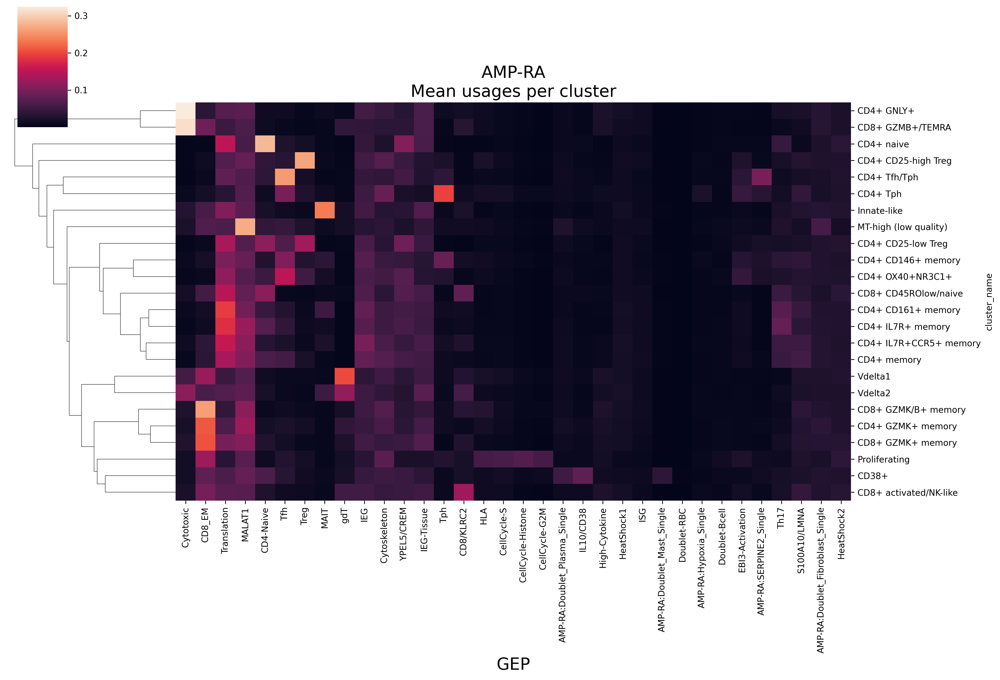

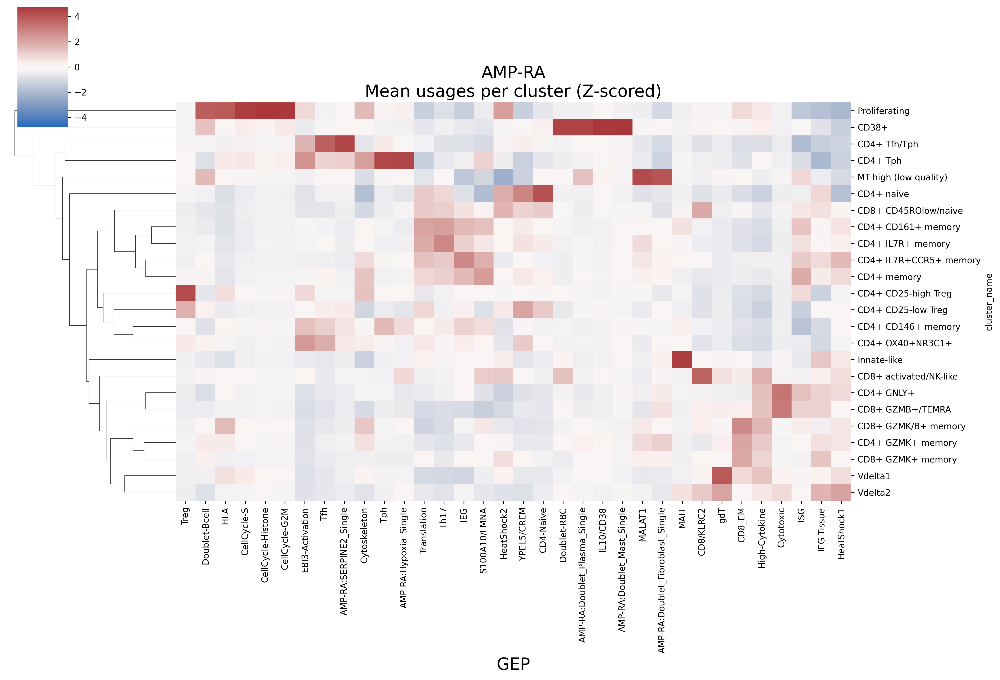

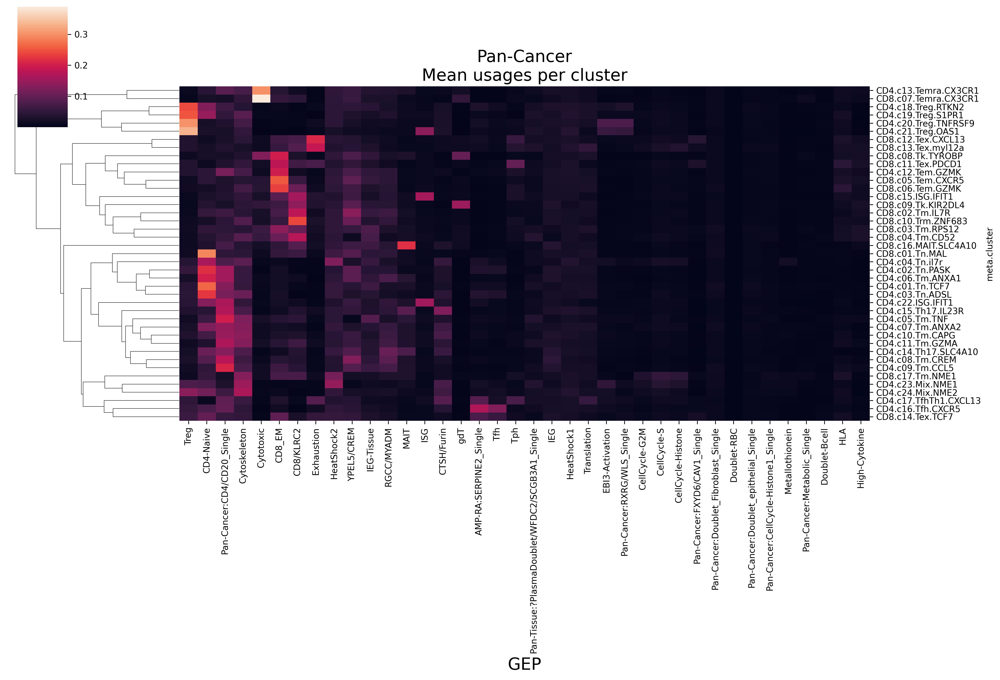

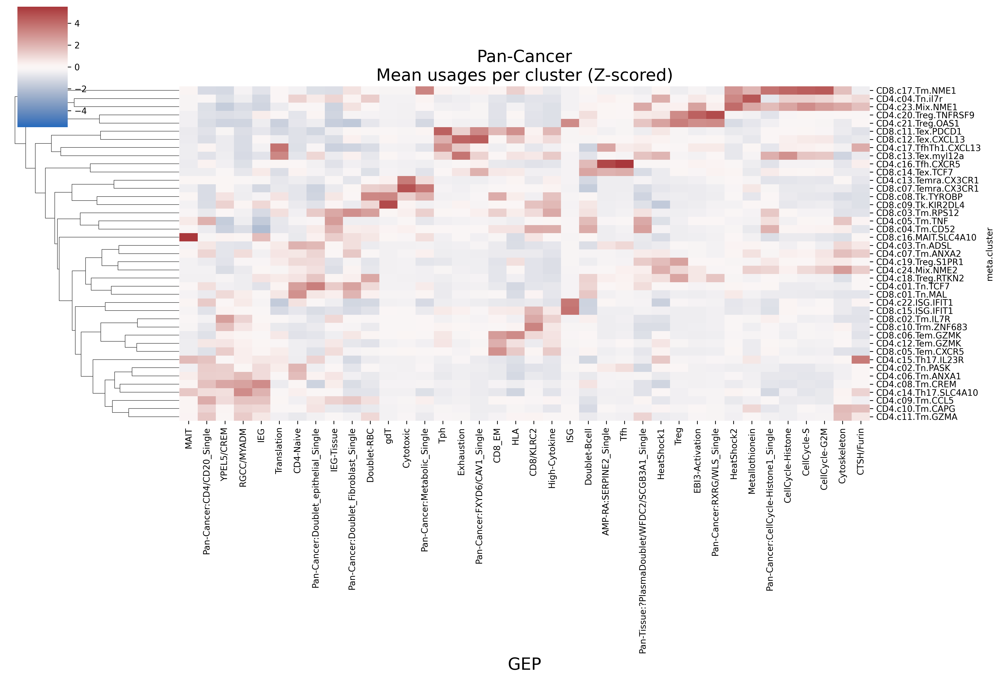

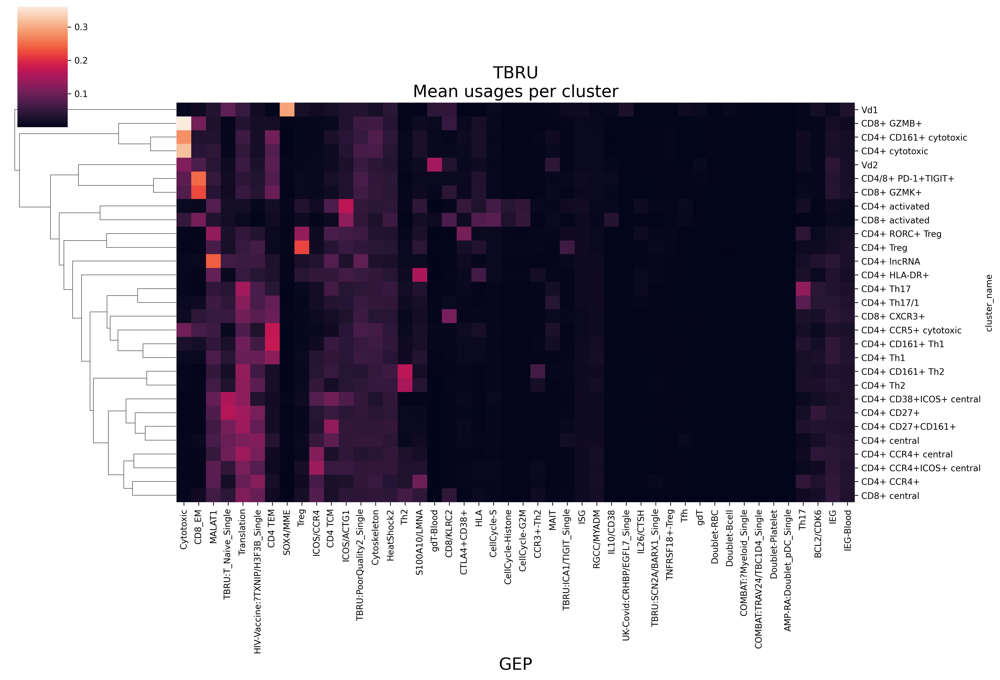

...

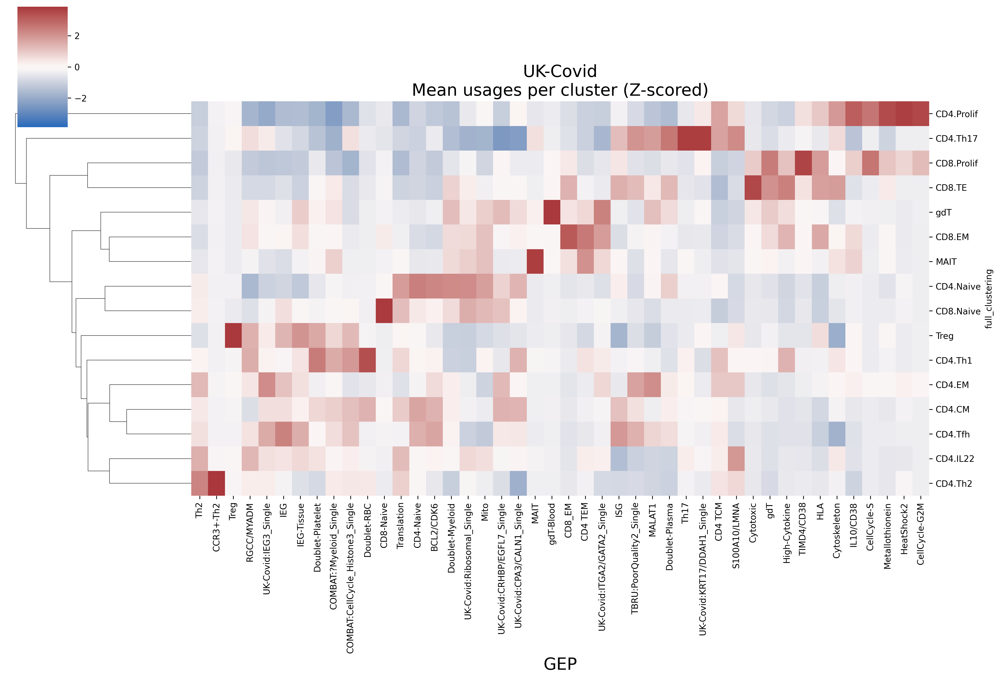

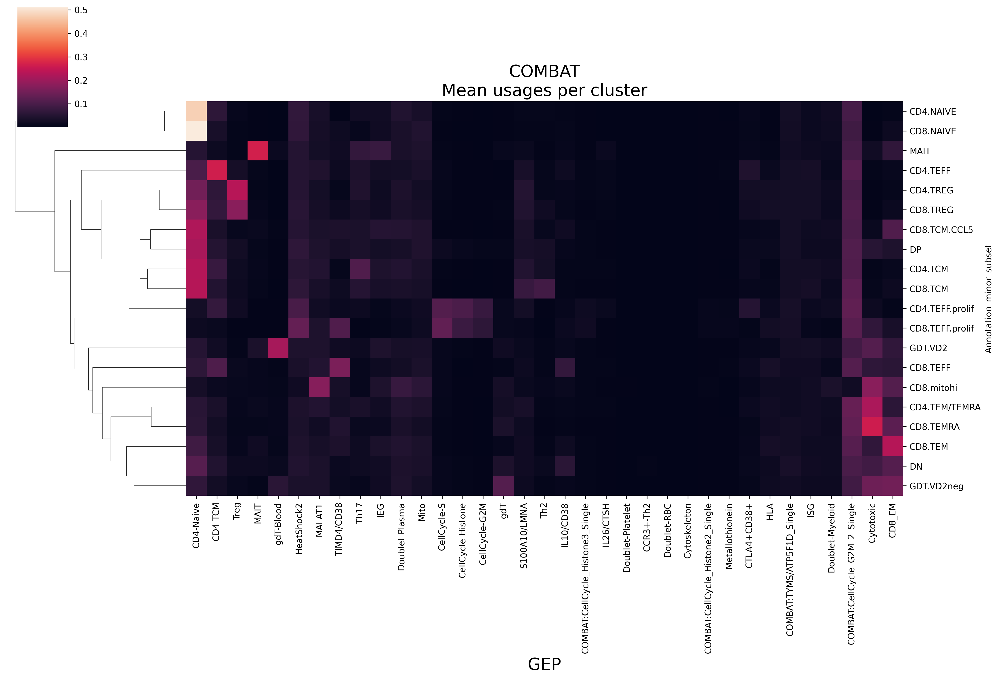

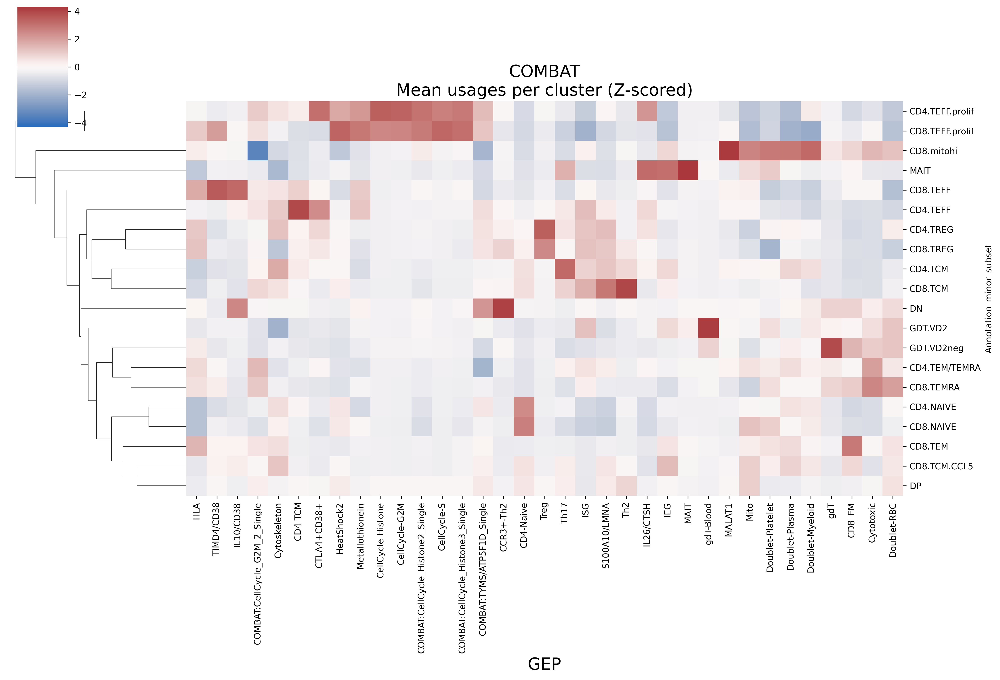

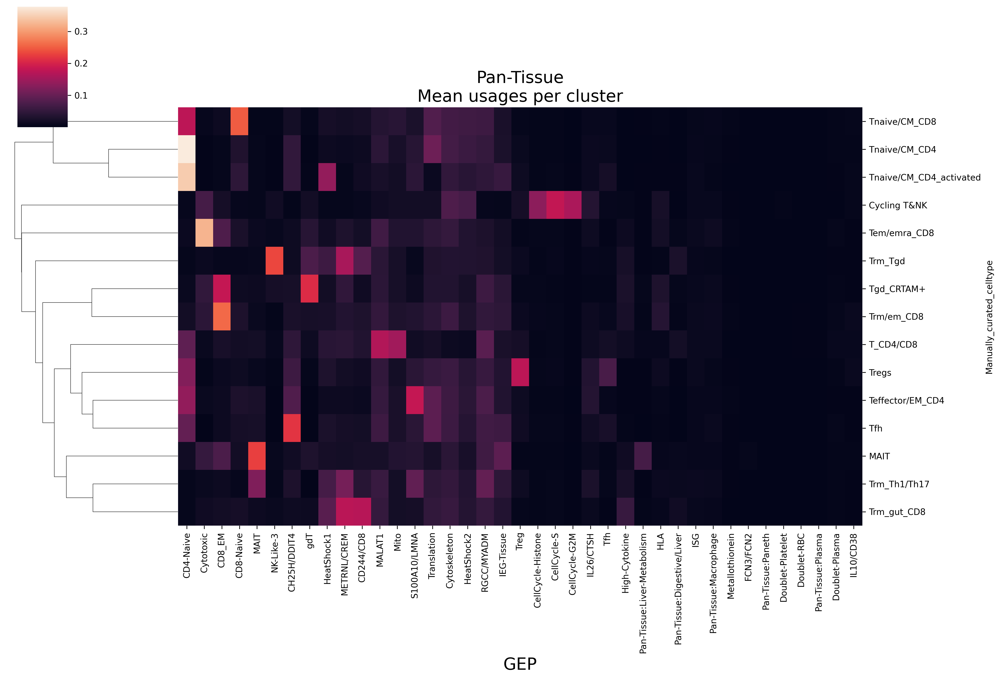

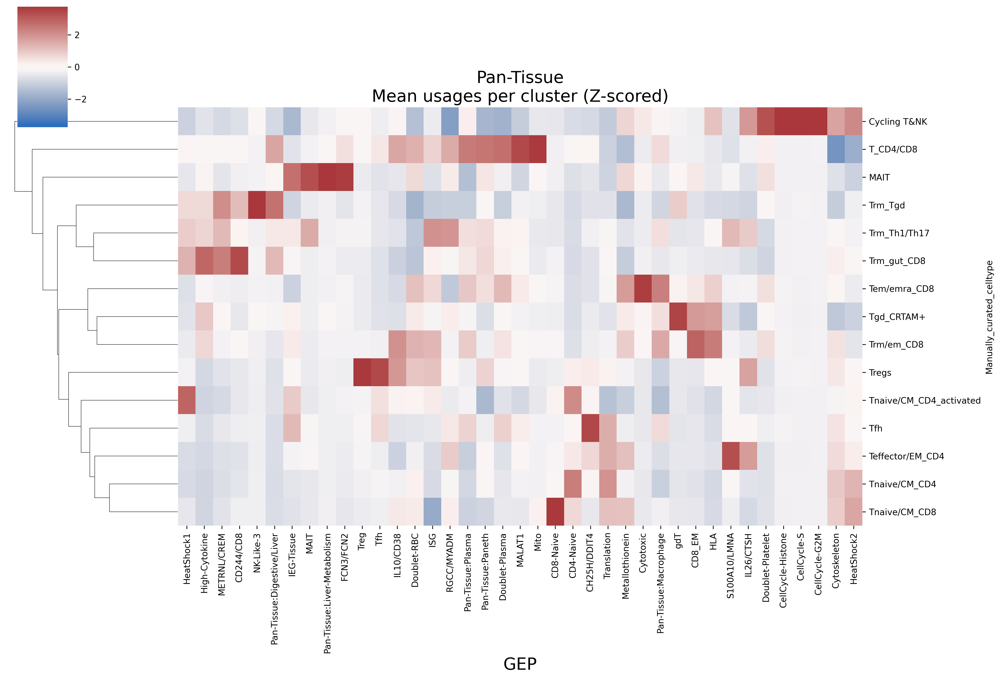

In [42]:
for dataset in params.index:
    print(dataset)
    
    usage = pd.read_csv(params.loc[dataset, 'usage_fn'], index_col = 0, sep = '\t')
    meta = pd.read_csv(params.loc[dataset, 'metadata_fn'], index_col = 0, sep = '\t')
    cluster_col = params.loc[dataset, 'cluster_col']
    usage_norm = usage.div(usage.sum(axis=1), axis=0)

    usage_test = usage_norm
    meta_test = meta

    avg_usage = usage_test.groupby(meta_test[cluster_col]).mean()

    with rc_context({'figure.figsize': (5, 2), 'figure.dpi':300, 'font.size' : 9.25}):
        g = sns.clustermap(avg_usage, figsize = (15, 10))
        # g.ax_row_dendrogram.set_visible(False) #suppress row dendrogram
        g.ax_col_dendrogram.set_visible(False) #suppress column dendrogram
        ax = g.ax_heatmap
        # ax.yaxis.set_label_position('left')
        # ax.set_ylabel('Cells with CellCycle Usage > 0.1')
        ax.set_xlabel('GEP', fontsize = 18)
        ax.set_xlabel('GEP', fontsize = 18)
        ax.set_title(dataset + '\nMean usages per cluster', fontsize = 18)

    scaler = StandardScaler()
    scaled = pd.DataFrame(scaler.fit_transform(avg_usage), 
                          index = avg_usage.index, columns = avg_usage.columns)
    vmax = abs(scaled).max().max()

    with rc_context({'figure.figsize': (5, 2), 'figure.dpi':300, 'font.size' : 9.25}):
        g = sns.clustermap(scaled, figsize = (15, 10), cmap = 'vlag', vmax = vmax, vmin = -vmax)
        # g.ax_row_dendrogram.set_visible(False) #suppress row dendrogram
        g.ax_col_dendrogram.set_visible(False) #suppress column dendrogram
        ax = g.ax_heatmap
        # ax.yaxis.set_label_position('left')
        # ax.set_ylabel('Cells with CellCycle Usage > 0.1')
        ax.set_xlabel('GEP', fontsize = 18)
        ax.set_xlabel('GEP', fontsize = 18)
        ax.set_title(dataset + '\nMean usages per cluster (Z-scored)', fontsize = 18)

# Compare cNMF usages to old cNMF usages 

In [14]:
params_old = read_dataset_log('Current Dataset Paths')
params_old.index = params_old['dataset']
params_old = params_old[params_old['dataset_type']=='discovery']
params_old

,dataset,usage_fn,gene_scores_fn,gene_tpm_fn,tcat_fn,manual_gating_fn,metadata_fn,Processing notebook path,cNMF notebook path,cluster_col,sample_col,individual_col,name,cnmf_dir,k,dt,processed_forcnmf_fn,raw_counts_fn,dataset_type,tissue_type
dataset,,,,,,,,,,,,,,,,,,,,
AMP-RA,AMP-RA,/data/srlab1/mcurtis/GSK/tcell_proliferation/A...,/data/srlab1/mcurtis/GSK/tcell_proliferation/A...,/data/srlab1/mcurtis/GSK/tcell_proliferation/A...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage_2023070...,NaN,/data/srlab1/mcurtis/GSK/tcell_proliferation/A...,/data/srlab1/mcurtis/GSK/tcell_proliferation/n...,/data/srlab1/mcurtis/GSK/tcell_proliferation/n...,cluster_name,sample,donor,amp_HarmonyRNA,/data/srlab1/mcurtis/GSK/tcell_proliferation/A...,35.0,0_2,/data/srlab1/mcurtis/GSK/tcell_proliferation/A...,/data/srlab1/mcurtis/GSK/tcell_proliferation/A...,discovery,Synovium
Pan-Cancer,Pan-Cancer,/data/srlab1/mcurtis/GSK/tcell_proliferation/z...,/data/srlab1/mcurtis/GSK/tcell_proliferation/z...,/data/srlab1/mcurtis/GSK/tcell_proliferation/z...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage_2023070...,NaN,/data/srlab1/mcurtis/GSK/tcell_proliferation/z...,/data/srlab1/mcurtis/GSK/tcell_proliferation/n...,/data/srlab1/mcurtis/GSK/tcell_proliferation/n...,meta.cluster,sampleID,patient.uid,PanCancer_HarmonyRNA.20kgenes10X,/data/srlab1/mcurtis/GSK/tcell_proliferation/z...,38.0,0_15,/data/srlab1/mcurtis/GSK/tcell_proliferation/z...,/data/srlab1/mcurtis/GSK/tcell_proliferation/z...,discovery,Pan-Tissue
TBRU,TBRU,/data/srlab1/mcurtis/GSK/tcell_proliferation/T...,/data/srlab1/mcurtis/GSK/tcell_proliferation/T...,/data/srlab1/mcurtis/GSK/tcell_proliferation/T...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage_2023070...,NaN,/data/srlab1/mcurtis/GSK/tcell_proliferation/T...,/data/srlab1/mcurtis/GSK/tcell_proliferation/n...,/data/srlab1/mcurtis/GSK/tcell_proliferation/n...,cluster_name,donor,donor,TBRU_HarmonyRNA,/data/srlab1/mcurtis/GSK/tcell_proliferation/T...,35.0,0_2,/data/srlab1/mcurtis/GSK/tcell_proliferation/T...,/data/srlab1/mcurtis/GSK/tcell_proliferation/T...,discovery,Blood
HIV-Vaccine,HIV-Vaccine,/data/srlab1/dk718/Tcell_cNMF_Comparison/Data/...,/data/srlab1/dk718/Tcell_cNMF_Comparison/Data/...,/data/srlab1/dk718/Tcell_cNMF_Comparison/Data/...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage_2023070...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/Manu...,/data/srlab1/dk718/Tcell_cNMF_Comparison/Data/...,/data/srlab1/dk718/Tcell_cNMF_Comparison/Analy...,/data/srlab1/dk718/Tcell_cNMF_Comparison/Analy...,celltype.l2,orig.ident,donor,T_learnHarmonyRNA_RefitBoth_20221022,/data/srlab1/dk718/Tcell_cNMF_Comparison/Data/...,35.0,0_2,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,discovery,Blood
UK-Covid,UK-Covid,/data/srlab1/mcurtis/GSK/tcell_proliferation/C...,/data/srlab1/mcurtis/GSK/tcell_proliferation/C...,/data/srlab1/mcurtis/GSK/tcell_proliferation/C...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage_2023070...,NaN,/data/srlab1/dk718/COVID_PBMC/Data/Haniffa/han...,/data/srlab1/dk718/Tcell_cNMF_Comparison/Analy...,/data/srlab1/dk718/Tcell_cNMF_Comparison/Analy...,full_clustering,sample_id,patient_id,Haniffa_T_Script_learnHarmonyRNA_RefitBoth,/data/srlab1/mcurtis/GSK/tcell_proliferation/C...,40.0,0_2,/data/srlab1/dk718/COVID_PBMC/Data/Haniffa/han...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/hani...,discovery,Blood
COMBAT,COMBAT,/data/srlab1/mcurtis/GSK/tcell_proliferation/C...,/data/srlab1/mcurtis/GSK/tcell_proliferation/C...,/data/srlab1/mcurtis/GSK/tcell_proliferation/C...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage_2023070...,/data/srlab1/TCAT/Data/PerDataset/COMBAT/Manua...,/data/srlab1/dk718/Tcell_cNMF_Comparison/Data/...,/data/srlab1/dk718/Tcell_cNMF_Comparison/Analy...,/data/srlab1/dk718/Tcell_cNMF_Comparison/Analy...,Annotation_minor_subset,COMBAT_participant_timepoint_ID,COMBAT_ID,T_Script_learnHarmonyRNA_RefitBoth,/data/srlab1/mcurtis/GSK/tcell_proliferation/C...,44.0,0_2,/data/srlab1/dk718/Tcell_cNMF_Comparison/Data/...,/data/srlab1/TCAT/Data

In [295]:
gep_corrs_all = {}

In [10]:
usage_dict = {}
usage_norm_dict = {}
meta_dict = {} 

In [12]:
for dataset in params.index:
    print(dataset)
    
    usage_dict[dataset] = pd.read_csv(params.loc[dataset, 'usage_fn'], index_col = 0, sep = '\t')
    usage_norm_dict[dataset] = usage_dict[dataset].div(usage_dict[dataset].sum(axis=1), axis=0)
    meta_dict[dataset] = pd.read_csv(params.loc[dataset, 'metadata_fn'], index_col = 0, sep = '\t')

AMP-RA
Pan-Cancer
TBRU
HIV-Vaccine
UK-Covid


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3524: DtypeWarning: Columns (18,20,21) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


COMBAT
Pan-Tissue


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3524: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [16]:
usage_dict_old = {}
usage_norm_dict_old = {}
meta_dict_old = {} 

In [17]:
for dataset in params_old.index:
    print(dataset)
    usage_dict_old[dataset] = pd.read_csv(params_old.loc[dataset, 'usage_fn'], index_col = 0, sep = '\t')
    usage_norm_dict_old[dataset] = usage_dict_old[dataset].div(usage_dict_old[dataset].sum(axis=1), axis=0)
    meta_dict_old[dataset] = pd.read_csv(params_old.loc[dataset, 'metadata_fn'], index_col = 0, sep = '\t')

/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3524: DtypeWarning: Columns (18,20,21) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3524: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [20]:
meta_dict_old.keys()

dict_keys(['AMP-RA', 'Pan-Cancer', 'TBRU', 'HIV-Vaccine', 'UK-Covid', 'COMBAT', 'Pan-Tissue'])

In [21]:
dataset = 'AMP-RA'

In [298]:
if dataset not in gep_corrs_all.keys():
    print('test')
else:
    gep_corrs = gep_corrs_all[dataset]

In [297]:
gep_corrs_all

{'AMP-RA':                                       Ribo  PoorQuality  CD8_class2_HLA  \
 Translation                       0.952267    -0.062104       -0.195467   
 MALAT1                            0.002054     0.989657        0.088299   
 CD8_EM                           -0.269476     0.068393        0.971237   
 IEG                               0.062774    -0.290255       -0.067793   
 YPEL5/CREM                        0.078786    -0.340755       -0.112726   
 CD4-Naive                         0.335350    -0.031428       -0.326378   
 IEG-Tissue                        0.052703    -0.235465       -0.005653   
 Tfh                               0.042369     0.022297       -0.270676   
 Cytoskeleton                      0.121175    -0.038005        0.122830   
 Cytotoxic                        -0.097780    -0.021353        0.262131   
 AMP-RA:Doublet_Fibroblast_Single  0.017618    -0.000479        0.019946   
 Th17                              0.506778     0.120355       -0.382694   
 S

AMP-RA


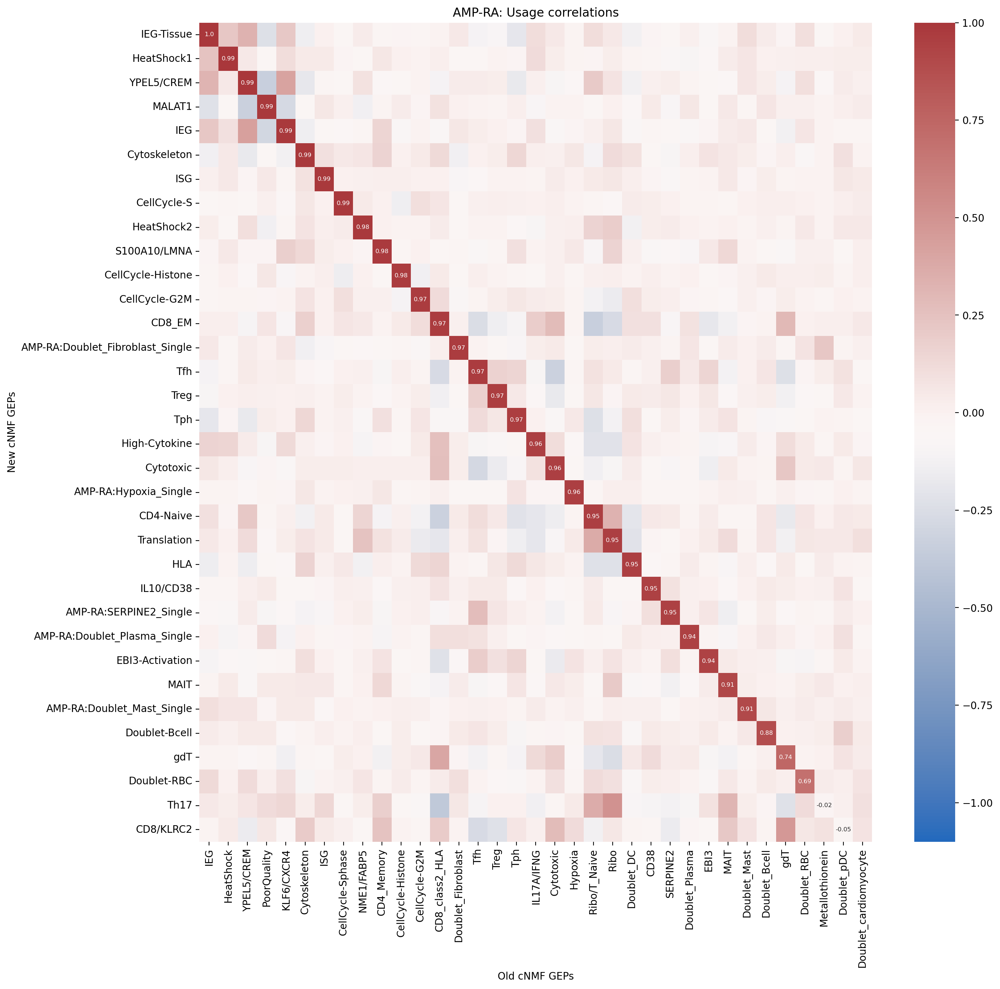

Pan-Cancer


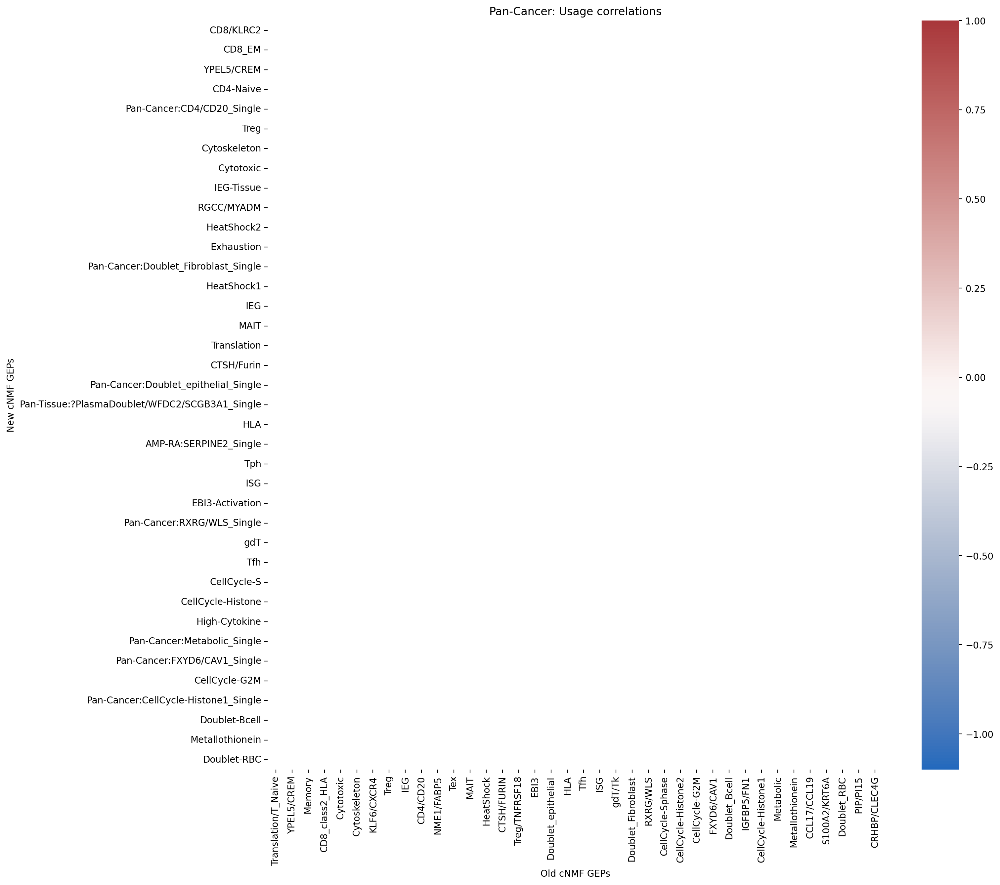

TBRU


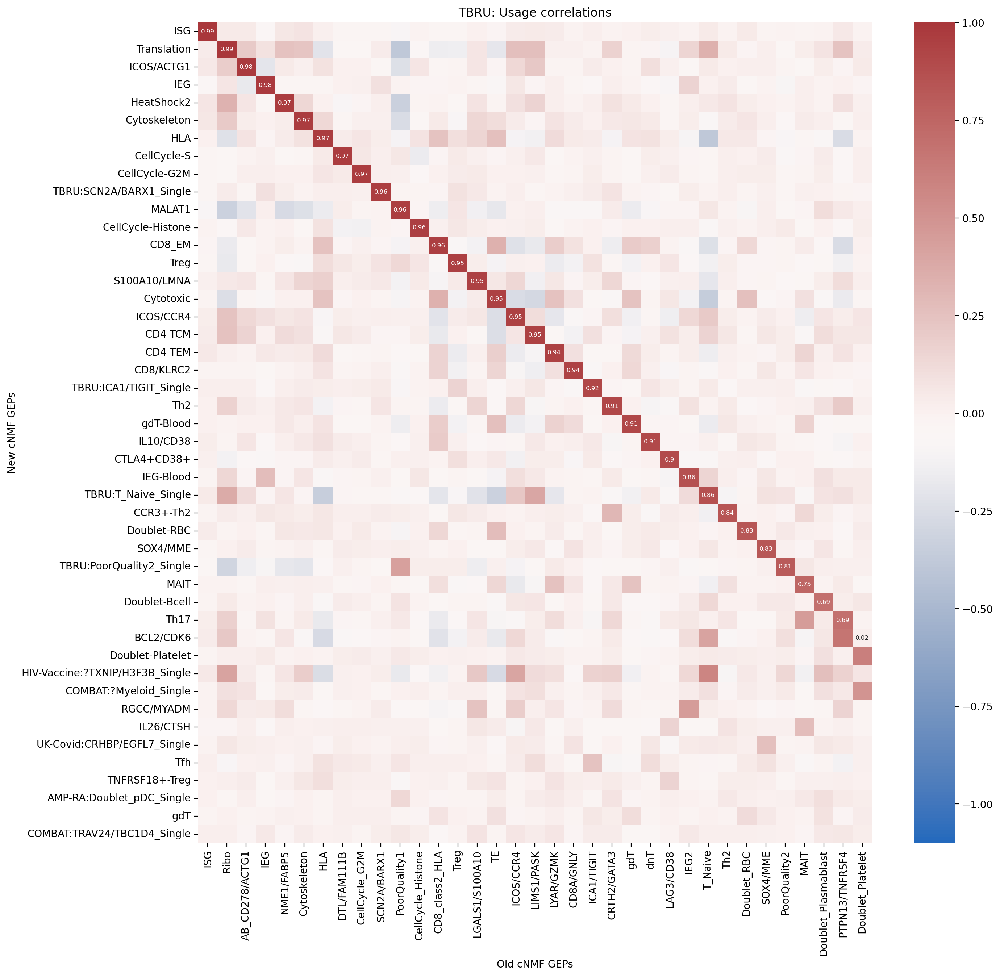

HIV-Vaccine


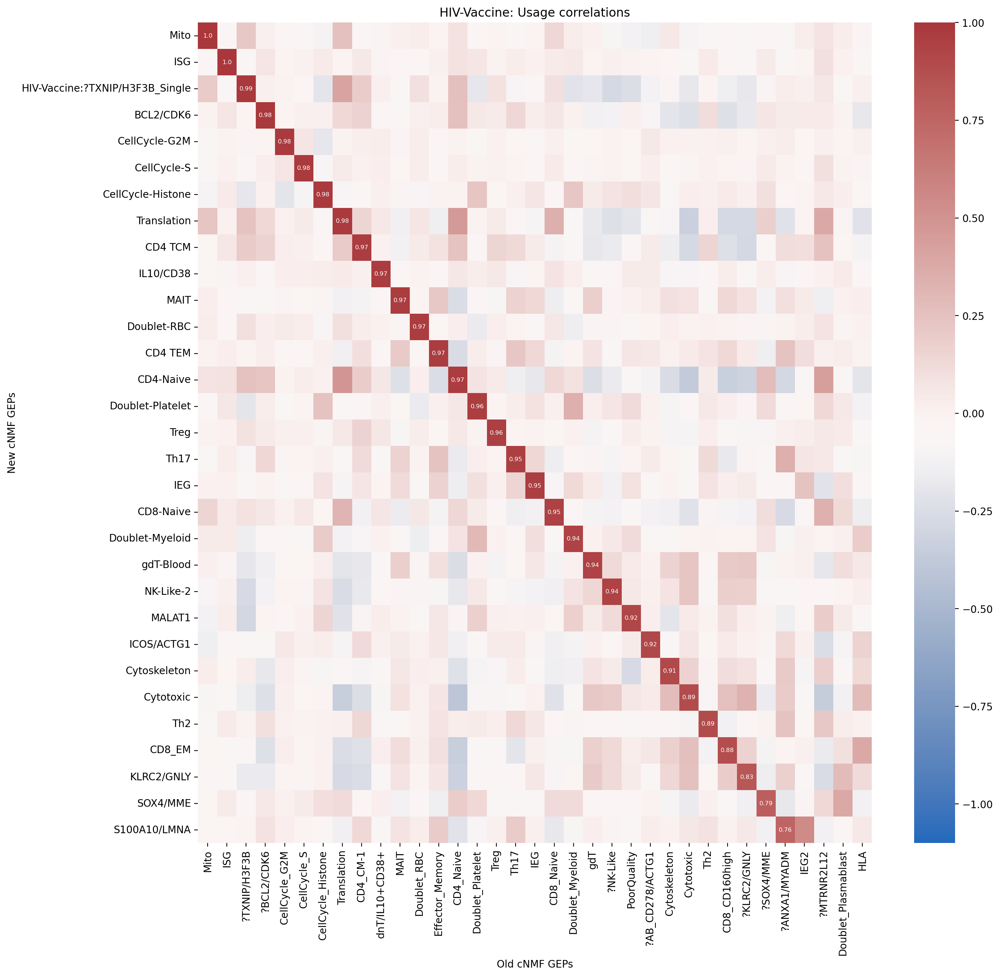

UK-Covid


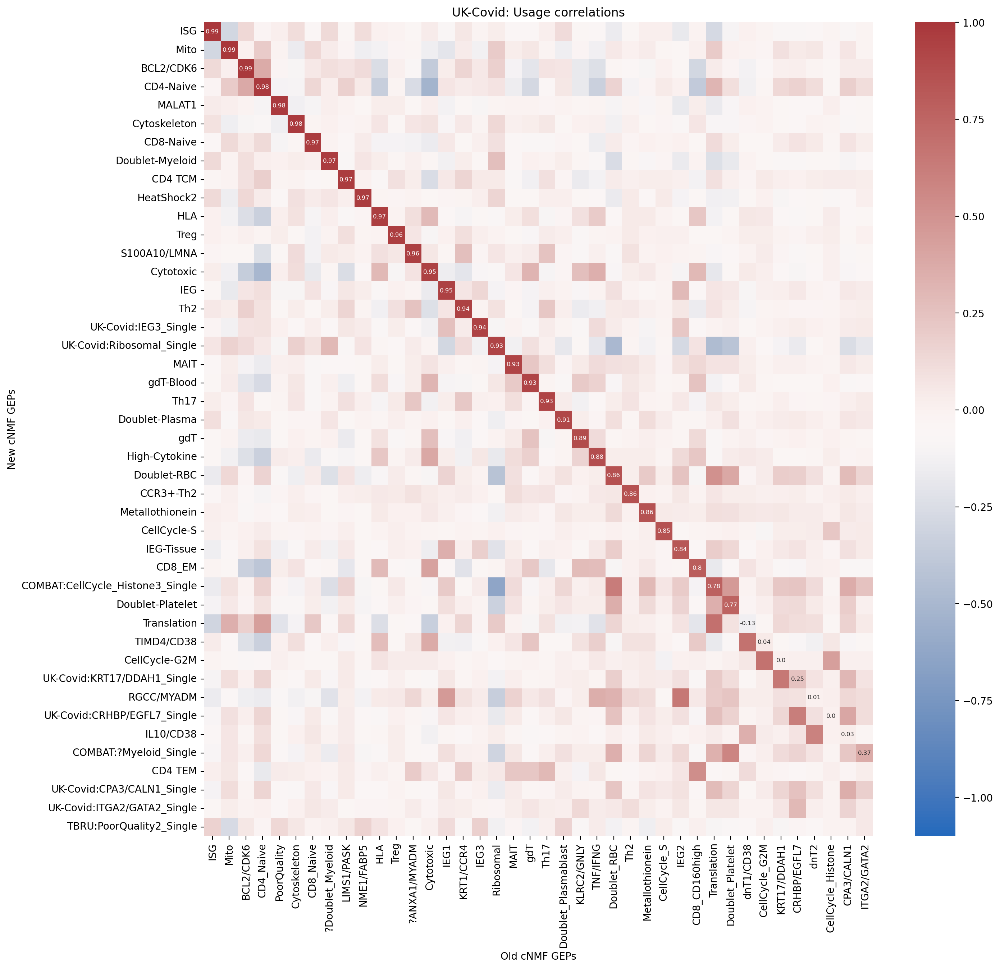

COMBAT


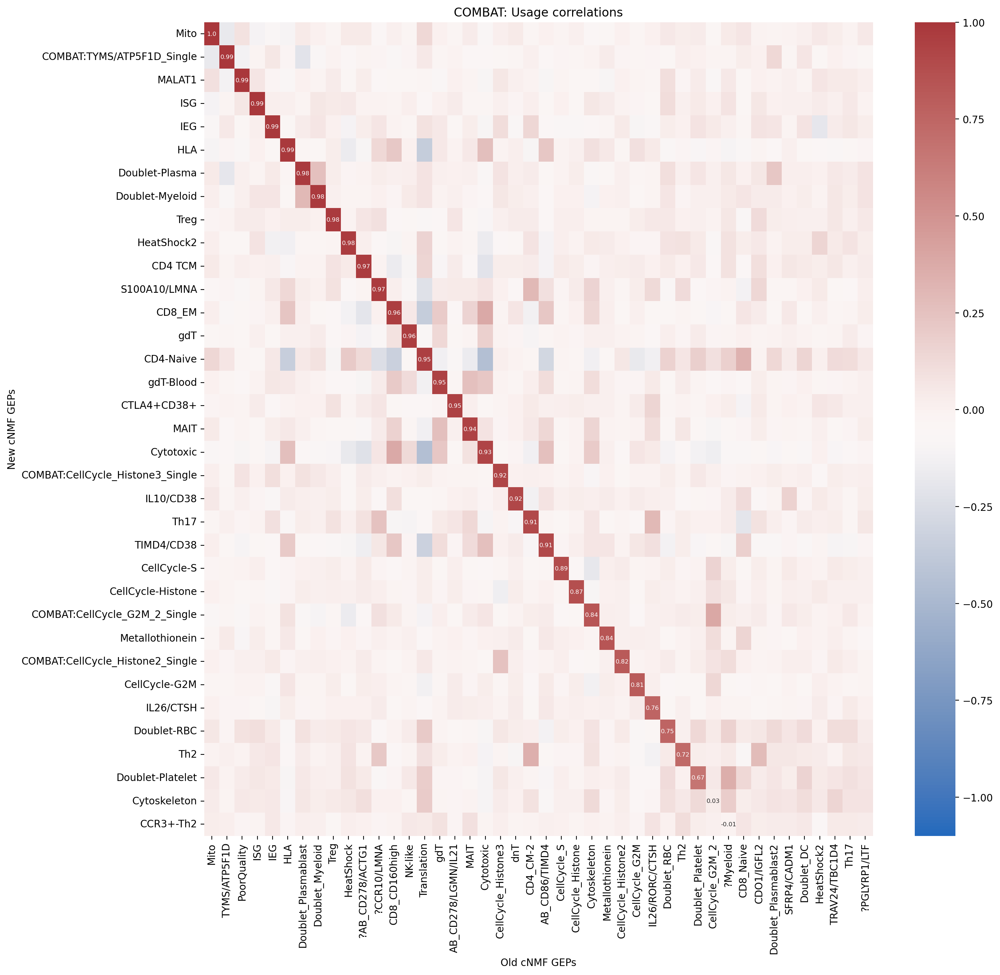

Pan-Tissue


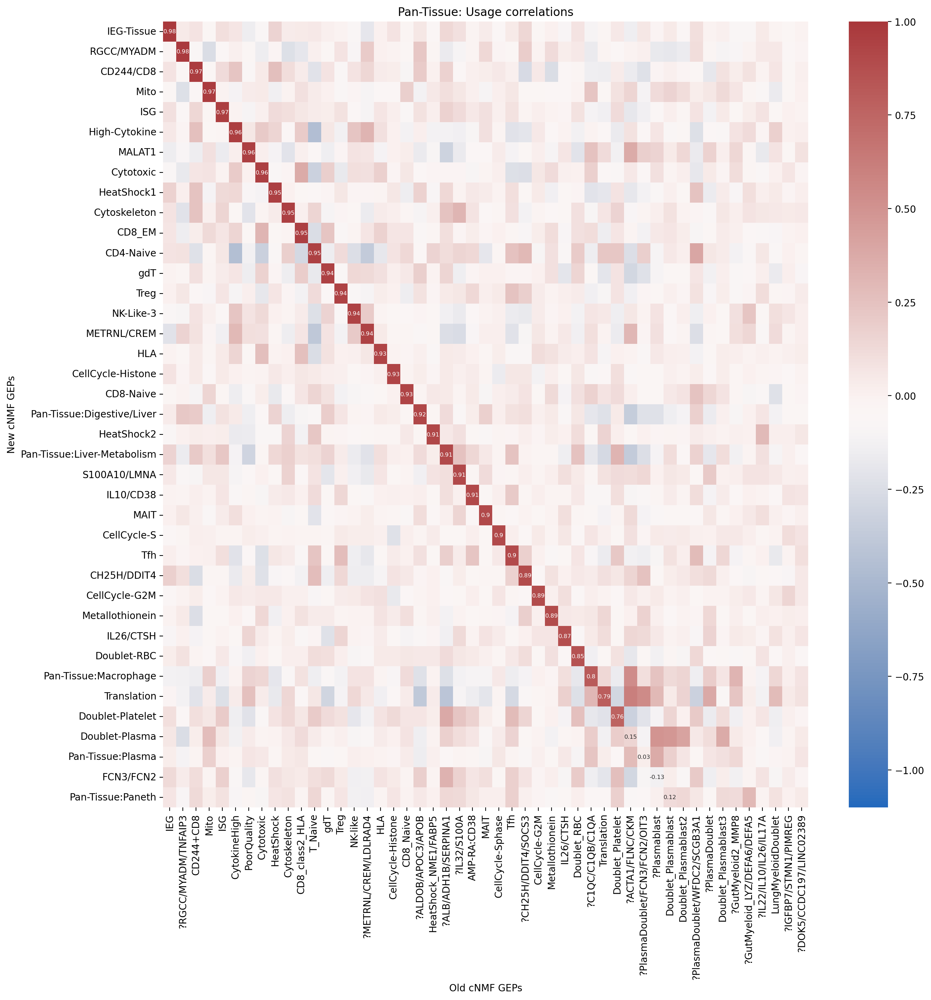

In [321]:
for dataset in params.index:
    print(dataset)
    ind = set(usage_norm_dict[dataset].index).intersection(usage_norm_dict_old[dataset].index)

    # Calculate within dataset pairwise GEP corrs between new/old GEPs
    if dataset not in gep_corrs_all.keys():
        gep_corrs = pd.DataFrame(0, index = usage_norm_dict[dataset].columns,
                                 columns = usage_norm_dict_old[dataset].columns)
        for k in usage_norm_dict[dataset].columns:
            for j in usage_norm_dict_old[dataset].columns:
                r, _ = spearmanr(usage_norm_dict[dataset].loc[ind, k], usage_norm_dict_old[dataset].loc[ind, j])
                gep_corrs.loc[k, j] = r

        gep_corrs_all[dataset] = gep_corrs
    else:
        gep_corrs = gep_corrs_all[dataset]

    pairwise_corrs = gep_corrs.unstack().sort_values(ascending = False)

    yorder = [x for x, y in pairwise_corrs.index]
    yorder = pd.Series(yorder).drop_duplicates().values

    xorder = [y for x, y in pairwise_corrs.index]
    xorder = pd.Series(xorder).drop_duplicates().values

    # labels = np.full([len(xorder), len(yorder)], '')
    labels = np.empty([len(xorder), len(yorder)], dtype=np.dtype('U100'))
    # indices = np.diag_indices(gep_corrs.loc[xorder, yorder].shape[0])

    # i = 0
    diagonal = np.round(np.diag(gep_corrs.loc[xorder, yorder].values), 2).astype('str')
    for n in range(0, len(diagonal)):
        labels[n, n] = diagonal[n]
        i+=1

    labels = pd.DataFrame(labels, index = xorder, columns = yorder)
    
    
    fig, ax = plt.subplots(dpi = 200, figsize = (15, 15))
    sns.heatmap(gep_corrs.loc[xorder, yorder], ax = ax, vmin = 1, vmax = -1, cmap = 'vlag', 
                annot = labels, fmt = '', annot_kws={"fontsize":6})
    ax.set_xlabel('Old cNMF GEPs')
    ax.set_ylabel('New cNMF GEPs')
    ax.set_title(dataset +': Usage correlations')
    plt.show()

AMP-RA


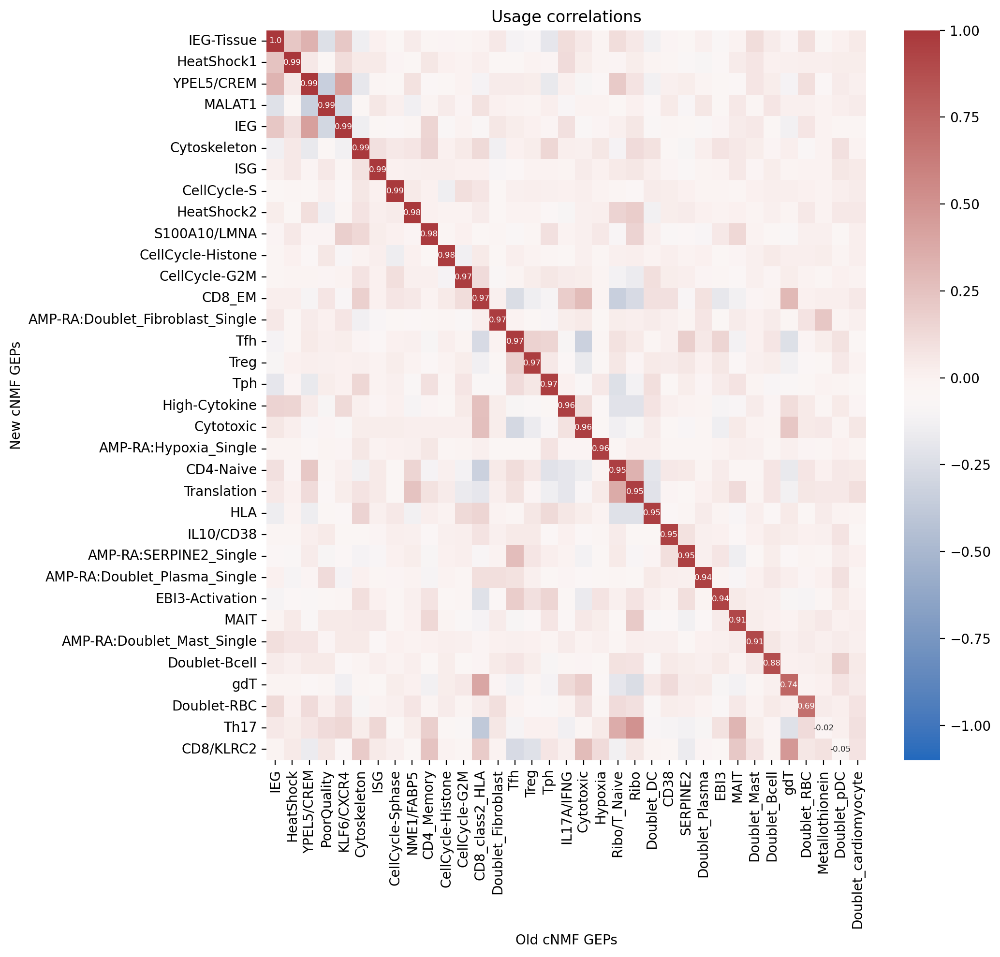

Pan-Cancer


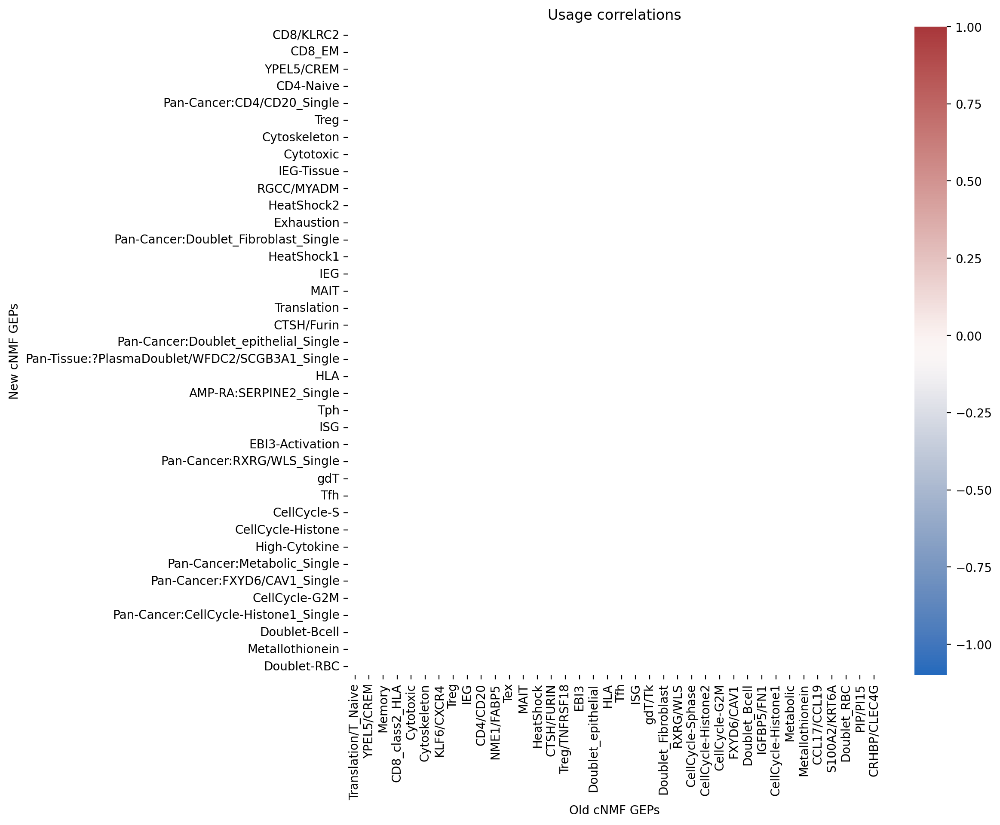

TBRU


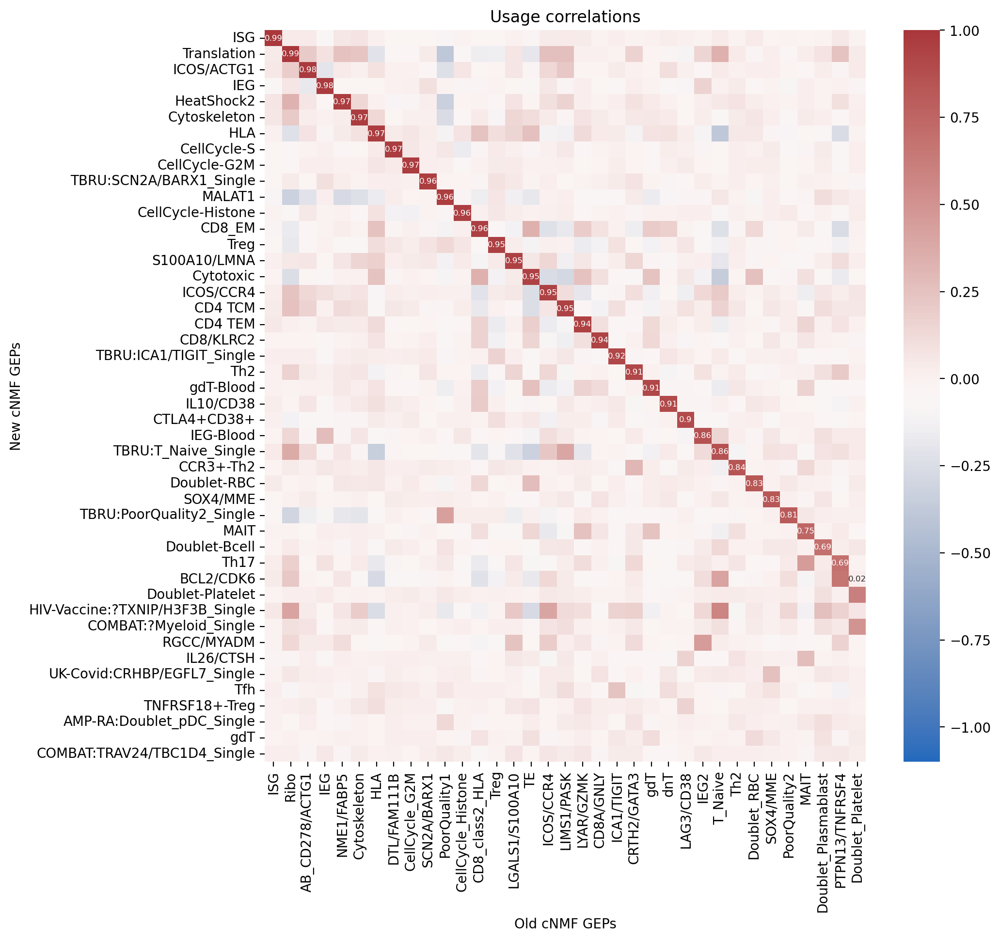

HIV-Vaccine


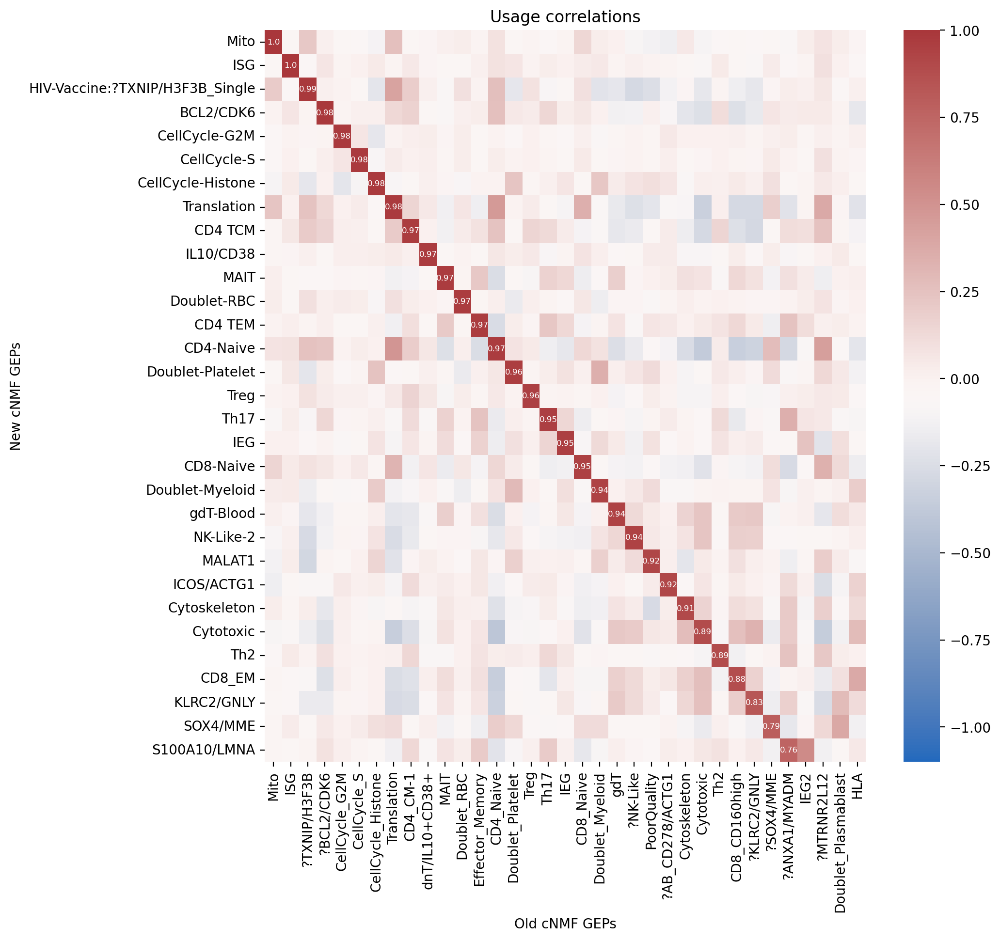

UK-Covid


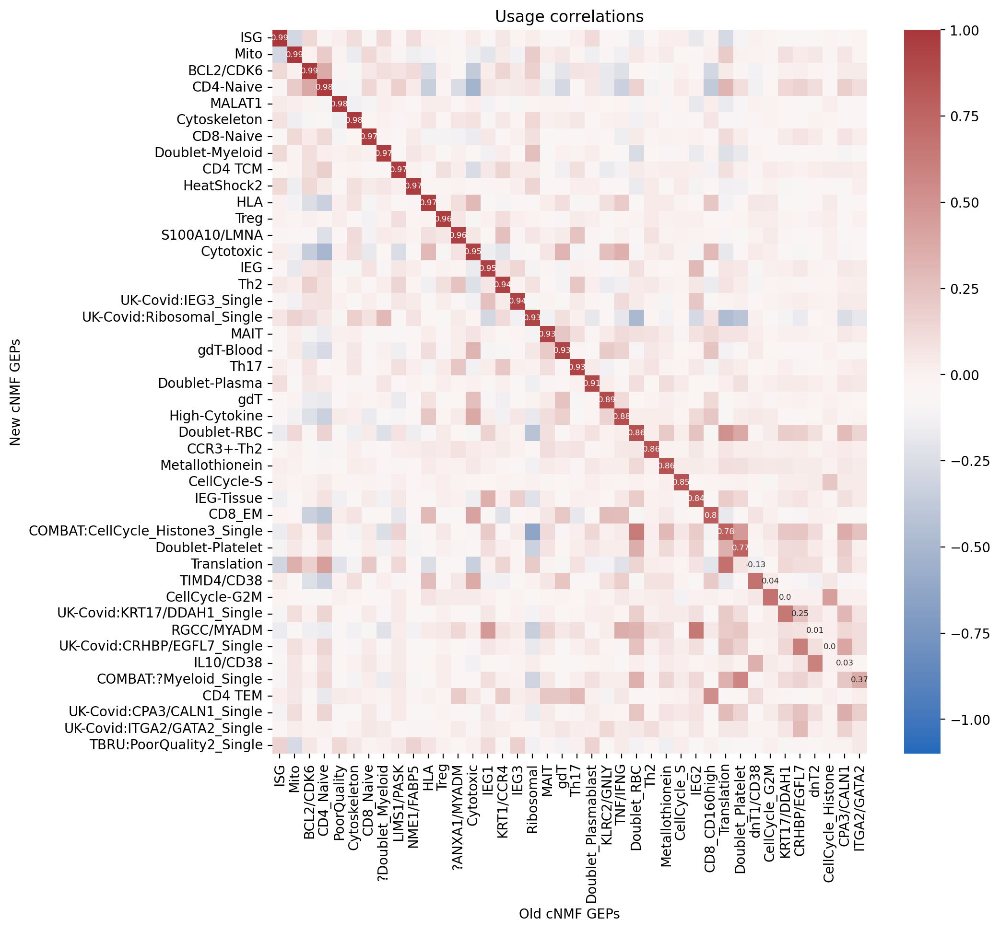

COMBAT


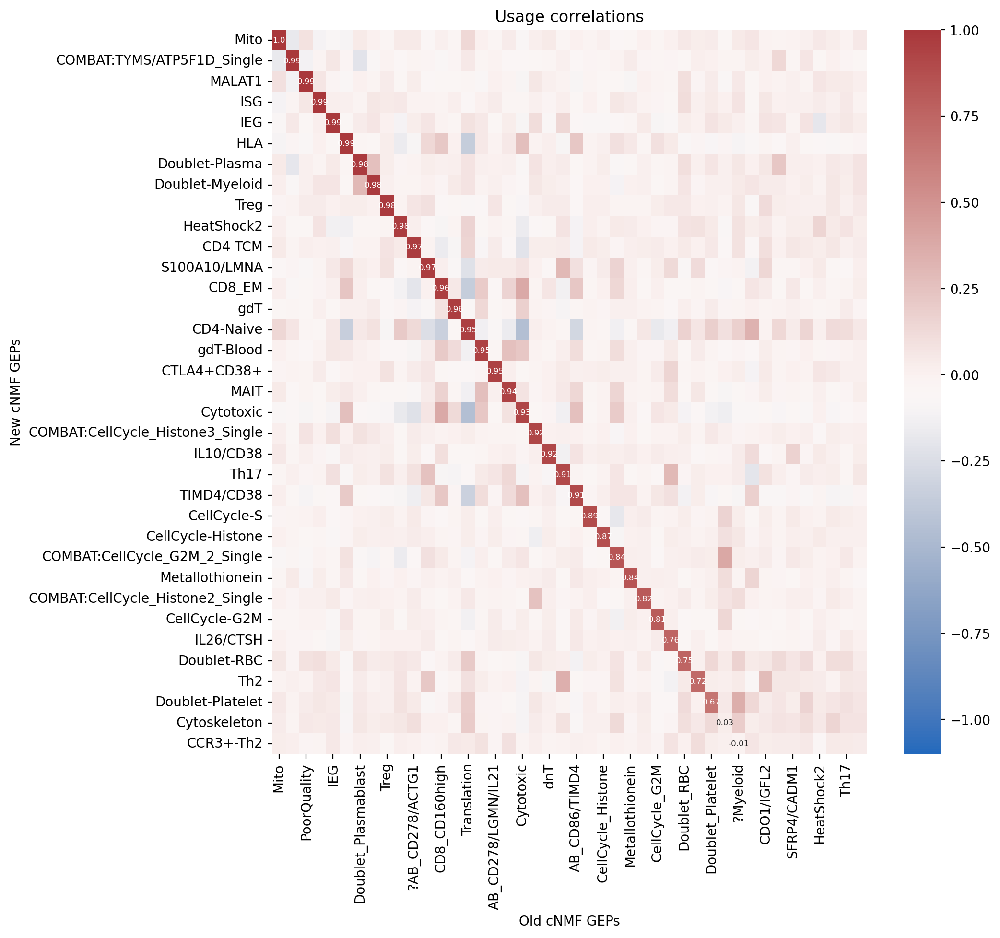

Pan-Tissue


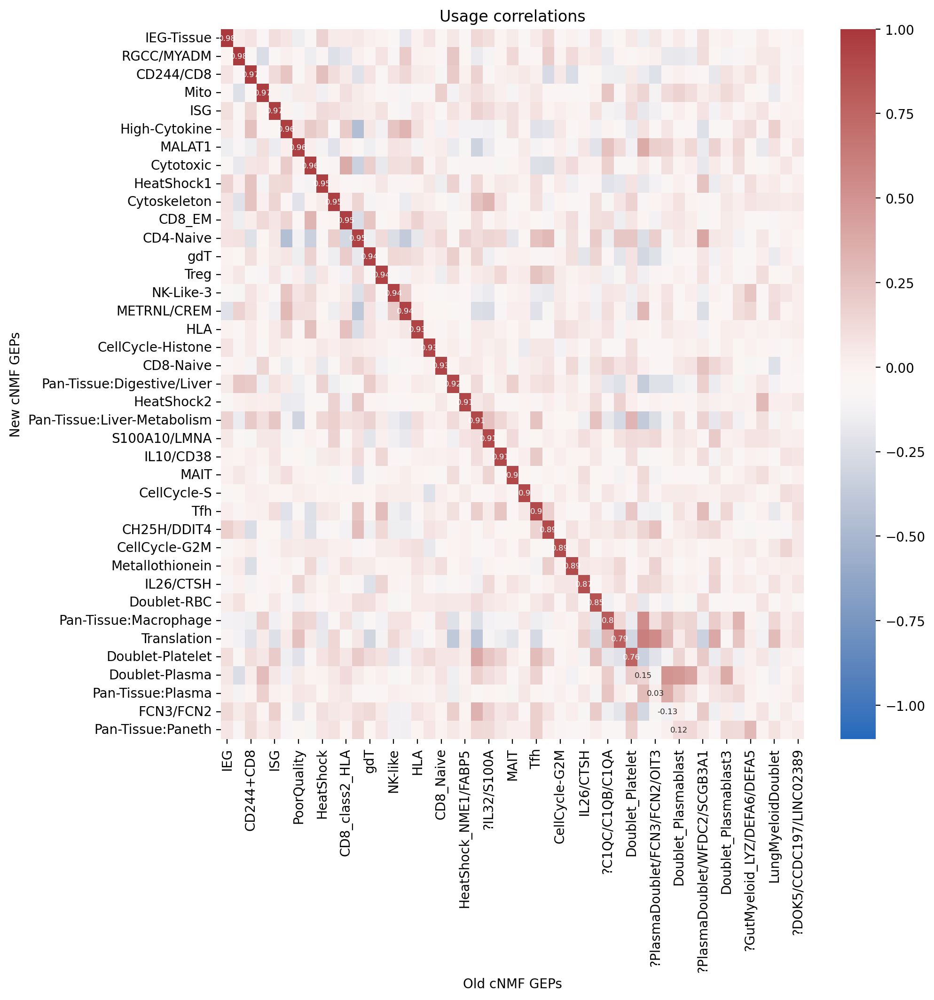

In [319]:
for dataset in params.index:
    print(dataset)
    ind = set(usage_norm_dict[dataset].index).intersection(usage_norm_dict_old[dataset].index)

    # Calculate within dataset pairwise GEP corrs between new/old GEPs
    if dataset not in gep_corrs_all.keys():
        gep_corrs = pd.DataFrame(0, index = usage_norm_dict[dataset].columns,
                                 columns = usage_norm_dict_old[dataset].columns)
        for k in usage_norm_dict[dataset].columns:
            for j in usage_norm_dict_old[dataset].columns:
                r, _ = spearmanr(usage_norm_dict[dataset].loc[ind, k], usage_norm_dict_old[dataset].loc[ind, j])
                gep_corrs.loc[k, j] = r

        gep_corrs_all[dataset] = gep_corrs
    else:
        gep_corrs = gep_corrs_all[dataset]

    pairwise_corrs = gep_corrs.unstack().sort_values(ascending = False)

    yorder = [x for x, y in pairwise_corrs.index]
    yorder = pd.Series(yorder).drop_duplicates().values

    xorder = [y for x, y in pairwise_corrs.index]
    xorder = pd.Series(xorder).drop_duplicates().values

    # labels = np.full([len(xorder), len(yorder)], '')
    labels = np.empty([len(xorder), len(yorder)], dtype=np.dtype('U100'))
    # indices = np.diag_indices(gep_corrs.loc[xorder, yorder].shape[0])

    # i = 0
    diagonal = np.round(np.diag(gep_corrs.loc[xorder, yorder].values), 2).astype('str')
    for n in range(0, len(diagonal)):
        labels[n, n] = diagonal[n]
        i+=1

    labels = pd.DataFrame(labels, index = xorder, columns = yorder)
    
    
    fig, ax = plt.subplots(dpi = 200, figsize = (10, 10))
    sns.heatmap(gep_corrs.loc[xorder, yorder], ax = ax, vmin = 1, vmax = -1, cmap = 'vlag', 
                annot = labels, fmt = '', annot_kws={"fontsize":6})
    ax.set_xlabel('Old cNMF GEPs')
    ax.set_ylabel('New cNMF GEPs')
    ax.set_title('Usage correlations')
    plt.show()

In [318]:
gep_corrs_all.keys()

dict_keys(['AMP-RA', 'Pan-Cancer', 'TBRU'])

# Final TCAT cGEPs by cluster

AMP-RA
Pan-Cancer
TBRU
HIV-Vaccine
UK-Covid


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3524: DtypeWarning: Columns (18,20,21) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


COMBAT
Pan-Tissue


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3524: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


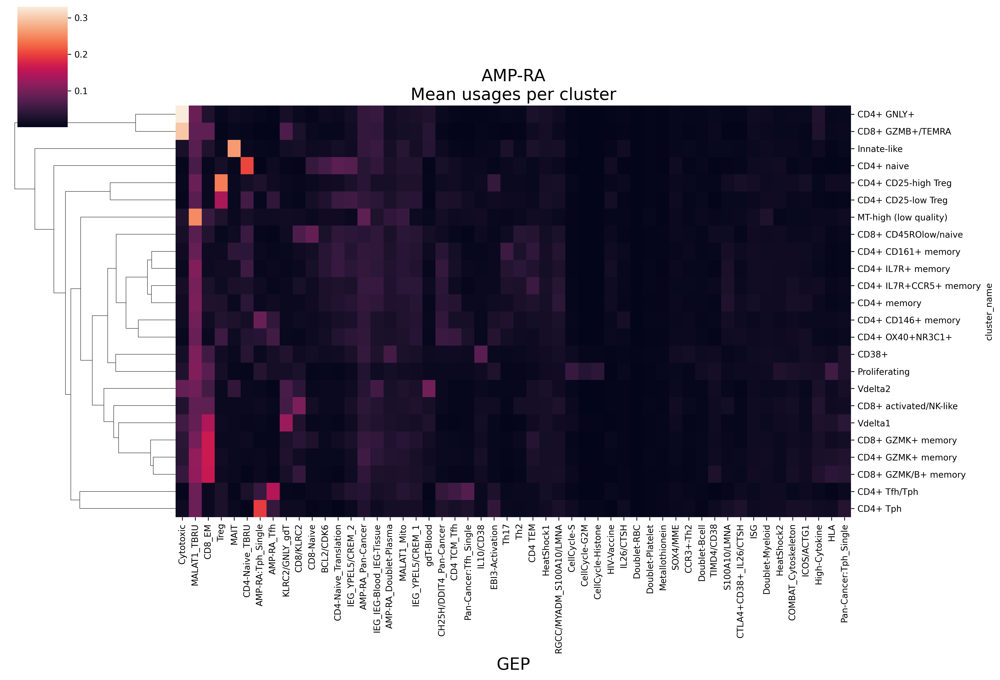

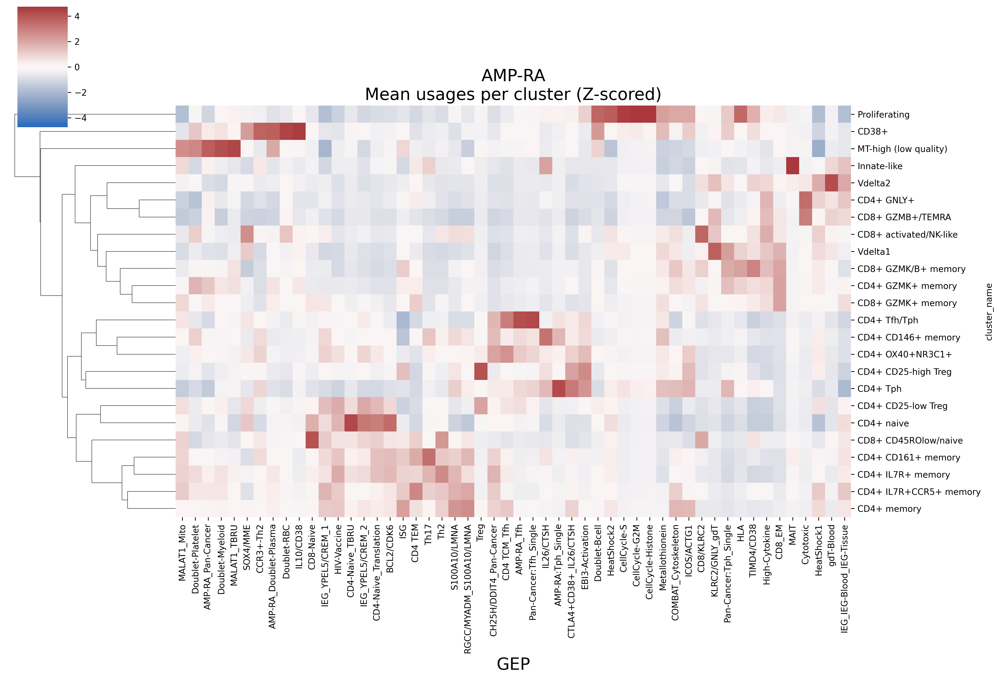

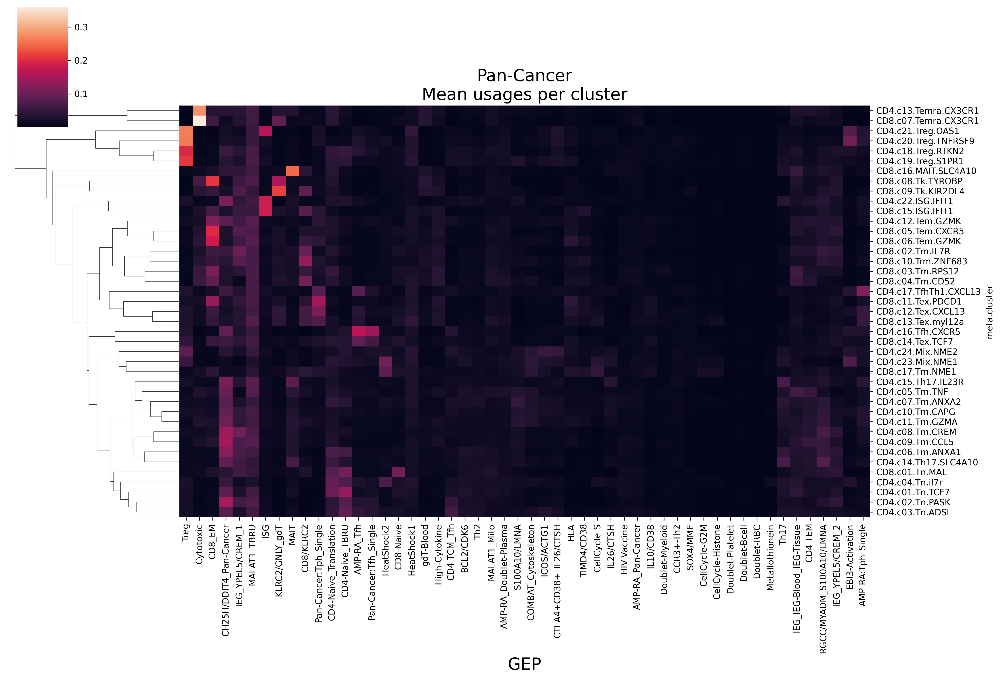

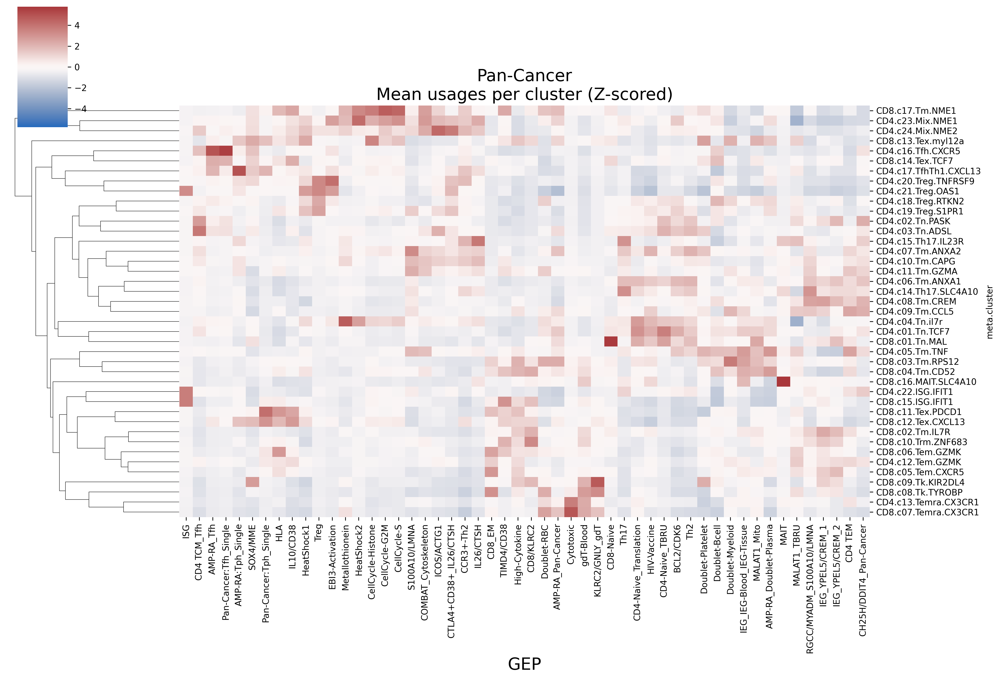

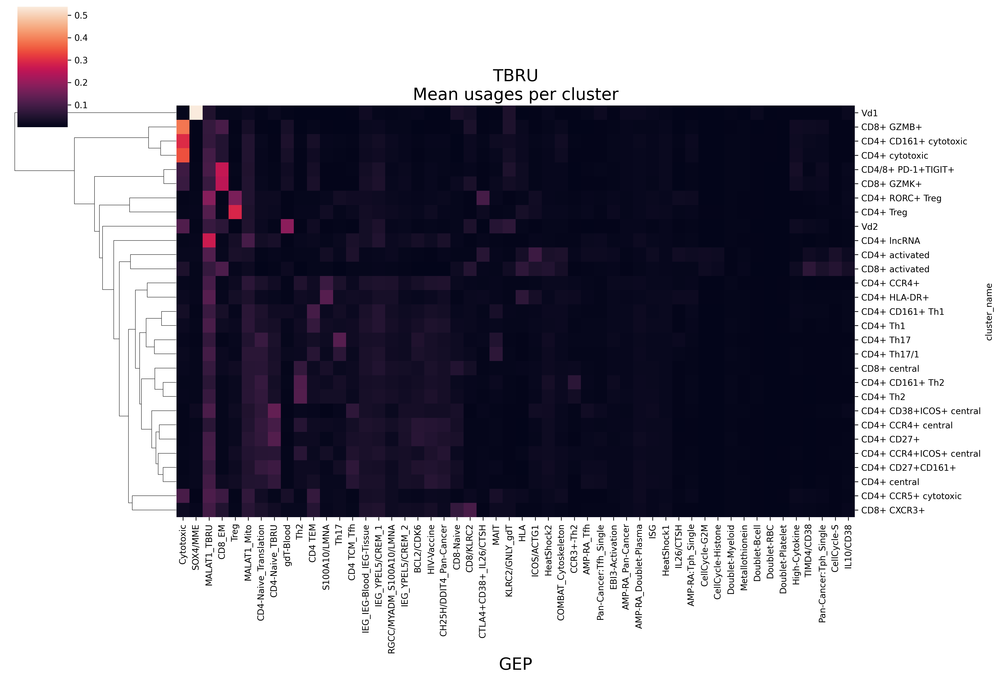

...

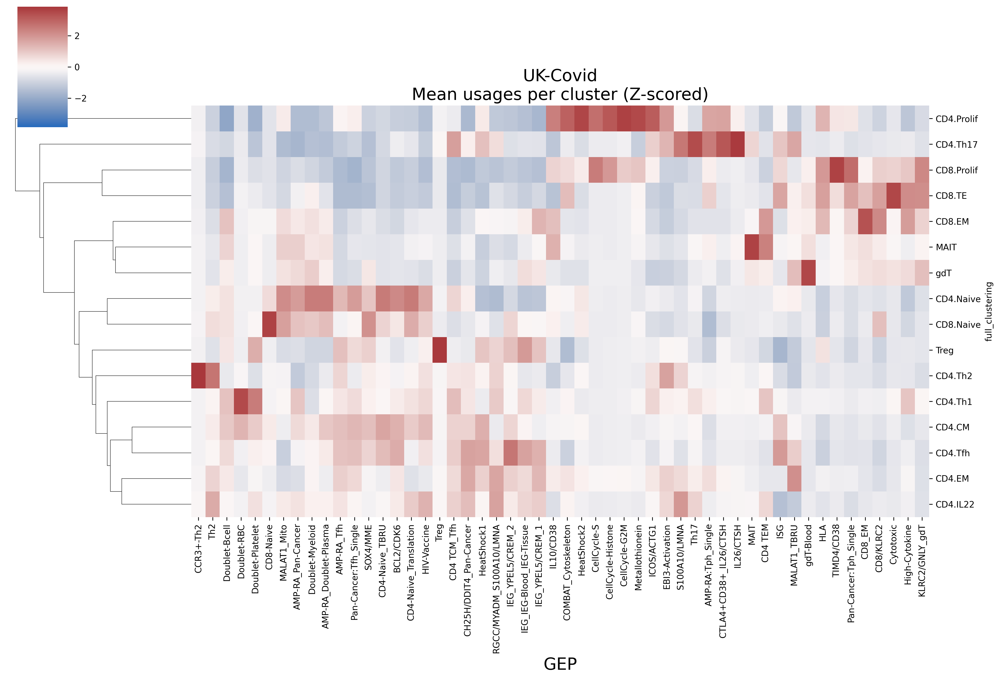

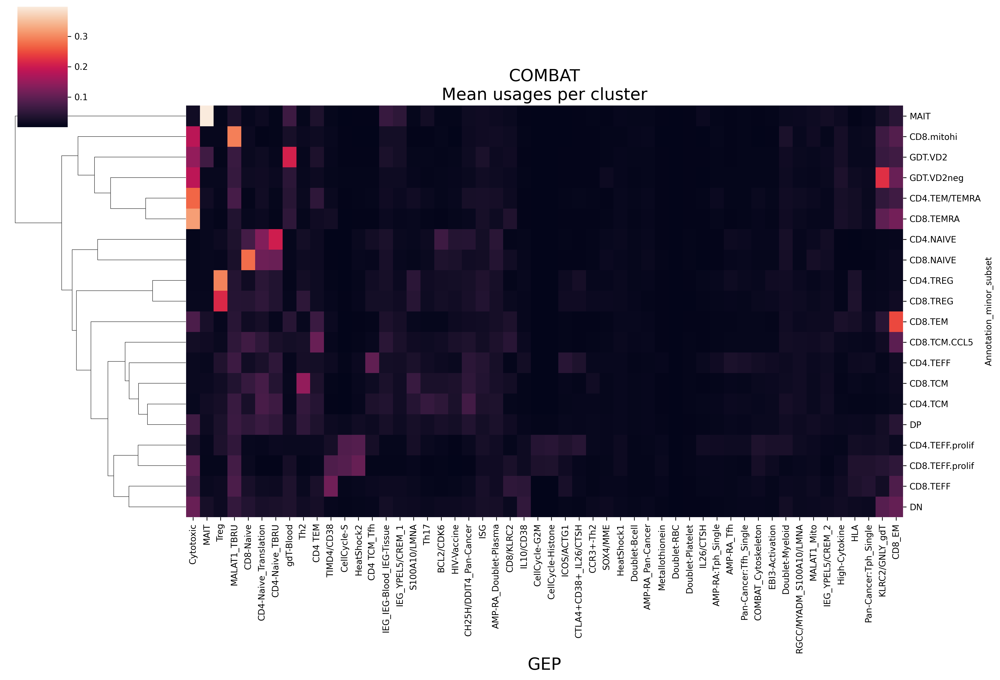

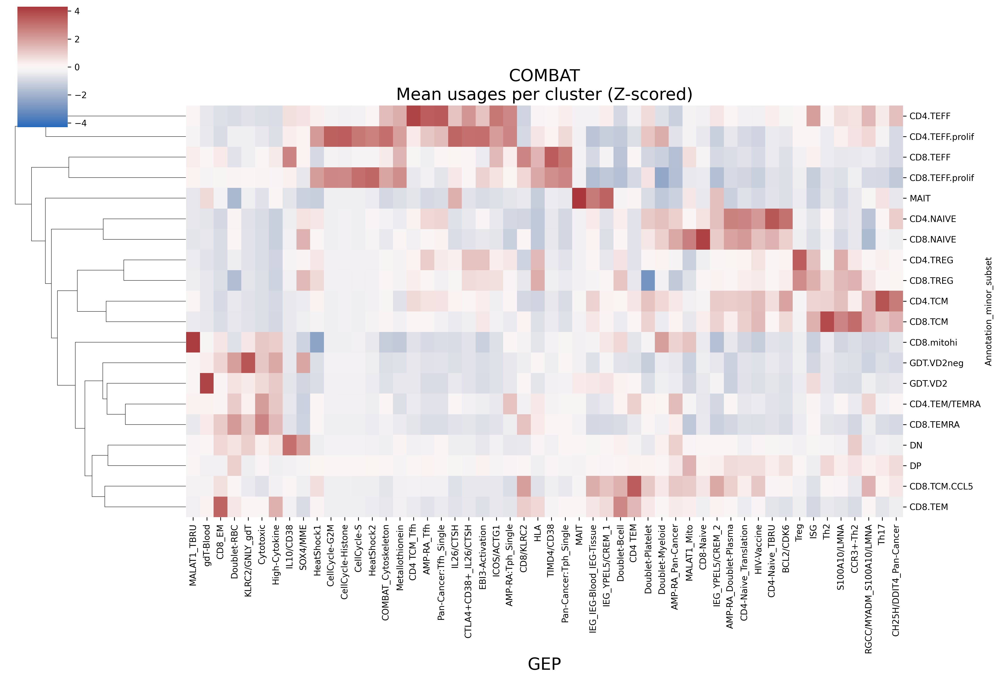

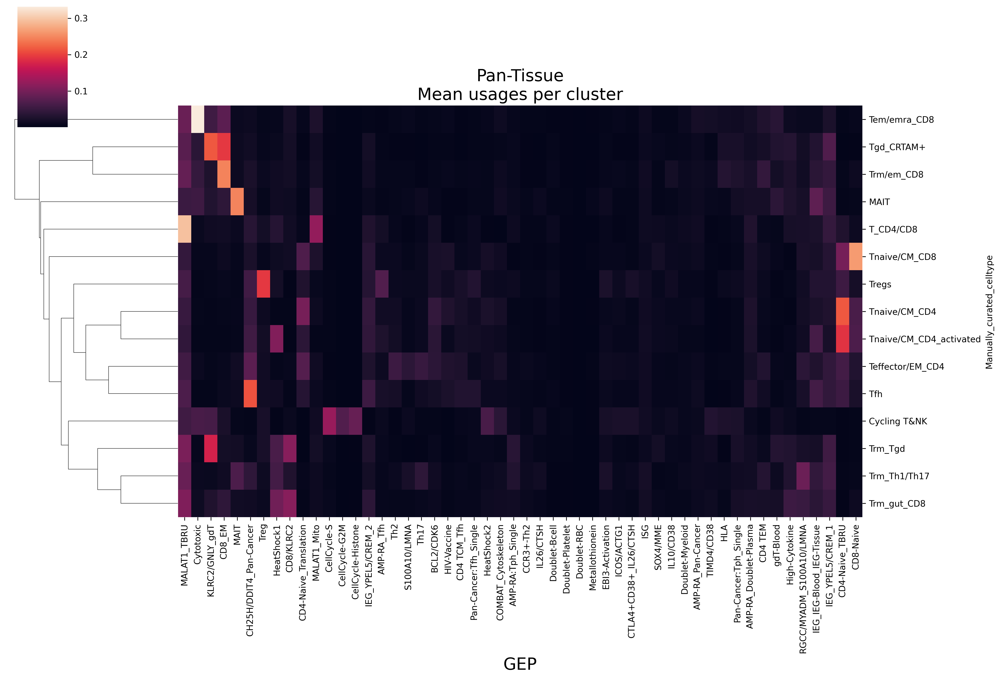

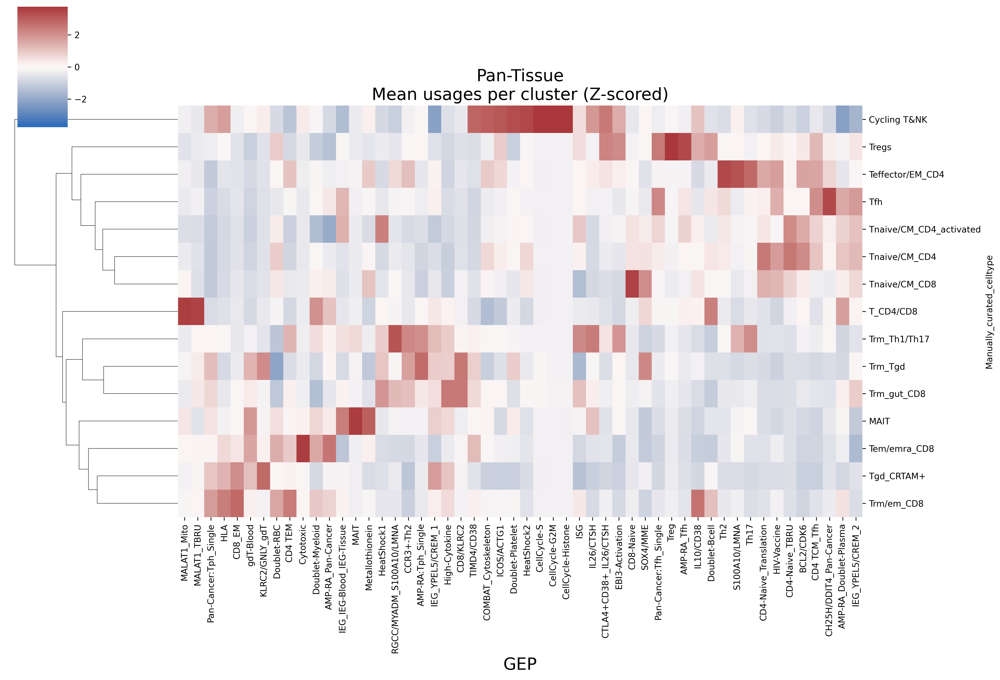

In [4]:
for dataset in params.index:
    print(dataset)
    
    usage = pd.read_csv(params.loc[dataset, 'tcat_fn'], index_col = 0, sep = '\t')
    meta = pd.read_csv(params.loc[dataset, 'metadata_fn'], index_col = 0, sep = '\t')
    cluster_col = params.loc[dataset, 'cluster_col']
    usage_norm = usage.div(usage.sum(axis=1), axis=0)

    usage_test = usage_norm
    meta_test = meta

    avg_usage = usage_test.groupby(meta_test[cluster_col]).mean()

    with rc_context({'figure.figsize': (5, 2), 'figure.dpi':300, 'font.size' : 9.25}):
        g = sns.clustermap(avg_usage, figsize = (15, 10))
        # g.ax_row_dendrogram.set_visible(False) #suppress row dendrogram
        g.ax_col_dendrogram.set_visible(False) #suppress column dendrogram
        ax = g.ax_heatmap
        # ax.yaxis.set_label_position('left')
        # ax.set_ylabel('Cells with CellCycle Usage > 0.1')
        ax.set_xlabel('GEP', fontsize = 18)
        ax.set_xlabel('GEP', fontsize = 18)
        ax.set_title(dataset + '\nMean usages per cluster', fontsize = 18)

    scaler = StandardScaler()
    scaled = pd.DataFrame(scaler.fit_transform(avg_usage), 
                          index = avg_usage.index, columns = avg_usage.columns)
    vmax = abs(scaled).max().max()

    with rc_context({'figure.figsize': (5, 2), 'figure.dpi':300, 'font.size' : 9.25}):
        g = sns.clustermap(scaled, figsize = (15, 10), cmap = 'vlag', vmax = vmax, vmin = -vmax)
        # g.ax_row_dendrogram.set_visible(False) #suppress row dendrogram
        g.ax_col_dendrogram.set_visible(False) #suppress column dendrogram
        ax = g.ax_heatmap
        # ax.yaxis.set_label_position('left')
        # ax.set_ylabel('Cells with CellCycle Usage > 0.1')
        ax.set_xlabel('GEP', fontsize = 18)
        ax.set_xlabel('GEP', fontsize = 18)
        ax.set_title(dataset + '\nMean usages per cluster (Z-scored)', fontsize = 18)